# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:30, 5.96MB/s]                              
SVHN Testing Set: 64.3MB [00:15, 4.10MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

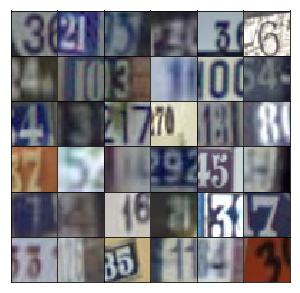

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
     with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.7542... Generator Loss: 1.3568
Epoch 1/25... Discriminator Loss: 0.4048... Generator Loss: 1.6418
Epoch 1/25... Discriminator Loss: 0.1350... Generator Loss: 2.9755
Epoch 1/25... Discriminator Loss: 0.1314... Generator Loss: 2.7425
Epoch 1/25... Discriminator Loss: 0.1954... Generator Loss: 2.6496
Epoch 1/25... Discriminator Loss: 0.1252... Generator Loss: 2.9876
Epoch 1/25... Discriminator Loss: 0.2806... Generator Loss: 2.0007
Epoch 1/25... Discriminator Loss: 0.1586... Generator Loss: 3.2278
Epoch 1/25... Discriminator Loss: 0.1451... Generator Loss: 2.9376
Epoch 1/25... Discriminator Loss: 0.2536... Generator Loss: 4.6730


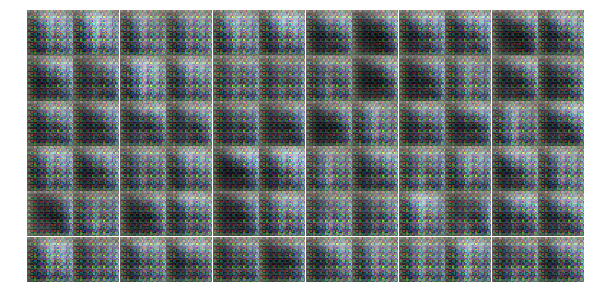

Epoch 1/25... Discriminator Loss: 0.4500... Generator Loss: 2.1917
Epoch 1/25... Discriminator Loss: 0.4488... Generator Loss: 2.0443
Epoch 1/25... Discriminator Loss: 0.4754... Generator Loss: 1.8228
Epoch 1/25... Discriminator Loss: 0.6422... Generator Loss: 4.4183
Epoch 1/25... Discriminator Loss: 0.8156... Generator Loss: 1.3935
Epoch 1/25... Discriminator Loss: 0.3833... Generator Loss: 2.0632
Epoch 1/25... Discriminator Loss: 0.6359... Generator Loss: 0.9627
Epoch 1/25... Discriminator Loss: 0.9306... Generator Loss: 2.2327
Epoch 1/25... Discriminator Loss: 0.5255... Generator Loss: 3.6500
Epoch 1/25... Discriminator Loss: 0.1829... Generator Loss: 2.6121


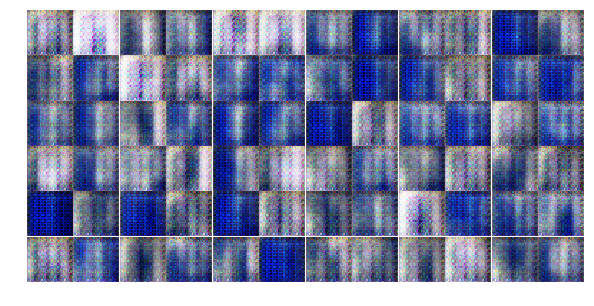

Epoch 1/25... Discriminator Loss: 0.2553... Generator Loss: 3.3765
Epoch 1/25... Discriminator Loss: 1.1713... Generator Loss: 5.4269
Epoch 1/25... Discriminator Loss: 0.3547... Generator Loss: 2.1694
Epoch 1/25... Discriminator Loss: 0.1165... Generator Loss: 2.8328
Epoch 1/25... Discriminator Loss: 0.1829... Generator Loss: 2.7463
Epoch 1/25... Discriminator Loss: 1.3889... Generator Loss: 0.4271
Epoch 1/25... Discriminator Loss: 0.3514... Generator Loss: 2.8850
Epoch 1/25... Discriminator Loss: 0.3204... Generator Loss: 2.2026
Epoch 1/25... Discriminator Loss: 1.0716... Generator Loss: 0.7683
Epoch 1/25... Discriminator Loss: 0.8071... Generator Loss: 3.7089


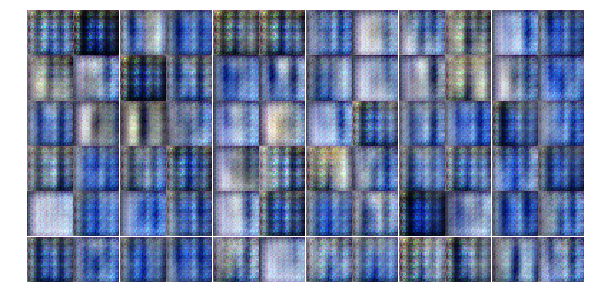

Epoch 1/25... Discriminator Loss: 0.5084... Generator Loss: 2.5986
Epoch 1/25... Discriminator Loss: 0.4722... Generator Loss: 1.2780
Epoch 1/25... Discriminator Loss: 0.4509... Generator Loss: 1.9323
Epoch 1/25... Discriminator Loss: 0.6297... Generator Loss: 1.3382
Epoch 1/25... Discriminator Loss: 0.4381... Generator Loss: 1.9526
Epoch 1/25... Discriminator Loss: 0.3776... Generator Loss: 2.7832
Epoch 1/25... Discriminator Loss: 0.5454... Generator Loss: 1.3656
Epoch 1/25... Discriminator Loss: 0.5074... Generator Loss: 1.9292
Epoch 1/25... Discriminator Loss: 0.4873... Generator Loss: 3.3685
Epoch 1/25... Discriminator Loss: 0.5268... Generator Loss: 1.9207


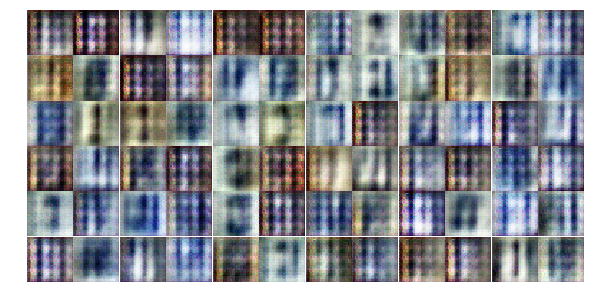

Epoch 1/25... Discriminator Loss: 0.6531... Generator Loss: 1.3487
Epoch 1/25... Discriminator Loss: 0.4070... Generator Loss: 2.1432
Epoch 1/25... Discriminator Loss: 0.5848... Generator Loss: 2.0342
Epoch 1/25... Discriminator Loss: 0.4802... Generator Loss: 2.1443
Epoch 1/25... Discriminator Loss: 1.0254... Generator Loss: 1.1040
Epoch 1/25... Discriminator Loss: 0.3151... Generator Loss: 2.2069
Epoch 1/25... Discriminator Loss: 0.3715... Generator Loss: 2.0901
Epoch 1/25... Discriminator Loss: 0.5252... Generator Loss: 1.8636
Epoch 1/25... Discriminator Loss: 0.5614... Generator Loss: 1.1863
Epoch 1/25... Discriminator Loss: 0.8020... Generator Loss: 1.2655


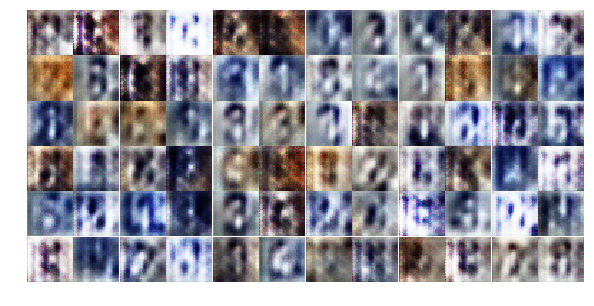

Epoch 1/25... Discriminator Loss: 0.9010... Generator Loss: 1.7108
Epoch 1/25... Discriminator Loss: 0.4511... Generator Loss: 2.0108
Epoch 1/25... Discriminator Loss: 0.4583... Generator Loss: 2.3485
Epoch 1/25... Discriminator Loss: 1.0509... Generator Loss: 0.8776
Epoch 1/25... Discriminator Loss: 0.8997... Generator Loss: 0.9978
Epoch 1/25... Discriminator Loss: 1.2405... Generator Loss: 0.6798
Epoch 1/25... Discriminator Loss: 0.7218... Generator Loss: 1.8811
Epoch 2/25... Discriminator Loss: 0.8518... Generator Loss: 1.6846
Epoch 2/25... Discriminator Loss: 0.5806... Generator Loss: 1.6793
Epoch 2/25... Discriminator Loss: 1.0989... Generator Loss: 0.7970


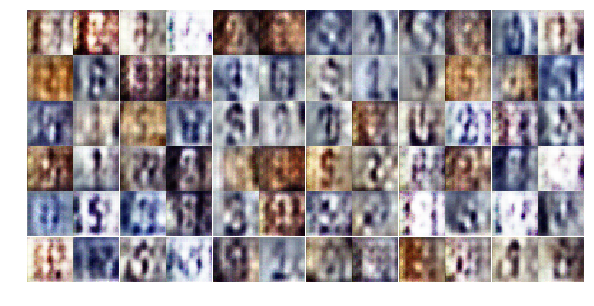

Epoch 2/25... Discriminator Loss: 0.6710... Generator Loss: 1.5403
Epoch 2/25... Discriminator Loss: 0.8216... Generator Loss: 1.2833
Epoch 2/25... Discriminator Loss: 1.0947... Generator Loss: 1.2020
Epoch 2/25... Discriminator Loss: 0.8402... Generator Loss: 1.5967
Epoch 2/25... Discriminator Loss: 0.9031... Generator Loss: 1.0608
Epoch 2/25... Discriminator Loss: 0.8503... Generator Loss: 1.6476
Epoch 2/25... Discriminator Loss: 1.0700... Generator Loss: 0.9380
Epoch 2/25... Discriminator Loss: 0.8413... Generator Loss: 1.2285
Epoch 2/25... Discriminator Loss: 1.1379... Generator Loss: 0.8365
Epoch 2/25... Discriminator Loss: 0.8348... Generator Loss: 1.7679


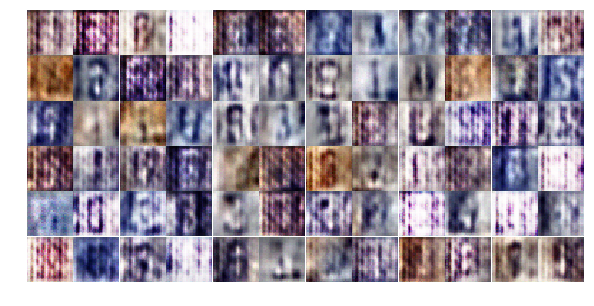

Epoch 2/25... Discriminator Loss: 1.1310... Generator Loss: 1.1446
Epoch 2/25... Discriminator Loss: 1.2355... Generator Loss: 1.7186
Epoch 2/25... Discriminator Loss: 0.9247... Generator Loss: 1.4645
Epoch 2/25... Discriminator Loss: 0.8368... Generator Loss: 1.4281
Epoch 2/25... Discriminator Loss: 0.9620... Generator Loss: 1.4877
Epoch 2/25... Discriminator Loss: 1.0502... Generator Loss: 0.9250
Epoch 2/25... Discriminator Loss: 1.0780... Generator Loss: 1.2584
Epoch 2/25... Discriminator Loss: 0.9489... Generator Loss: 1.6454
Epoch 2/25... Discriminator Loss: 0.9632... Generator Loss: 0.8404
Epoch 2/25... Discriminator Loss: 0.9975... Generator Loss: 0.7736


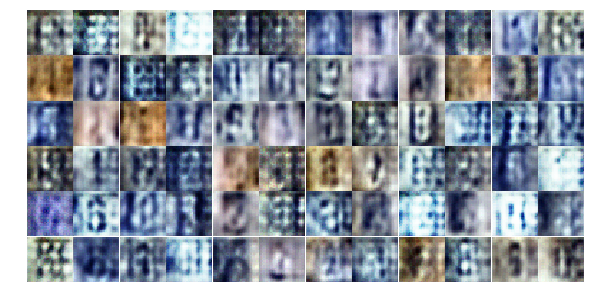

Epoch 2/25... Discriminator Loss: 1.1766... Generator Loss: 0.5920
Epoch 2/25... Discriminator Loss: 0.9905... Generator Loss: 1.1956
Epoch 2/25... Discriminator Loss: 0.7033... Generator Loss: 1.2946
Epoch 2/25... Discriminator Loss: 0.9454... Generator Loss: 1.1668
Epoch 2/25... Discriminator Loss: 0.7614... Generator Loss: 1.6553
Epoch 2/25... Discriminator Loss: 1.0131... Generator Loss: 1.0478
Epoch 2/25... Discriminator Loss: 0.6882... Generator Loss: 1.2192
Epoch 2/25... Discriminator Loss: 1.0566... Generator Loss: 0.8242
Epoch 2/25... Discriminator Loss: 0.9937... Generator Loss: 1.2407
Epoch 2/25... Discriminator Loss: 1.0140... Generator Loss: 0.9387


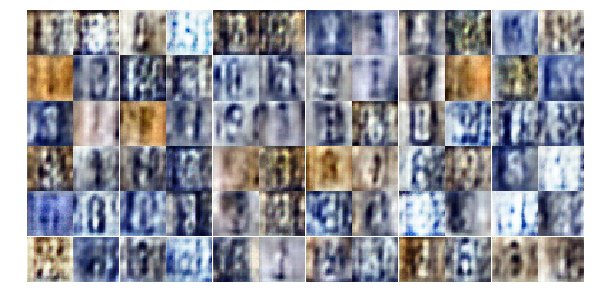

Epoch 2/25... Discriminator Loss: 1.0000... Generator Loss: 0.9762
Epoch 2/25... Discriminator Loss: 1.2905... Generator Loss: 1.0405
Epoch 2/25... Discriminator Loss: 1.1004... Generator Loss: 0.7725
Epoch 2/25... Discriminator Loss: 0.9837... Generator Loss: 1.1451
Epoch 2/25... Discriminator Loss: 0.9811... Generator Loss: 1.1960
Epoch 2/25... Discriminator Loss: 1.0249... Generator Loss: 1.0458
Epoch 2/25... Discriminator Loss: 1.4603... Generator Loss: 0.4871
Epoch 2/25... Discriminator Loss: 0.8212... Generator Loss: 1.2462
Epoch 2/25... Discriminator Loss: 0.8274... Generator Loss: 1.3217
Epoch 2/25... Discriminator Loss: 1.0924... Generator Loss: 1.6082


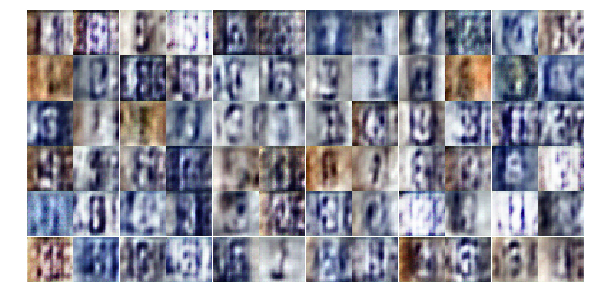

Epoch 2/25... Discriminator Loss: 0.7235... Generator Loss: 1.4853
Epoch 2/25... Discriminator Loss: 0.9951... Generator Loss: 0.8157
Epoch 2/25... Discriminator Loss: 0.7663... Generator Loss: 1.6633
Epoch 2/25... Discriminator Loss: 1.0196... Generator Loss: 0.8184
Epoch 2/25... Discriminator Loss: 0.8868... Generator Loss: 2.0252
Epoch 2/25... Discriminator Loss: 1.0627... Generator Loss: 0.6979
Epoch 2/25... Discriminator Loss: 0.9092... Generator Loss: 1.3946
Epoch 2/25... Discriminator Loss: 1.2364... Generator Loss: 2.0827
Epoch 2/25... Discriminator Loss: 0.8594... Generator Loss: 1.2025
Epoch 2/25... Discriminator Loss: 0.7162... Generator Loss: 1.4396


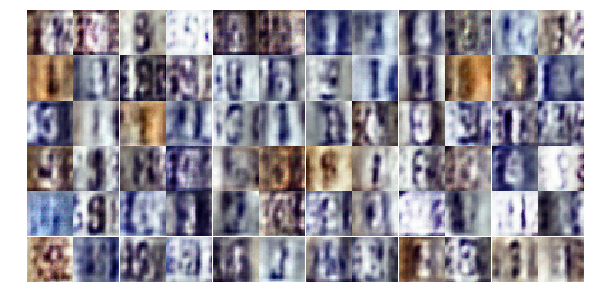

Epoch 2/25... Discriminator Loss: 0.5275... Generator Loss: 1.7512
Epoch 2/25... Discriminator Loss: 0.7273... Generator Loss: 1.3422
Epoch 2/25... Discriminator Loss: 0.7790... Generator Loss: 1.2078
Epoch 2/25... Discriminator Loss: 0.9036... Generator Loss: 1.2219
Epoch 3/25... Discriminator Loss: 1.0328... Generator Loss: 2.5744
Epoch 3/25... Discriminator Loss: 0.6922... Generator Loss: 1.5222
Epoch 3/25... Discriminator Loss: 1.3551... Generator Loss: 2.6970
Epoch 3/25... Discriminator Loss: 0.8445... Generator Loss: 0.8402
Epoch 3/25... Discriminator Loss: 0.6613... Generator Loss: 1.5801
Epoch 3/25... Discriminator Loss: 0.6253... Generator Loss: 1.4974


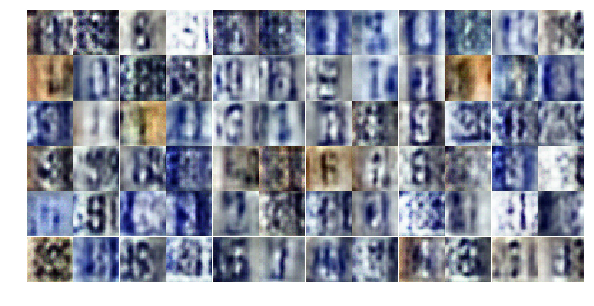

Epoch 3/25... Discriminator Loss: 0.6711... Generator Loss: 1.2604
Epoch 3/25... Discriminator Loss: 0.6602... Generator Loss: 1.9003
Epoch 3/25... Discriminator Loss: 0.5981... Generator Loss: 1.8348
Epoch 3/25... Discriminator Loss: 0.9996... Generator Loss: 0.6240
Epoch 3/25... Discriminator Loss: 0.8179... Generator Loss: 1.2190
Epoch 3/25... Discriminator Loss: 0.7294... Generator Loss: 1.0171
Epoch 3/25... Discriminator Loss: 1.0943... Generator Loss: 2.4162
Epoch 3/25... Discriminator Loss: 0.4376... Generator Loss: 2.1479
Epoch 3/25... Discriminator Loss: 0.5604... Generator Loss: 1.2943
Epoch 3/25... Discriminator Loss: 0.3424... Generator Loss: 1.8293


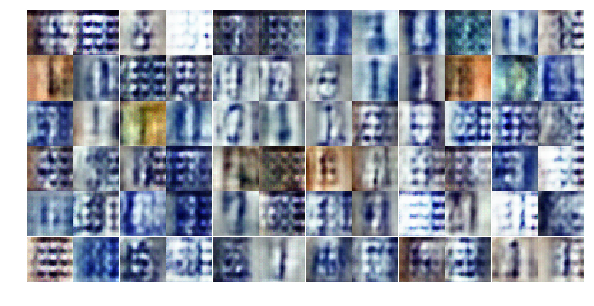

Epoch 3/25... Discriminator Loss: 0.9388... Generator Loss: 0.8943
Epoch 3/25... Discriminator Loss: 1.1648... Generator Loss: 0.8297
Epoch 3/25... Discriminator Loss: 1.1076... Generator Loss: 0.6152
Epoch 3/25... Discriminator Loss: 0.3898... Generator Loss: 2.1166
Epoch 3/25... Discriminator Loss: 0.7037... Generator Loss: 1.2122
Epoch 3/25... Discriminator Loss: 0.7215... Generator Loss: 1.0668
Epoch 3/25... Discriminator Loss: 0.5092... Generator Loss: 1.5379
Epoch 3/25... Discriminator Loss: 0.8408... Generator Loss: 0.9828
Epoch 3/25... Discriminator Loss: 0.5582... Generator Loss: 1.3724
Epoch 3/25... Discriminator Loss: 0.9983... Generator Loss: 0.6900


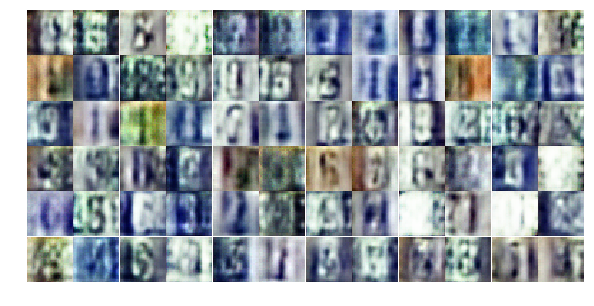

Epoch 3/25... Discriminator Loss: 0.4745... Generator Loss: 1.4169
Epoch 3/25... Discriminator Loss: 0.8563... Generator Loss: 1.6165
Epoch 3/25... Discriminator Loss: 0.5833... Generator Loss: 1.3315
Epoch 3/25... Discriminator Loss: 0.6882... Generator Loss: 1.6919
Epoch 3/25... Discriminator Loss: 0.6919... Generator Loss: 1.2008
Epoch 3/25... Discriminator Loss: 0.5057... Generator Loss: 1.9340
Epoch 3/25... Discriminator Loss: 0.3747... Generator Loss: 1.9232
Epoch 3/25... Discriminator Loss: 0.5994... Generator Loss: 1.3431
Epoch 3/25... Discriminator Loss: 0.4593... Generator Loss: 1.8476
Epoch 3/25... Discriminator Loss: 0.7362... Generator Loss: 2.2752


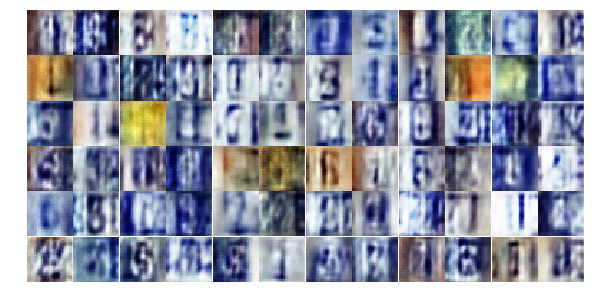

Epoch 3/25... Discriminator Loss: 0.5769... Generator Loss: 2.4295
Epoch 3/25... Discriminator Loss: 0.4090... Generator Loss: 2.1078
Epoch 3/25... Discriminator Loss: 0.3588... Generator Loss: 2.2776
Epoch 3/25... Discriminator Loss: 0.6617... Generator Loss: 2.4035
Epoch 3/25... Discriminator Loss: 0.8372... Generator Loss: 2.3202
Epoch 3/25... Discriminator Loss: 1.4371... Generator Loss: 1.7881
Epoch 3/25... Discriminator Loss: 0.5055... Generator Loss: 1.6081
Epoch 3/25... Discriminator Loss: 1.6582... Generator Loss: 0.4335
Epoch 3/25... Discriminator Loss: 0.9344... Generator Loss: 1.4440
Epoch 3/25... Discriminator Loss: 0.7257... Generator Loss: 1.0386


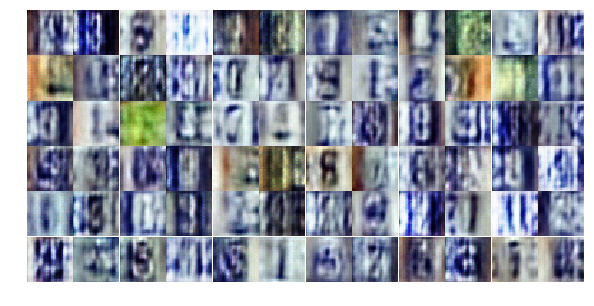

Epoch 3/25... Discriminator Loss: 0.9088... Generator Loss: 0.8904
Epoch 3/25... Discriminator Loss: 0.6830... Generator Loss: 1.1513
Epoch 3/25... Discriminator Loss: 0.4522... Generator Loss: 1.5889
Epoch 3/25... Discriminator Loss: 0.4890... Generator Loss: 1.7379
Epoch 3/25... Discriminator Loss: 0.6282... Generator Loss: 1.4815
Epoch 3/25... Discriminator Loss: 0.4465... Generator Loss: 2.3883
Epoch 3/25... Discriminator Loss: 0.7411... Generator Loss: 1.8720
Epoch 3/25... Discriminator Loss: 0.4744... Generator Loss: 1.8116
Epoch 3/25... Discriminator Loss: 0.5566... Generator Loss: 1.3070
Epoch 3/25... Discriminator Loss: 0.5187... Generator Loss: 2.1952


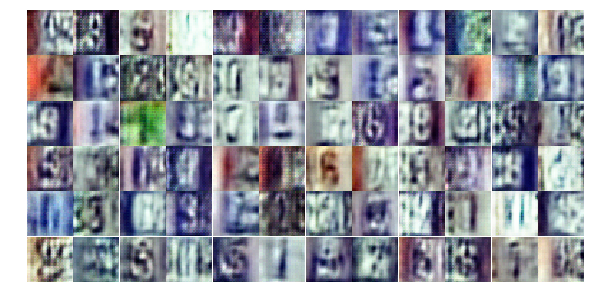

Epoch 3/25... Discriminator Loss: 0.5751... Generator Loss: 1.1959
Epoch 4/25... Discriminator Loss: 0.9353... Generator Loss: 1.2762
Epoch 4/25... Discriminator Loss: 0.6861... Generator Loss: 1.2080
Epoch 4/25... Discriminator Loss: 0.6920... Generator Loss: 0.9941
Epoch 4/25... Discriminator Loss: 0.7457... Generator Loss: 1.2132
Epoch 4/25... Discriminator Loss: 0.6877... Generator Loss: 1.1062
Epoch 4/25... Discriminator Loss: 0.7343... Generator Loss: 1.0251
Epoch 4/25... Discriminator Loss: 1.9093... Generator Loss: 0.2476
Epoch 4/25... Discriminator Loss: 0.4474... Generator Loss: 1.4875
Epoch 4/25... Discriminator Loss: 0.3827... Generator Loss: 1.8820


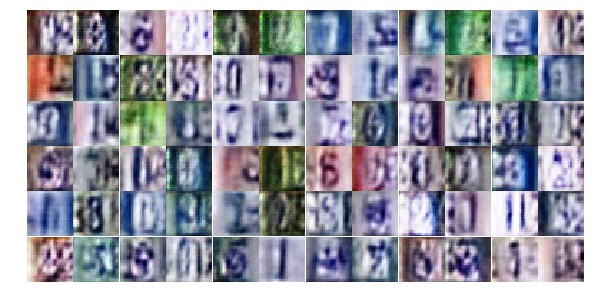

Epoch 4/25... Discriminator Loss: 0.4786... Generator Loss: 1.3855
Epoch 4/25... Discriminator Loss: 0.4506... Generator Loss: 1.4804
Epoch 4/25... Discriminator Loss: 1.3371... Generator Loss: 0.4647
Epoch 4/25... Discriminator Loss: 0.4810... Generator Loss: 1.6052
Epoch 4/25... Discriminator Loss: 0.6507... Generator Loss: 1.4297
Epoch 4/25... Discriminator Loss: 1.7657... Generator Loss: 0.2541
Epoch 4/25... Discriminator Loss: 1.3541... Generator Loss: 0.3958
Epoch 4/25... Discriminator Loss: 1.2352... Generator Loss: 0.5317
Epoch 4/25... Discriminator Loss: 1.5634... Generator Loss: 3.2369
Epoch 4/25... Discriminator Loss: 0.8340... Generator Loss: 1.9347


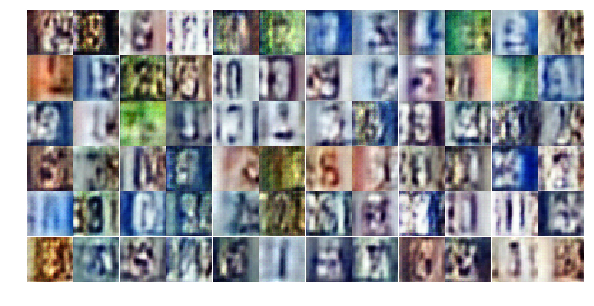

Epoch 4/25... Discriminator Loss: 0.5241... Generator Loss: 1.5757
Epoch 4/25... Discriminator Loss: 0.4176... Generator Loss: 1.8208
Epoch 4/25... Discriminator Loss: 0.5792... Generator Loss: 1.1638
Epoch 4/25... Discriminator Loss: 0.3736... Generator Loss: 2.0222
Epoch 4/25... Discriminator Loss: 0.6744... Generator Loss: 0.9508
Epoch 4/25... Discriminator Loss: 0.4397... Generator Loss: 1.9661
Epoch 4/25... Discriminator Loss: 0.4109... Generator Loss: 1.6531
Epoch 4/25... Discriminator Loss: 0.6417... Generator Loss: 2.5518
Epoch 4/25... Discriminator Loss: 0.5036... Generator Loss: 2.0619
Epoch 4/25... Discriminator Loss: 0.6607... Generator Loss: 1.1212


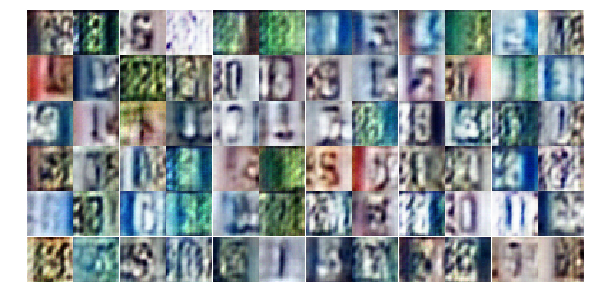

Epoch 4/25... Discriminator Loss: 0.4084... Generator Loss: 1.8984
Epoch 4/25... Discriminator Loss: 0.3776... Generator Loss: 1.7262
Epoch 4/25... Discriminator Loss: 0.7980... Generator Loss: 0.9223
Epoch 4/25... Discriminator Loss: 0.4277... Generator Loss: 2.5692
Epoch 4/25... Discriminator Loss: 0.3949... Generator Loss: 2.0362
Epoch 4/25... Discriminator Loss: 0.4375... Generator Loss: 1.7391
Epoch 4/25... Discriminator Loss: 0.6160... Generator Loss: 2.2456
Epoch 4/25... Discriminator Loss: 1.1072... Generator Loss: 0.5584
Epoch 4/25... Discriminator Loss: 0.5730... Generator Loss: 1.1514
Epoch 4/25... Discriminator Loss: 0.5730... Generator Loss: 1.4059


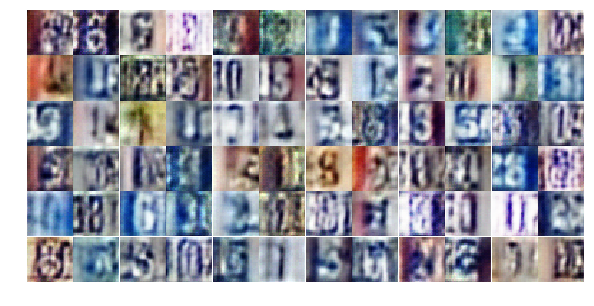

Epoch 4/25... Discriminator Loss: 0.4550... Generator Loss: 1.6717
Epoch 4/25... Discriminator Loss: 0.3522... Generator Loss: 1.9686
Epoch 4/25... Discriminator Loss: 1.1135... Generator Loss: 0.5180
Epoch 4/25... Discriminator Loss: 0.5738... Generator Loss: 1.3204
Epoch 4/25... Discriminator Loss: 0.5873... Generator Loss: 1.1706
Epoch 4/25... Discriminator Loss: 0.9992... Generator Loss: 0.7357
Epoch 4/25... Discriminator Loss: 0.7381... Generator Loss: 1.3118
Epoch 4/25... Discriminator Loss: 0.5487... Generator Loss: 1.6918
Epoch 4/25... Discriminator Loss: 1.0026... Generator Loss: 0.6126
Epoch 4/25... Discriminator Loss: 0.5129... Generator Loss: 1.3445


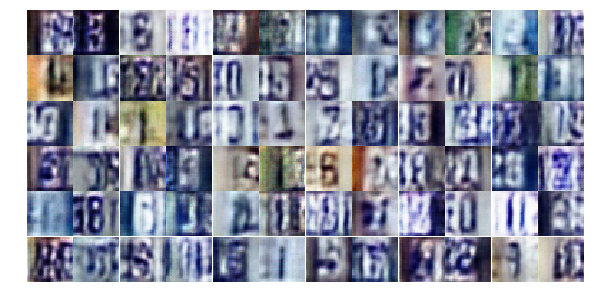

Epoch 4/25... Discriminator Loss: 0.4924... Generator Loss: 1.3781
Epoch 4/25... Discriminator Loss: 0.5514... Generator Loss: 1.4065
Epoch 4/25... Discriminator Loss: 0.4286... Generator Loss: 2.6839
Epoch 4/25... Discriminator Loss: 0.4394... Generator Loss: 2.5604
Epoch 4/25... Discriminator Loss: 0.5128... Generator Loss: 1.3600
Epoch 4/25... Discriminator Loss: 0.7024... Generator Loss: 1.0703
Epoch 4/25... Discriminator Loss: 0.6818... Generator Loss: 1.0079
Epoch 4/25... Discriminator Loss: 0.6327... Generator Loss: 1.3874
Epoch 4/25... Discriminator Loss: 0.5991... Generator Loss: 1.9653
Epoch 5/25... Discriminator Loss: 0.6159... Generator Loss: 1.0712


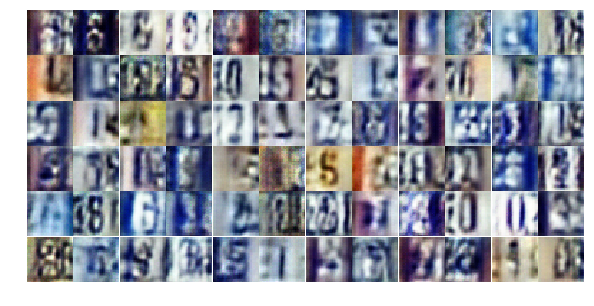

Epoch 5/25... Discriminator Loss: 0.2788... Generator Loss: 2.1180
Epoch 5/25... Discriminator Loss: 0.5044... Generator Loss: 1.3250
Epoch 5/25... Discriminator Loss: 0.5474... Generator Loss: 1.2374
Epoch 5/25... Discriminator Loss: 0.4150... Generator Loss: 2.1332
Epoch 5/25... Discriminator Loss: 0.6773... Generator Loss: 2.1130
Epoch 5/25... Discriminator Loss: 1.0078... Generator Loss: 0.7430
Epoch 5/25... Discriminator Loss: 0.5810... Generator Loss: 1.5344
Epoch 5/25... Discriminator Loss: 0.4565... Generator Loss: 1.5372
Epoch 5/25... Discriminator Loss: 1.0312... Generator Loss: 0.6274
Epoch 5/25... Discriminator Loss: 0.6101... Generator Loss: 1.1557


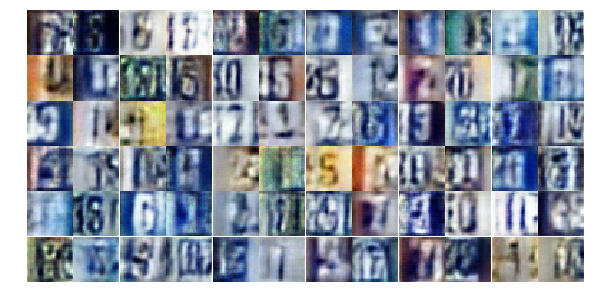

Epoch 5/25... Discriminator Loss: 0.6294... Generator Loss: 1.0323
Epoch 5/25... Discriminator Loss: 0.4732... Generator Loss: 1.4366
Epoch 5/25... Discriminator Loss: 0.7916... Generator Loss: 3.0059
Epoch 5/25... Discriminator Loss: 1.6989... Generator Loss: 0.2960
Epoch 5/25... Discriminator Loss: 0.8330... Generator Loss: 2.1314
Epoch 5/25... Discriminator Loss: 0.8936... Generator Loss: 0.7677
Epoch 5/25... Discriminator Loss: 0.6826... Generator Loss: 1.2191
Epoch 5/25... Discriminator Loss: 0.5072... Generator Loss: 1.6074
Epoch 5/25... Discriminator Loss: 0.4197... Generator Loss: 1.4219
Epoch 5/25... Discriminator Loss: 0.4744... Generator Loss: 1.4264


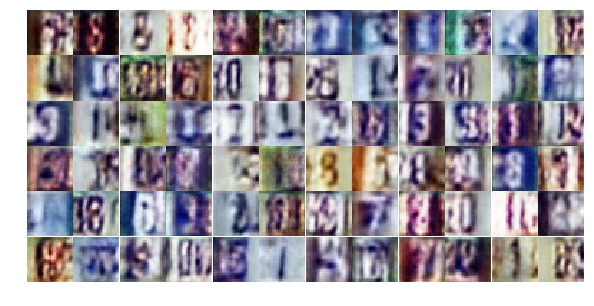

Epoch 5/25... Discriminator Loss: 0.6159... Generator Loss: 1.1059
Epoch 5/25... Discriminator Loss: 0.9563... Generator Loss: 2.2057
Epoch 5/25... Discriminator Loss: 0.7693... Generator Loss: 1.2223
Epoch 5/25... Discriminator Loss: 0.7195... Generator Loss: 1.0153
Epoch 5/25... Discriminator Loss: 0.6660... Generator Loss: 1.0305
Epoch 5/25... Discriminator Loss: 0.3953... Generator Loss: 1.6792
Epoch 5/25... Discriminator Loss: 0.6193... Generator Loss: 1.0249
Epoch 5/25... Discriminator Loss: 1.4055... Generator Loss: 0.4364
Epoch 5/25... Discriminator Loss: 1.9652... Generator Loss: 0.2715
Epoch 5/25... Discriminator Loss: 0.4221... Generator Loss: 1.9122


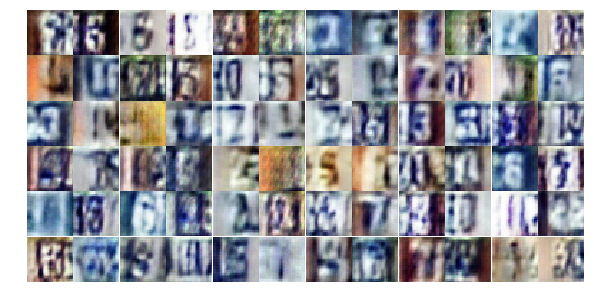

Epoch 5/25... Discriminator Loss: 0.7668... Generator Loss: 1.0316
Epoch 5/25... Discriminator Loss: 0.5980... Generator Loss: 1.4624
Epoch 5/25... Discriminator Loss: 0.6367... Generator Loss: 1.0926
Epoch 5/25... Discriminator Loss: 0.5365... Generator Loss: 1.2947
Epoch 5/25... Discriminator Loss: 0.5358... Generator Loss: 1.7285
Epoch 5/25... Discriminator Loss: 0.7681... Generator Loss: 0.9196
Epoch 5/25... Discriminator Loss: 0.7124... Generator Loss: 0.8936
Epoch 5/25... Discriminator Loss: 0.5323... Generator Loss: 1.4802
Epoch 5/25... Discriminator Loss: 1.4072... Generator Loss: 0.3747
Epoch 5/25... Discriminator Loss: 0.6980... Generator Loss: 0.9472


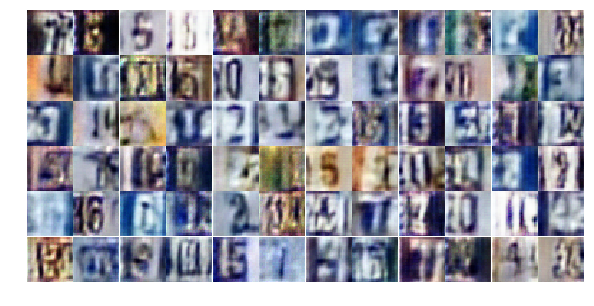

Epoch 5/25... Discriminator Loss: 0.3741... Generator Loss: 1.9970
Epoch 5/25... Discriminator Loss: 0.9275... Generator Loss: 0.6645
Epoch 5/25... Discriminator Loss: 0.9189... Generator Loss: 0.7101
Epoch 5/25... Discriminator Loss: 0.5510... Generator Loss: 1.8584
Epoch 5/25... Discriminator Loss: 1.0838... Generator Loss: 0.7304
Epoch 5/25... Discriminator Loss: 0.9287... Generator Loss: 0.7620
Epoch 5/25... Discriminator Loss: 0.6265... Generator Loss: 1.1938
Epoch 5/25... Discriminator Loss: 0.6340... Generator Loss: 2.0604
Epoch 5/25... Discriminator Loss: 0.6820... Generator Loss: 0.9725
Epoch 5/25... Discriminator Loss: 0.5671... Generator Loss: 1.2944


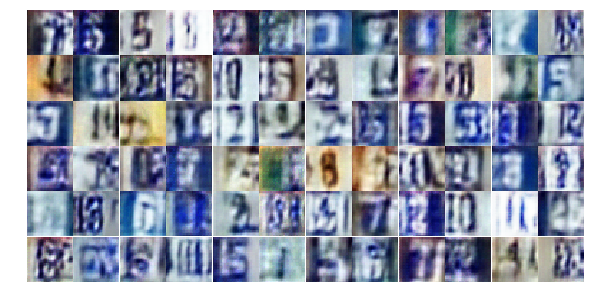

Epoch 5/25... Discriminator Loss: 0.7163... Generator Loss: 1.6194
Epoch 5/25... Discriminator Loss: 1.5524... Generator Loss: 0.3620
Epoch 5/25... Discriminator Loss: 0.7571... Generator Loss: 2.3342
Epoch 5/25... Discriminator Loss: 0.7074... Generator Loss: 0.9062
Epoch 5/25... Discriminator Loss: 0.6933... Generator Loss: 1.0966
Epoch 5/25... Discriminator Loss: 1.2147... Generator Loss: 0.5226
Epoch 6/25... Discriminator Loss: 0.9059... Generator Loss: 0.8035
Epoch 6/25... Discriminator Loss: 0.5020... Generator Loss: 1.4131
Epoch 6/25... Discriminator Loss: 0.5810... Generator Loss: 1.1685
Epoch 6/25... Discriminator Loss: 0.5272... Generator Loss: 1.5817


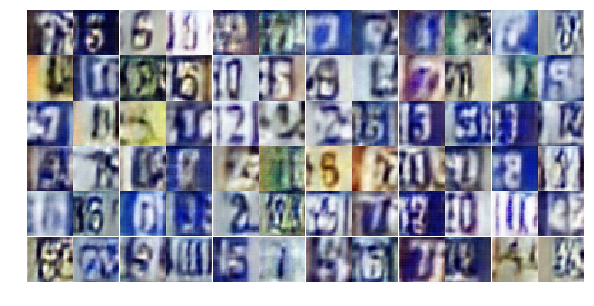

Epoch 6/25... Discriminator Loss: 0.7984... Generator Loss: 0.8304
Epoch 6/25... Discriminator Loss: 0.8354... Generator Loss: 0.9287
Epoch 6/25... Discriminator Loss: 0.7002... Generator Loss: 1.7940
Epoch 6/25... Discriminator Loss: 1.0769... Generator Loss: 0.6352
Epoch 6/25... Discriminator Loss: 0.9766... Generator Loss: 0.6269
Epoch 6/25... Discriminator Loss: 0.7627... Generator Loss: 0.8949
Epoch 6/25... Discriminator Loss: 0.4624... Generator Loss: 2.1606
Epoch 6/25... Discriminator Loss: 1.5036... Generator Loss: 0.3195
Epoch 6/25... Discriminator Loss: 0.7871... Generator Loss: 0.7991
Epoch 6/25... Discriminator Loss: 0.5177... Generator Loss: 1.3742


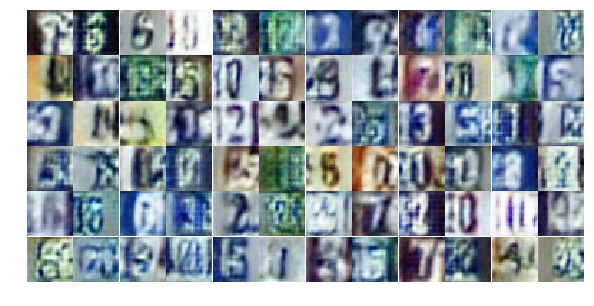

Epoch 6/25... Discriminator Loss: 0.5663... Generator Loss: 1.4363
Epoch 6/25... Discriminator Loss: 0.8022... Generator Loss: 1.2038
Epoch 6/25... Discriminator Loss: 0.7279... Generator Loss: 1.0627
Epoch 6/25... Discriminator Loss: 0.6858... Generator Loss: 0.9848
Epoch 6/25... Discriminator Loss: 0.3993... Generator Loss: 2.0277
Epoch 6/25... Discriminator Loss: 0.5891... Generator Loss: 1.3294
Epoch 6/25... Discriminator Loss: 0.5352... Generator Loss: 1.3218
Epoch 6/25... Discriminator Loss: 0.7241... Generator Loss: 0.9472
Epoch 6/25... Discriminator Loss: 0.6782... Generator Loss: 1.8268
Epoch 6/25... Discriminator Loss: 0.7789... Generator Loss: 1.0756


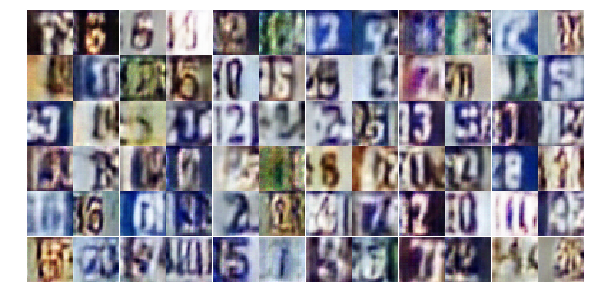

Epoch 6/25... Discriminator Loss: 0.6826... Generator Loss: 1.0485
Epoch 6/25... Discriminator Loss: 0.6696... Generator Loss: 0.9817
Epoch 6/25... Discriminator Loss: 1.3259... Generator Loss: 0.4521
Epoch 6/25... Discriminator Loss: 0.8422... Generator Loss: 0.8984
Epoch 6/25... Discriminator Loss: 0.4085... Generator Loss: 1.8097
Epoch 6/25... Discriminator Loss: 1.4588... Generator Loss: 0.4287
Epoch 6/25... Discriminator Loss: 0.7219... Generator Loss: 0.9780
Epoch 6/25... Discriminator Loss: 0.3791... Generator Loss: 2.0487
Epoch 6/25... Discriminator Loss: 0.6646... Generator Loss: 2.3143
Epoch 6/25... Discriminator Loss: 0.5134... Generator Loss: 1.4286


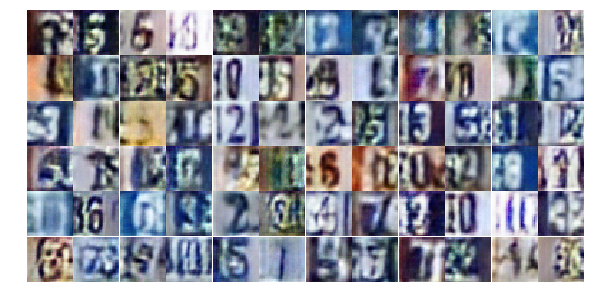

Epoch 6/25... Discriminator Loss: 1.3893... Generator Loss: 0.4017
Epoch 6/25... Discriminator Loss: 0.6014... Generator Loss: 1.3977
Epoch 6/25... Discriminator Loss: 0.5201... Generator Loss: 1.6212
Epoch 6/25... Discriminator Loss: 0.5031... Generator Loss: 1.3144
Epoch 6/25... Discriminator Loss: 1.0801... Generator Loss: 0.5586
Epoch 6/25... Discriminator Loss: 0.8383... Generator Loss: 0.8297
Epoch 6/25... Discriminator Loss: 0.6545... Generator Loss: 1.1933
Epoch 6/25... Discriminator Loss: 0.8954... Generator Loss: 0.8024
Epoch 6/25... Discriminator Loss: 0.6754... Generator Loss: 1.8996
Epoch 6/25... Discriminator Loss: 0.4542... Generator Loss: 1.4747


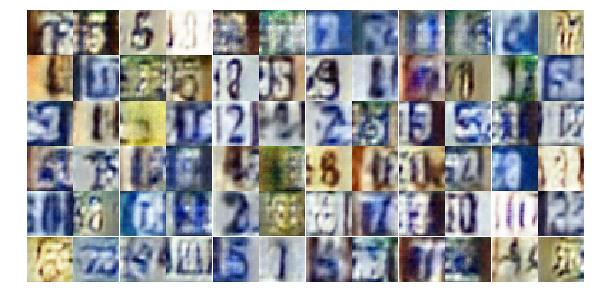

Epoch 6/25... Discriminator Loss: 0.7010... Generator Loss: 1.5954
Epoch 6/25... Discriminator Loss: 0.5823... Generator Loss: 1.5294
Epoch 6/25... Discriminator Loss: 0.7428... Generator Loss: 1.0284
Epoch 6/25... Discriminator Loss: 0.4482... Generator Loss: 2.6583
Epoch 6/25... Discriminator Loss: 0.5998... Generator Loss: 1.4016
Epoch 6/25... Discriminator Loss: 0.4739... Generator Loss: 1.4514
Epoch 6/25... Discriminator Loss: 0.6791... Generator Loss: 1.1323
Epoch 6/25... Discriminator Loss: 0.7171... Generator Loss: 1.1047
Epoch 6/25... Discriminator Loss: 0.5382... Generator Loss: 1.4334
Epoch 6/25... Discriminator Loss: 1.9195... Generator Loss: 0.2980


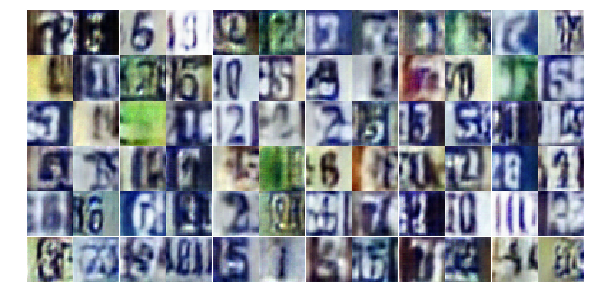

Epoch 6/25... Discriminator Loss: 0.5710... Generator Loss: 1.2154
Epoch 6/25... Discriminator Loss: 0.4647... Generator Loss: 1.8554
Epoch 6/25... Discriminator Loss: 0.5098... Generator Loss: 1.5457
Epoch 7/25... Discriminator Loss: 0.5473... Generator Loss: 1.3314
Epoch 7/25... Discriminator Loss: 0.4862... Generator Loss: 1.7707
Epoch 7/25... Discriminator Loss: 0.7544... Generator Loss: 0.9341
Epoch 7/25... Discriminator Loss: 0.3807... Generator Loss: 1.6402
Epoch 7/25... Discriminator Loss: 0.5370... Generator Loss: 1.6176
Epoch 7/25... Discriminator Loss: 0.5645... Generator Loss: 2.4568
Epoch 7/25... Discriminator Loss: 0.7770... Generator Loss: 0.9835


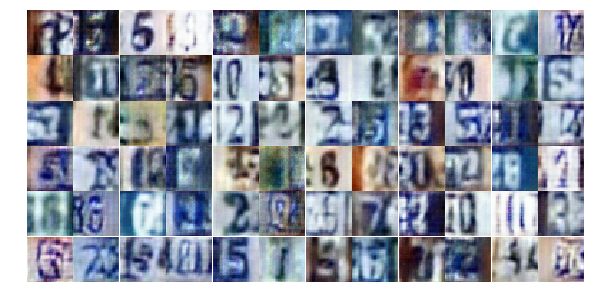

Epoch 7/25... Discriminator Loss: 0.5724... Generator Loss: 1.9522
Epoch 7/25... Discriminator Loss: 0.6611... Generator Loss: 1.1691
Epoch 7/25... Discriminator Loss: 0.9485... Generator Loss: 0.6902
Epoch 7/25... Discriminator Loss: 0.7721... Generator Loss: 0.9127
Epoch 7/25... Discriminator Loss: 0.5657... Generator Loss: 1.3501
Epoch 7/25... Discriminator Loss: 0.4579... Generator Loss: 1.5359
Epoch 7/25... Discriminator Loss: 0.6224... Generator Loss: 2.5245
Epoch 7/25... Discriminator Loss: 1.0921... Generator Loss: 2.4865
Epoch 7/25... Discriminator Loss: 0.5194... Generator Loss: 3.0230
Epoch 7/25... Discriminator Loss: 0.5357... Generator Loss: 1.2247


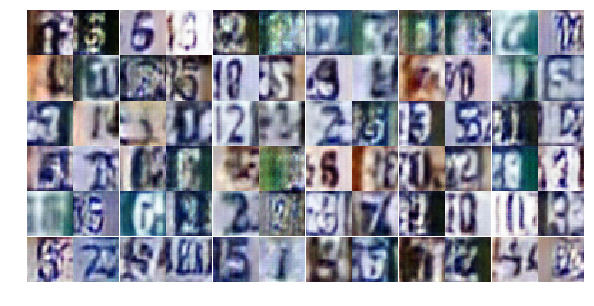

Epoch 7/25... Discriminator Loss: 0.8453... Generator Loss: 0.8071
Epoch 7/25... Discriminator Loss: 0.6296... Generator Loss: 1.3007
Epoch 7/25... Discriminator Loss: 0.6833... Generator Loss: 1.6426
Epoch 7/25... Discriminator Loss: 0.4955... Generator Loss: 1.5228
Epoch 7/25... Discriminator Loss: 0.4614... Generator Loss: 1.7461
Epoch 7/25... Discriminator Loss: 0.5360... Generator Loss: 1.1894
Epoch 7/25... Discriminator Loss: 0.6310... Generator Loss: 1.0356
Epoch 7/25... Discriminator Loss: 1.3782... Generator Loss: 0.4017
Epoch 7/25... Discriminator Loss: 0.4557... Generator Loss: 1.5437
Epoch 7/25... Discriminator Loss: 0.4545... Generator Loss: 1.8325


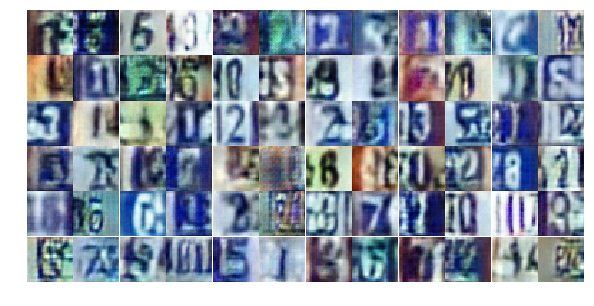

Epoch 7/25... Discriminator Loss: 0.6263... Generator Loss: 1.0435
Epoch 7/25... Discriminator Loss: 1.5554... Generator Loss: 0.3249
Epoch 7/25... Discriminator Loss: 0.5544... Generator Loss: 1.2983
Epoch 7/25... Discriminator Loss: 0.5628... Generator Loss: 1.3126
Epoch 7/25... Discriminator Loss: 0.7066... Generator Loss: 0.9876
Epoch 7/25... Discriminator Loss: 1.0763... Generator Loss: 0.5477
Epoch 7/25... Discriminator Loss: 0.5810... Generator Loss: 1.1800
Epoch 7/25... Discriminator Loss: 0.5935... Generator Loss: 1.1747
Epoch 7/25... Discriminator Loss: 1.6829... Generator Loss: 0.3043
Epoch 7/25... Discriminator Loss: 0.4871... Generator Loss: 1.8576


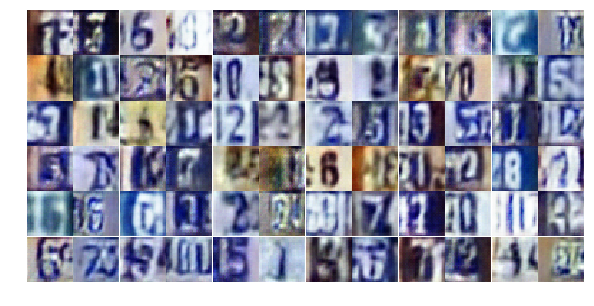

Epoch 7/25... Discriminator Loss: 1.3453... Generator Loss: 0.5174
Epoch 7/25... Discriminator Loss: 0.7842... Generator Loss: 0.8786
Epoch 7/25... Discriminator Loss: 0.3864... Generator Loss: 1.6700
Epoch 7/25... Discriminator Loss: 1.0660... Generator Loss: 0.5810
Epoch 7/25... Discriminator Loss: 0.7956... Generator Loss: 1.2920
Epoch 7/25... Discriminator Loss: 0.3545... Generator Loss: 2.1684
Epoch 7/25... Discriminator Loss: 0.6376... Generator Loss: 1.0470
Epoch 7/25... Discriminator Loss: 1.0448... Generator Loss: 2.5549
Epoch 7/25... Discriminator Loss: 0.5669... Generator Loss: 3.8436
Epoch 7/25... Discriminator Loss: 0.6443... Generator Loss: 1.5106


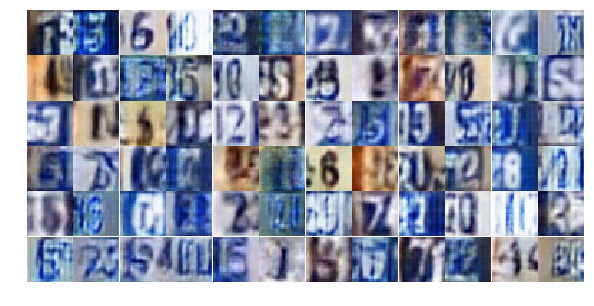

Epoch 7/25... Discriminator Loss: 0.4092... Generator Loss: 2.4187
Epoch 7/25... Discriminator Loss: 0.6732... Generator Loss: 1.0119
Epoch 7/25... Discriminator Loss: 0.9570... Generator Loss: 0.7044
Epoch 7/25... Discriminator Loss: 0.5123... Generator Loss: 1.5992
Epoch 7/25... Discriminator Loss: 0.5619... Generator Loss: 1.3595
Epoch 7/25... Discriminator Loss: 0.5079... Generator Loss: 1.2919
Epoch 7/25... Discriminator Loss: 1.1983... Generator Loss: 0.5082
Epoch 7/25... Discriminator Loss: 0.8496... Generator Loss: 1.8845
Epoch 7/25... Discriminator Loss: 0.7469... Generator Loss: 1.0598
Epoch 7/25... Discriminator Loss: 0.6769... Generator Loss: 0.9055


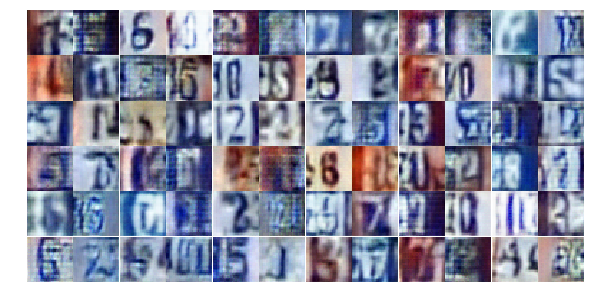

Epoch 7/25... Discriminator Loss: 0.4351... Generator Loss: 1.6685
Epoch 8/25... Discriminator Loss: 0.6242... Generator Loss: 1.2790
Epoch 8/25... Discriminator Loss: 0.9968... Generator Loss: 0.6133
Epoch 8/25... Discriminator Loss: 0.7060... Generator Loss: 1.0724
Epoch 8/25... Discriminator Loss: 0.9986... Generator Loss: 0.7382
Epoch 8/25... Discriminator Loss: 0.9003... Generator Loss: 0.8189
Epoch 8/25... Discriminator Loss: 0.3719... Generator Loss: 1.8508
Epoch 8/25... Discriminator Loss: 0.3600... Generator Loss: 1.8842
Epoch 8/25... Discriminator Loss: 0.7364... Generator Loss: 0.9767
Epoch 8/25... Discriminator Loss: 0.8989... Generator Loss: 0.6997


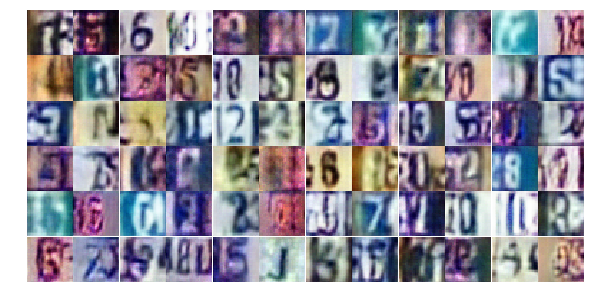

Epoch 8/25... Discriminator Loss: 0.4636... Generator Loss: 1.4380
Epoch 8/25... Discriminator Loss: 0.4538... Generator Loss: 1.3877
Epoch 8/25... Discriminator Loss: 0.6257... Generator Loss: 1.0818
Epoch 8/25... Discriminator Loss: 0.3411... Generator Loss: 2.2459
Epoch 8/25... Discriminator Loss: 0.9730... Generator Loss: 0.6250
Epoch 8/25... Discriminator Loss: 1.3655... Generator Loss: 3.4412
Epoch 8/25... Discriminator Loss: 0.4595... Generator Loss: 1.7340
Epoch 8/25... Discriminator Loss: 0.5236... Generator Loss: 1.3655
Epoch 8/25... Discriminator Loss: 0.4666... Generator Loss: 1.4785
Epoch 8/25... Discriminator Loss: 0.9742... Generator Loss: 0.6618


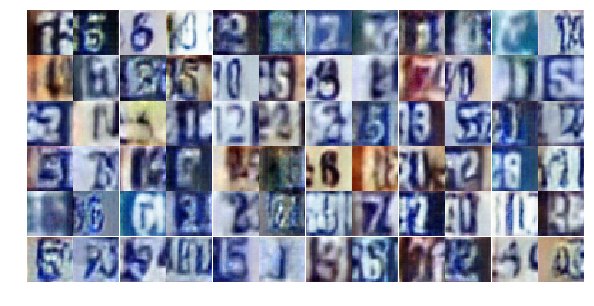

Epoch 8/25... Discriminator Loss: 0.4849... Generator Loss: 1.6848
Epoch 8/25... Discriminator Loss: 0.7735... Generator Loss: 0.8354
Epoch 8/25... Discriminator Loss: 0.7179... Generator Loss: 0.8858
Epoch 8/25... Discriminator Loss: 0.5631... Generator Loss: 1.3059
Epoch 8/25... Discriminator Loss: 0.4316... Generator Loss: 1.9461
Epoch 8/25... Discriminator Loss: 0.6285... Generator Loss: 1.1438
Epoch 8/25... Discriminator Loss: 0.7427... Generator Loss: 1.0668
Epoch 8/25... Discriminator Loss: 0.3915... Generator Loss: 2.3465
Epoch 8/25... Discriminator Loss: 0.7147... Generator Loss: 2.0415
Epoch 8/25... Discriminator Loss: 0.6964... Generator Loss: 0.9643


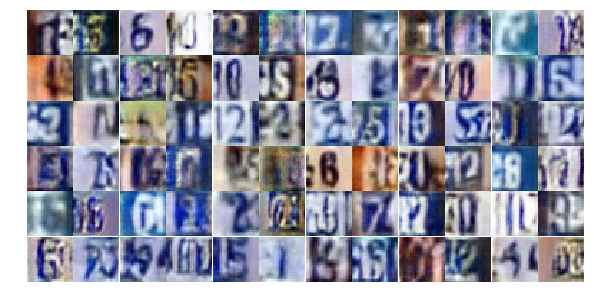

Epoch 8/25... Discriminator Loss: 0.8139... Generator Loss: 0.8094
Epoch 8/25... Discriminator Loss: 1.0174... Generator Loss: 0.6261
Epoch 8/25... Discriminator Loss: 0.5751... Generator Loss: 1.3456
Epoch 8/25... Discriminator Loss: 1.1378... Generator Loss: 0.5483
Epoch 8/25... Discriminator Loss: 0.6918... Generator Loss: 1.0245
Epoch 8/25... Discriminator Loss: 0.6643... Generator Loss: 1.0845
Epoch 8/25... Discriminator Loss: 0.5171... Generator Loss: 1.6180
Epoch 8/25... Discriminator Loss: 0.4488... Generator Loss: 1.5588
Epoch 8/25... Discriminator Loss: 0.4369... Generator Loss: 1.6167
Epoch 8/25... Discriminator Loss: 0.4798... Generator Loss: 1.8703


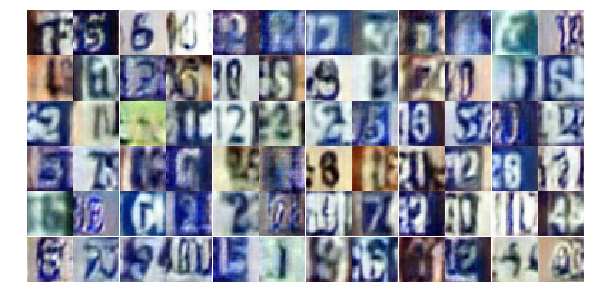

Epoch 8/25... Discriminator Loss: 0.5333... Generator Loss: 2.3131
Epoch 8/25... Discriminator Loss: 0.9012... Generator Loss: 0.7089
Epoch 8/25... Discriminator Loss: 0.5270... Generator Loss: 1.2403
Epoch 8/25... Discriminator Loss: 0.7534... Generator Loss: 0.9075
Epoch 8/25... Discriminator Loss: 3.0138... Generator Loss: 3.6229
Epoch 8/25... Discriminator Loss: 1.6292... Generator Loss: 0.3357
Epoch 8/25... Discriminator Loss: 0.4290... Generator Loss: 1.9806
Epoch 8/25... Discriminator Loss: 0.6591... Generator Loss: 1.0419
Epoch 8/25... Discriminator Loss: 0.5212... Generator Loss: 1.6843
Epoch 8/25... Discriminator Loss: 0.7939... Generator Loss: 0.8554


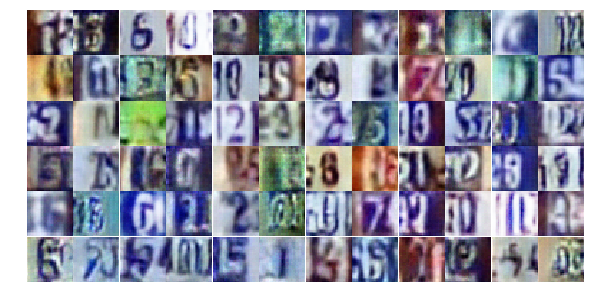

Epoch 8/25... Discriminator Loss: 0.4777... Generator Loss: 2.2061
Epoch 8/25... Discriminator Loss: 0.5387... Generator Loss: 1.4185
Epoch 8/25... Discriminator Loss: 0.5476... Generator Loss: 1.9631
Epoch 8/25... Discriminator Loss: 0.8102... Generator Loss: 0.8102
Epoch 8/25... Discriminator Loss: 0.5910... Generator Loss: 1.5831
Epoch 8/25... Discriminator Loss: 0.7650... Generator Loss: 1.3318
Epoch 8/25... Discriminator Loss: 0.7008... Generator Loss: 1.1895
Epoch 8/25... Discriminator Loss: 0.7345... Generator Loss: 2.8259
Epoch 9/25... Discriminator Loss: 0.8092... Generator Loss: 0.9101
Epoch 9/25... Discriminator Loss: 0.7009... Generator Loss: 1.0239


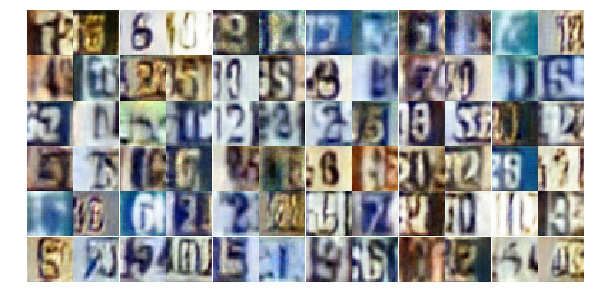

Epoch 9/25... Discriminator Loss: 0.8645... Generator Loss: 0.8309
Epoch 9/25... Discriminator Loss: 0.6081... Generator Loss: 1.1217
Epoch 9/25... Discriminator Loss: 0.9764... Generator Loss: 0.6522
Epoch 9/25... Discriminator Loss: 0.4559... Generator Loss: 1.9320
Epoch 9/25... Discriminator Loss: 0.9409... Generator Loss: 0.7515
Epoch 9/25... Discriminator Loss: 0.5262... Generator Loss: 1.7511
Epoch 9/25... Discriminator Loss: 0.6838... Generator Loss: 1.1236
Epoch 9/25... Discriminator Loss: 0.5372... Generator Loss: 1.1891
Epoch 9/25... Discriminator Loss: 0.6827... Generator Loss: 1.0250
Epoch 9/25... Discriminator Loss: 0.5350... Generator Loss: 2.0536


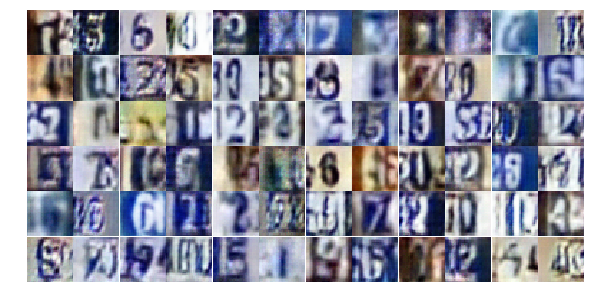

Epoch 9/25... Discriminator Loss: 0.8241... Generator Loss: 0.7830
Epoch 9/25... Discriminator Loss: 0.6121... Generator Loss: 2.0095
Epoch 9/25... Discriminator Loss: 0.8202... Generator Loss: 0.8964
Epoch 9/25... Discriminator Loss: 0.9238... Generator Loss: 0.7470
Epoch 9/25... Discriminator Loss: 0.5389... Generator Loss: 1.7651
Epoch 9/25... Discriminator Loss: 1.5194... Generator Loss: 3.3262
Epoch 9/25... Discriminator Loss: 0.9892... Generator Loss: 0.7062
Epoch 9/25... Discriminator Loss: 0.8751... Generator Loss: 3.1594
Epoch 9/25... Discriminator Loss: 1.2240... Generator Loss: 0.5111
Epoch 9/25... Discriminator Loss: 1.0101... Generator Loss: 0.6524


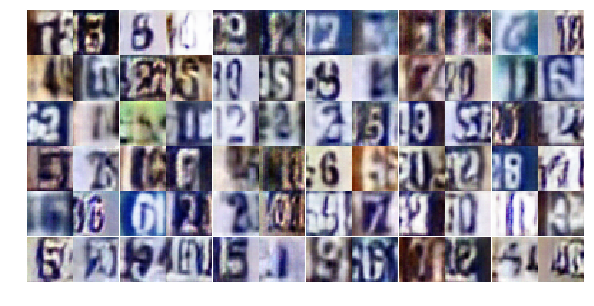

Epoch 9/25... Discriminator Loss: 0.6722... Generator Loss: 1.0461
Epoch 9/25... Discriminator Loss: 0.6139... Generator Loss: 1.1422
Epoch 9/25... Discriminator Loss: 0.5539... Generator Loss: 1.1884
Epoch 9/25... Discriminator Loss: 0.5691... Generator Loss: 1.1723
Epoch 9/25... Discriminator Loss: 0.4871... Generator Loss: 1.3451
Epoch 9/25... Discriminator Loss: 0.6150... Generator Loss: 1.1694
Epoch 9/25... Discriminator Loss: 0.8071... Generator Loss: 0.9156
Epoch 9/25... Discriminator Loss: 0.5024... Generator Loss: 1.5478
Epoch 9/25... Discriminator Loss: 0.5246... Generator Loss: 1.3309
Epoch 9/25... Discriminator Loss: 0.6075... Generator Loss: 1.0745


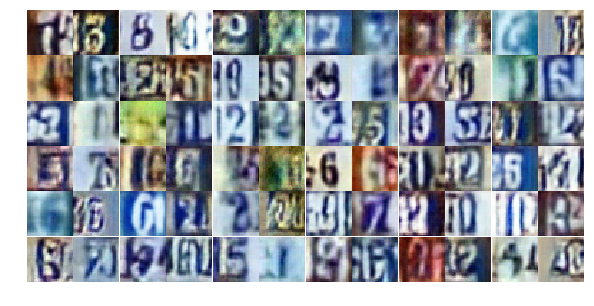

Epoch 9/25... Discriminator Loss: 0.6270... Generator Loss: 1.0149
Epoch 9/25... Discriminator Loss: 0.5750... Generator Loss: 1.1993
Epoch 9/25... Discriminator Loss: 0.7841... Generator Loss: 1.0874
Epoch 9/25... Discriminator Loss: 0.5632... Generator Loss: 1.8641
Epoch 9/25... Discriminator Loss: 0.4801... Generator Loss: 1.5603
Epoch 9/25... Discriminator Loss: 0.5739... Generator Loss: 1.1937
Epoch 9/25... Discriminator Loss: 0.6794... Generator Loss: 2.0630
Epoch 9/25... Discriminator Loss: 0.3649... Generator Loss: 1.6437
Epoch 9/25... Discriminator Loss: 0.5236... Generator Loss: 1.3785
Epoch 9/25... Discriminator Loss: 0.6784... Generator Loss: 1.0083


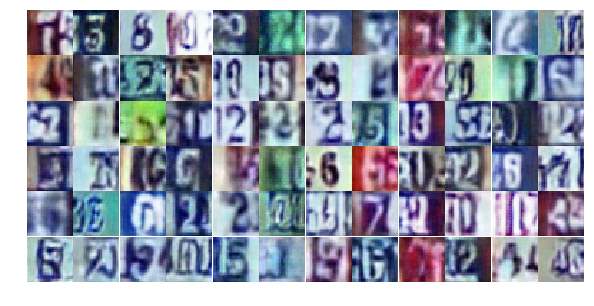

Epoch 9/25... Discriminator Loss: 0.4254... Generator Loss: 1.4437
Epoch 9/25... Discriminator Loss: 0.7349... Generator Loss: 1.3727
Epoch 9/25... Discriminator Loss: 1.0457... Generator Loss: 0.5995
Epoch 9/25... Discriminator Loss: 0.7121... Generator Loss: 1.2952
Epoch 9/25... Discriminator Loss: 0.4651... Generator Loss: 1.7828
Epoch 9/25... Discriminator Loss: 0.7676... Generator Loss: 1.0308
Epoch 9/25... Discriminator Loss: 0.6747... Generator Loss: 1.0433
Epoch 9/25... Discriminator Loss: 0.6010... Generator Loss: 1.0572
Epoch 9/25... Discriminator Loss: 0.4636... Generator Loss: 2.3940
Epoch 9/25... Discriminator Loss: 0.5618... Generator Loss: 1.6553


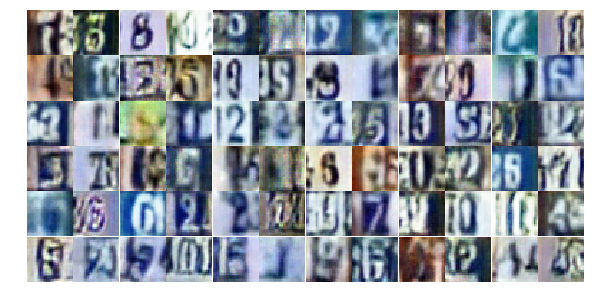

Epoch 9/25... Discriminator Loss: 0.8155... Generator Loss: 0.7622
Epoch 9/25... Discriminator Loss: 1.3204... Generator Loss: 3.3610
Epoch 9/25... Discriminator Loss: 0.9560... Generator Loss: 0.8409
Epoch 9/25... Discriminator Loss: 0.9471... Generator Loss: 0.6448
Epoch 9/25... Discriminator Loss: 0.5913... Generator Loss: 1.3461
Epoch 10/25... Discriminator Loss: 0.6171... Generator Loss: 1.0852
Epoch 10/25... Discriminator Loss: 0.6168... Generator Loss: 1.1623
Epoch 10/25... Discriminator Loss: 0.5440... Generator Loss: 1.1827
Epoch 10/25... Discriminator Loss: 0.8234... Generator Loss: 0.7774
Epoch 10/25... Discriminator Loss: 1.2113... Generator Loss: 0.4776


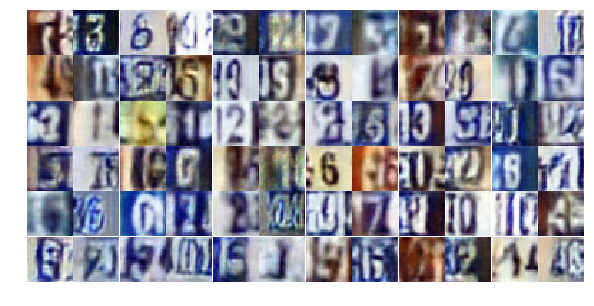

Epoch 10/25... Discriminator Loss: 0.9325... Generator Loss: 0.6055
Epoch 10/25... Discriminator Loss: 0.5871... Generator Loss: 1.3031
Epoch 10/25... Discriminator Loss: 0.6632... Generator Loss: 1.3275
Epoch 10/25... Discriminator Loss: 0.5902... Generator Loss: 1.5329
Epoch 10/25... Discriminator Loss: 0.7416... Generator Loss: 2.1033
Epoch 10/25... Discriminator Loss: 0.6111... Generator Loss: 1.3651
Epoch 10/25... Discriminator Loss: 0.5795... Generator Loss: 1.2394
Epoch 10/25... Discriminator Loss: 1.2312... Generator Loss: 0.5448
Epoch 10/25... Discriminator Loss: 1.1876... Generator Loss: 0.5703
Epoch 10/25... Discriminator Loss: 0.9064... Generator Loss: 1.0466


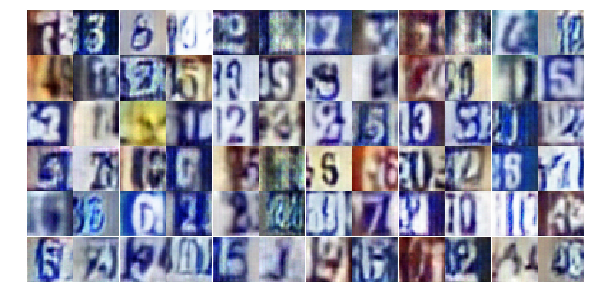

Epoch 10/25... Discriminator Loss: 0.9792... Generator Loss: 0.8328
Epoch 10/25... Discriminator Loss: 1.0684... Generator Loss: 0.5876
Epoch 10/25... Discriminator Loss: 0.6426... Generator Loss: 1.0687
Epoch 10/25... Discriminator Loss: 0.9936... Generator Loss: 0.6100
Epoch 10/25... Discriminator Loss: 0.5371... Generator Loss: 1.3624
Epoch 10/25... Discriminator Loss: 0.5232... Generator Loss: 1.2932
Epoch 10/25... Discriminator Loss: 0.9133... Generator Loss: 0.7407
Epoch 10/25... Discriminator Loss: 0.4421... Generator Loss: 1.6116
Epoch 10/25... Discriminator Loss: 0.5812... Generator Loss: 1.2033
Epoch 10/25... Discriminator Loss: 0.5130... Generator Loss: 2.8481


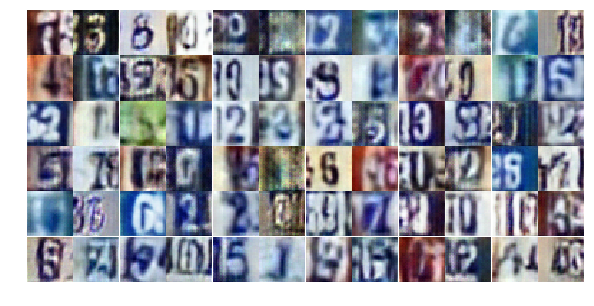

Epoch 10/25... Discriminator Loss: 1.0407... Generator Loss: 0.5791
Epoch 10/25... Discriminator Loss: 1.1878... Generator Loss: 0.5319
Epoch 10/25... Discriminator Loss: 0.6570... Generator Loss: 1.0395
Epoch 10/25... Discriminator Loss: 0.4195... Generator Loss: 1.5545
Epoch 10/25... Discriminator Loss: 1.7019... Generator Loss: 0.2819
Epoch 10/25... Discriminator Loss: 0.8303... Generator Loss: 0.8033
Epoch 10/25... Discriminator Loss: 0.3833... Generator Loss: 1.5641
Epoch 10/25... Discriminator Loss: 1.1465... Generator Loss: 0.5379
Epoch 10/25... Discriminator Loss: 0.7405... Generator Loss: 0.9233
Epoch 10/25... Discriminator Loss: 0.8959... Generator Loss: 0.7117


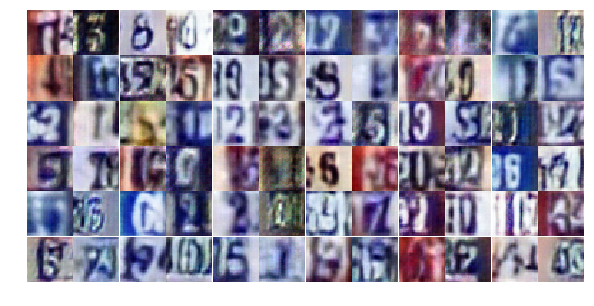

Epoch 10/25... Discriminator Loss: 0.6965... Generator Loss: 2.2799
Epoch 10/25... Discriminator Loss: 0.6219... Generator Loss: 1.4768
Epoch 10/25... Discriminator Loss: 0.4182... Generator Loss: 1.9548
Epoch 10/25... Discriminator Loss: 0.5986... Generator Loss: 1.4007
Epoch 10/25... Discriminator Loss: 0.6539... Generator Loss: 1.0708
Epoch 10/25... Discriminator Loss: 0.8612... Generator Loss: 0.7268
Epoch 10/25... Discriminator Loss: 0.8514... Generator Loss: 0.8188
Epoch 10/25... Discriminator Loss: 1.1907... Generator Loss: 0.5942
Epoch 10/25... Discriminator Loss: 0.7497... Generator Loss: 0.8481
Epoch 10/25... Discriminator Loss: 1.0143... Generator Loss: 1.1871


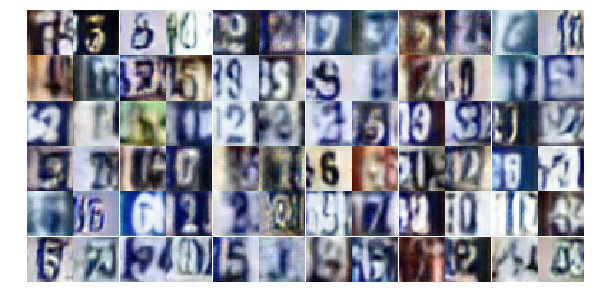

Epoch 10/25... Discriminator Loss: 0.6666... Generator Loss: 1.2342
Epoch 10/25... Discriminator Loss: 0.5990... Generator Loss: 1.6134
Epoch 10/25... Discriminator Loss: 0.4882... Generator Loss: 1.4539
Epoch 10/25... Discriminator Loss: 0.8241... Generator Loss: 0.8216
Epoch 10/25... Discriminator Loss: 0.4727... Generator Loss: 1.8608
Epoch 10/25... Discriminator Loss: 0.4606... Generator Loss: 1.5176
Epoch 10/25... Discriminator Loss: 0.6241... Generator Loss: 1.0677
Epoch 10/25... Discriminator Loss: 0.3522... Generator Loss: 2.3365
Epoch 10/25... Discriminator Loss: 0.7077... Generator Loss: 1.6000
Epoch 10/25... Discriminator Loss: 0.6657... Generator Loss: 1.1127


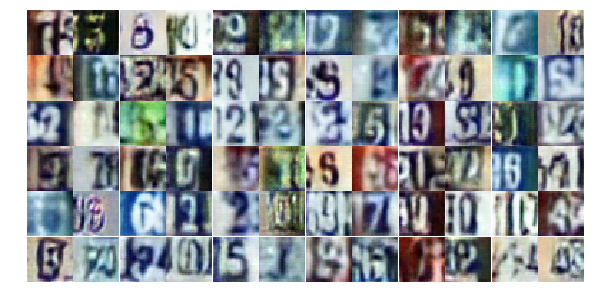

Epoch 10/25... Discriminator Loss: 0.7908... Generator Loss: 2.6738
Epoch 10/25... Discriminator Loss: 0.5577... Generator Loss: 1.3418
Epoch 10/25... Discriminator Loss: 0.4960... Generator Loss: 1.3502
Epoch 11/25... Discriminator Loss: 0.6816... Generator Loss: 1.4154
Epoch 11/25... Discriminator Loss: 0.5391... Generator Loss: 1.2155
Epoch 11/25... Discriminator Loss: 2.0217... Generator Loss: 0.1919
Epoch 11/25... Discriminator Loss: 0.7597... Generator Loss: 0.8886
Epoch 11/25... Discriminator Loss: 0.6109... Generator Loss: 1.3427
Epoch 11/25... Discriminator Loss: 1.6839... Generator Loss: 0.3265
Epoch 11/25... Discriminator Loss: 0.5442... Generator Loss: 1.6502


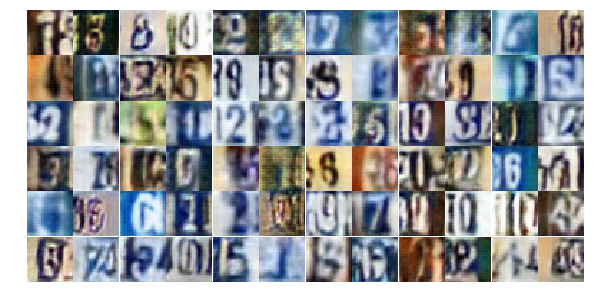

Epoch 11/25... Discriminator Loss: 0.4426... Generator Loss: 1.5258
Epoch 11/25... Discriminator Loss: 0.7082... Generator Loss: 1.0203
Epoch 11/25... Discriminator Loss: 0.4372... Generator Loss: 1.4142
Epoch 11/25... Discriminator Loss: 0.6108... Generator Loss: 1.0942
Epoch 11/25... Discriminator Loss: 0.5598... Generator Loss: 1.2131
Epoch 11/25... Discriminator Loss: 0.5778... Generator Loss: 1.1203
Epoch 11/25... Discriminator Loss: 1.5247... Generator Loss: 3.6608
Epoch 11/25... Discriminator Loss: 0.6326... Generator Loss: 1.4520
Epoch 11/25... Discriminator Loss: 0.7924... Generator Loss: 0.9348
Epoch 11/25... Discriminator Loss: 1.2304... Generator Loss: 0.4964


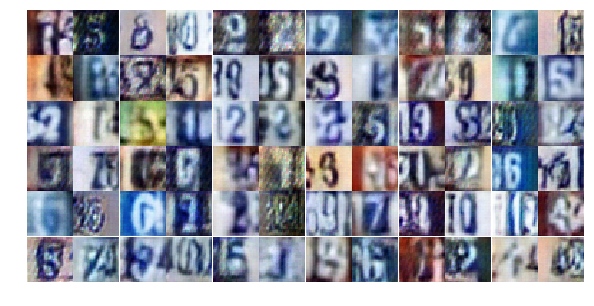

Epoch 11/25... Discriminator Loss: 0.7009... Generator Loss: 1.1398
Epoch 11/25... Discriminator Loss: 0.5531... Generator Loss: 1.8098
Epoch 11/25... Discriminator Loss: 0.8396... Generator Loss: 0.8006
Epoch 11/25... Discriminator Loss: 0.5834... Generator Loss: 1.2384
Epoch 11/25... Discriminator Loss: 0.3496... Generator Loss: 1.9758
Epoch 11/25... Discriminator Loss: 0.5474... Generator Loss: 1.2213
Epoch 11/25... Discriminator Loss: 0.6675... Generator Loss: 0.9630
Epoch 11/25... Discriminator Loss: 0.9453... Generator Loss: 0.7231
Epoch 11/25... Discriminator Loss: 0.4108... Generator Loss: 1.6831
Epoch 11/25... Discriminator Loss: 0.9486... Generator Loss: 0.7092


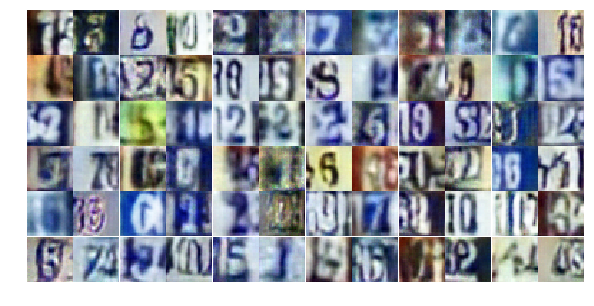

Epoch 11/25... Discriminator Loss: 0.8288... Generator Loss: 0.8216
Epoch 11/25... Discriminator Loss: 0.5992... Generator Loss: 1.1295
Epoch 11/25... Discriminator Loss: 0.7244... Generator Loss: 0.9974
Epoch 11/25... Discriminator Loss: 0.4806... Generator Loss: 1.2515
Epoch 11/25... Discriminator Loss: 0.6220... Generator Loss: 1.0665
Epoch 11/25... Discriminator Loss: 1.4707... Generator Loss: 0.3408
Epoch 11/25... Discriminator Loss: 1.5450... Generator Loss: 0.3863
Epoch 11/25... Discriminator Loss: 0.9362... Generator Loss: 0.8239
Epoch 11/25... Discriminator Loss: 0.6815... Generator Loss: 1.0073
Epoch 11/25... Discriminator Loss: 0.8908... Generator Loss: 0.7091


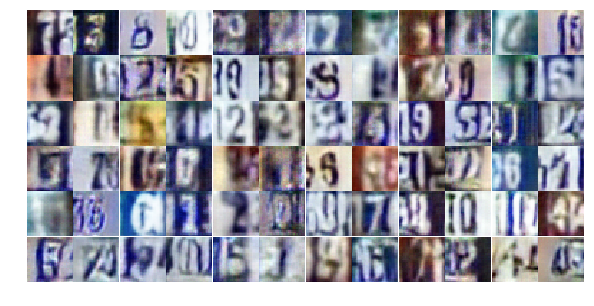

Epoch 11/25... Discriminator Loss: 0.5009... Generator Loss: 1.3018
Epoch 11/25... Discriminator Loss: 0.5018... Generator Loss: 1.3916
Epoch 11/25... Discriminator Loss: 0.7188... Generator Loss: 1.0207
Epoch 11/25... Discriminator Loss: 0.7347... Generator Loss: 0.9251
Epoch 11/25... Discriminator Loss: 0.8873... Generator Loss: 0.7205
Epoch 11/25... Discriminator Loss: 0.6426... Generator Loss: 1.1088
Epoch 11/25... Discriminator Loss: 0.3160... Generator Loss: 2.1190
Epoch 11/25... Discriminator Loss: 0.8209... Generator Loss: 0.8628
Epoch 11/25... Discriminator Loss: 1.5489... Generator Loss: 0.3484
Epoch 11/25... Discriminator Loss: 0.5508... Generator Loss: 1.2212


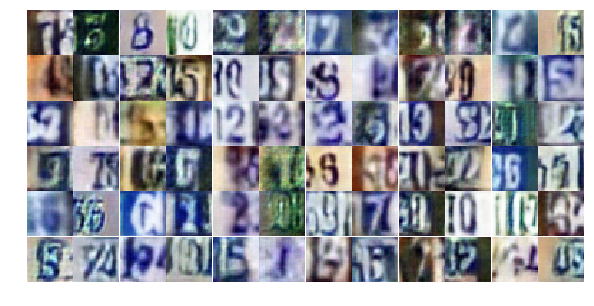

Epoch 11/25... Discriminator Loss: 0.9770... Generator Loss: 0.7267
Epoch 11/25... Discriminator Loss: 0.4054... Generator Loss: 1.6641
Epoch 11/25... Discriminator Loss: 0.5212... Generator Loss: 1.5148
Epoch 11/25... Discriminator Loss: 0.7110... Generator Loss: 0.9276
Epoch 11/25... Discriminator Loss: 2.5790... Generator Loss: 0.1500
Epoch 11/25... Discriminator Loss: 1.3219... Generator Loss: 0.5491
Epoch 11/25... Discriminator Loss: 0.5378... Generator Loss: 1.4329
Epoch 11/25... Discriminator Loss: 0.5873... Generator Loss: 1.2103
Epoch 11/25... Discriminator Loss: 0.7609... Generator Loss: 1.0002
Epoch 11/25... Discriminator Loss: 0.6461... Generator Loss: 1.2987


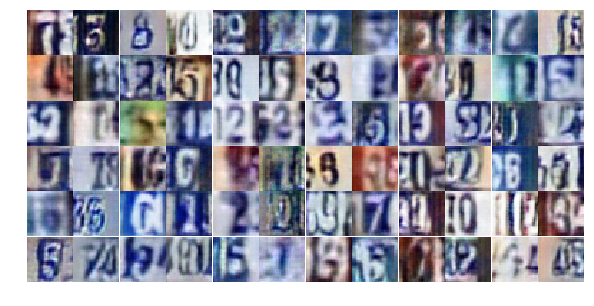

Epoch 12/25... Discriminator Loss: 0.6638... Generator Loss: 1.2380
Epoch 12/25... Discriminator Loss: 0.6504... Generator Loss: 1.2396
Epoch 12/25... Discriminator Loss: 1.0733... Generator Loss: 0.5606
Epoch 12/25... Discriminator Loss: 0.5148... Generator Loss: 1.3879
Epoch 12/25... Discriminator Loss: 0.7216... Generator Loss: 0.9577
Epoch 12/25... Discriminator Loss: 0.7624... Generator Loss: 0.8836
Epoch 12/25... Discriminator Loss: 0.6755... Generator Loss: 1.1186
Epoch 12/25... Discriminator Loss: 0.5290... Generator Loss: 1.6202
Epoch 12/25... Discriminator Loss: 0.5899... Generator Loss: 1.1953
Epoch 12/25... Discriminator Loss: 1.3358... Generator Loss: 0.4236


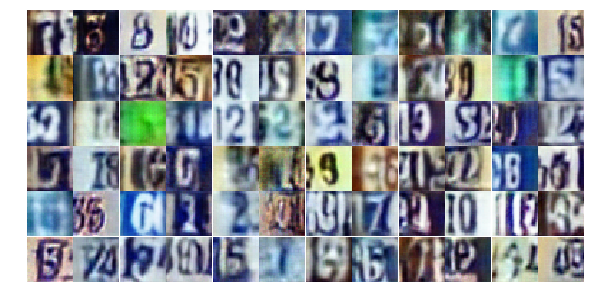

Epoch 12/25... Discriminator Loss: 0.5474... Generator Loss: 1.2302
Epoch 12/25... Discriminator Loss: 0.8727... Generator Loss: 0.8606
Epoch 12/25... Discriminator Loss: 0.5657... Generator Loss: 1.2558
Epoch 12/25... Discriminator Loss: 1.0277... Generator Loss: 2.1332
Epoch 12/25... Discriminator Loss: 0.7503... Generator Loss: 1.0239
Epoch 12/25... Discriminator Loss: 0.8484... Generator Loss: 0.7783
Epoch 12/25... Discriminator Loss: 1.0020... Generator Loss: 0.6826
Epoch 12/25... Discriminator Loss: 0.5466... Generator Loss: 1.5858
Epoch 12/25... Discriminator Loss: 0.5263... Generator Loss: 1.2913
Epoch 12/25... Discriminator Loss: 0.8440... Generator Loss: 0.8279


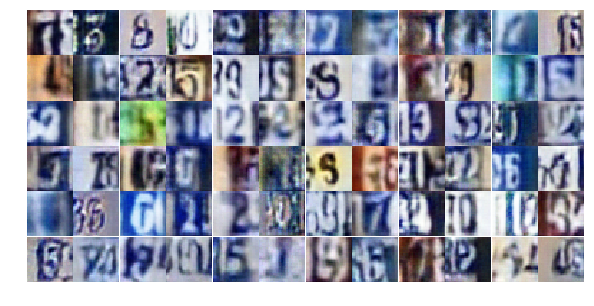

Epoch 12/25... Discriminator Loss: 0.3301... Generator Loss: 1.7936
Epoch 12/25... Discriminator Loss: 0.4860... Generator Loss: 1.1974
Epoch 12/25... Discriminator Loss: 0.5357... Generator Loss: 1.4168
Epoch 12/25... Discriminator Loss: 0.4819... Generator Loss: 2.0834
Epoch 12/25... Discriminator Loss: 0.4491... Generator Loss: 1.5108
Epoch 12/25... Discriminator Loss: 0.5906... Generator Loss: 1.1665
Epoch 12/25... Discriminator Loss: 0.7582... Generator Loss: 1.2492
Epoch 12/25... Discriminator Loss: 0.3631... Generator Loss: 1.5757
Epoch 12/25... Discriminator Loss: 0.4944... Generator Loss: 1.5926
Epoch 12/25... Discriminator Loss: 0.6349... Generator Loss: 1.0308


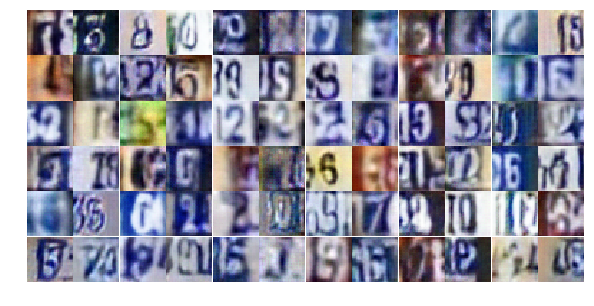

Epoch 12/25... Discriminator Loss: 0.6491... Generator Loss: 1.0643
Epoch 12/25... Discriminator Loss: 0.9572... Generator Loss: 0.7080
Epoch 12/25... Discriminator Loss: 0.8042... Generator Loss: 0.8174
Epoch 12/25... Discriminator Loss: 1.6375... Generator Loss: 0.3374
Epoch 12/25... Discriminator Loss: 0.5388... Generator Loss: 1.3483
Epoch 12/25... Discriminator Loss: 1.0687... Generator Loss: 0.6636
Epoch 12/25... Discriminator Loss: 0.8543... Generator Loss: 0.7812
Epoch 12/25... Discriminator Loss: 0.7975... Generator Loss: 0.9691
Epoch 12/25... Discriminator Loss: 0.7622... Generator Loss: 0.8279
Epoch 12/25... Discriminator Loss: 0.3865... Generator Loss: 1.5295


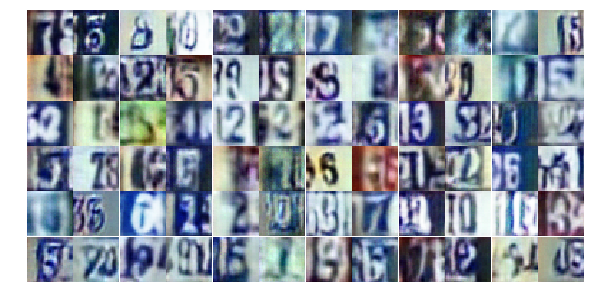

Epoch 12/25... Discriminator Loss: 0.4749... Generator Loss: 1.4886
Epoch 12/25... Discriminator Loss: 0.3201... Generator Loss: 1.7060
Epoch 12/25... Discriminator Loss: 0.3733... Generator Loss: 1.7787
Epoch 12/25... Discriminator Loss: 0.7513... Generator Loss: 1.0044
Epoch 12/25... Discriminator Loss: 0.6254... Generator Loss: 1.6606
Epoch 12/25... Discriminator Loss: 1.4507... Generator Loss: 0.4068
Epoch 12/25... Discriminator Loss: 2.0861... Generator Loss: 0.2011
Epoch 12/25... Discriminator Loss: 0.9265... Generator Loss: 0.7114
Epoch 12/25... Discriminator Loss: 0.5193... Generator Loss: 1.4442
Epoch 12/25... Discriminator Loss: 0.5126... Generator Loss: 1.3525


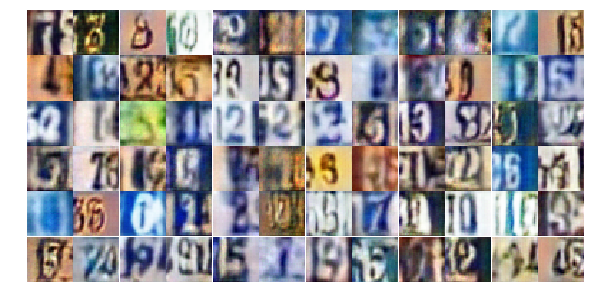

Epoch 12/25... Discriminator Loss: 0.9440... Generator Loss: 0.7672
Epoch 12/25... Discriminator Loss: 0.7432... Generator Loss: 0.8930
Epoch 12/25... Discriminator Loss: 0.5595... Generator Loss: 1.1666
Epoch 12/25... Discriminator Loss: 1.1874... Generator Loss: 0.5184
Epoch 12/25... Discriminator Loss: 0.4852... Generator Loss: 1.3387
Epoch 12/25... Discriminator Loss: 0.6421... Generator Loss: 1.3516
Epoch 12/25... Discriminator Loss: 0.9276... Generator Loss: 0.7579
Epoch 13/25... Discriminator Loss: 0.6559... Generator Loss: 1.1517
Epoch 13/25... Discriminator Loss: 0.5278... Generator Loss: 1.5977
Epoch 13/25... Discriminator Loss: 1.2961... Generator Loss: 0.4343


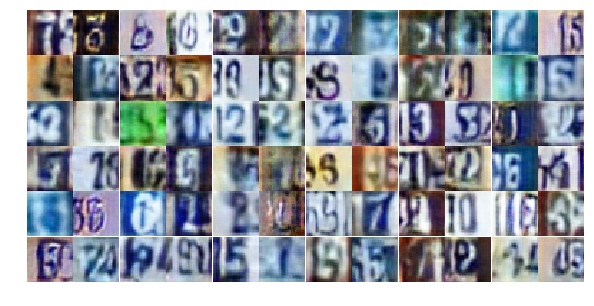

Epoch 13/25... Discriminator Loss: 0.4587... Generator Loss: 1.4053
Epoch 13/25... Discriminator Loss: 0.8258... Generator Loss: 2.5406
Epoch 13/25... Discriminator Loss: 1.5263... Generator Loss: 0.3633
Epoch 13/25... Discriminator Loss: 0.8928... Generator Loss: 0.7856
Epoch 13/25... Discriminator Loss: 0.7253... Generator Loss: 1.1012
Epoch 13/25... Discriminator Loss: 0.6687... Generator Loss: 1.0243
Epoch 13/25... Discriminator Loss: 0.3805... Generator Loss: 1.7521
Epoch 13/25... Discriminator Loss: 1.2511... Generator Loss: 0.4691
Epoch 13/25... Discriminator Loss: 0.5058... Generator Loss: 1.3107
Epoch 13/25... Discriminator Loss: 0.4705... Generator Loss: 1.8971


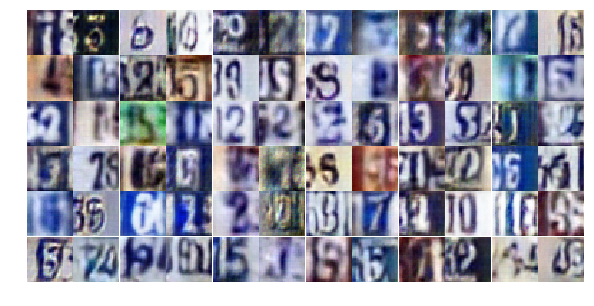

Epoch 13/25... Discriminator Loss: 0.6996... Generator Loss: 1.1439
Epoch 13/25... Discriminator Loss: 0.6532... Generator Loss: 0.9967
Epoch 13/25... Discriminator Loss: 1.2350... Generator Loss: 0.4904
Epoch 13/25... Discriminator Loss: 0.7751... Generator Loss: 0.9873
Epoch 13/25... Discriminator Loss: 0.5746... Generator Loss: 1.5519
Epoch 13/25... Discriminator Loss: 0.8912... Generator Loss: 0.8699
Epoch 13/25... Discriminator Loss: 0.6161... Generator Loss: 1.2837
Epoch 13/25... Discriminator Loss: 1.4101... Generator Loss: 0.3976
Epoch 13/25... Discriminator Loss: 0.6790... Generator Loss: 1.4305
Epoch 13/25... Discriminator Loss: 0.9001... Generator Loss: 0.7219


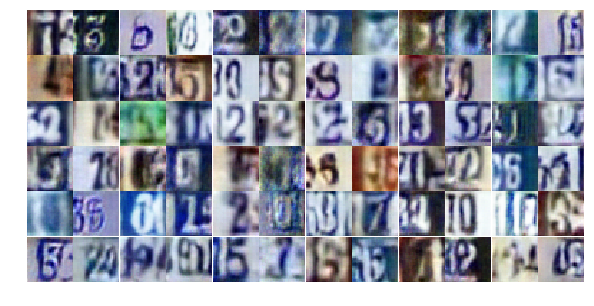

Epoch 13/25... Discriminator Loss: 0.8493... Generator Loss: 0.7726
Epoch 13/25... Discriminator Loss: 0.6594... Generator Loss: 1.2892
Epoch 13/25... Discriminator Loss: 0.7807... Generator Loss: 0.8762
Epoch 13/25... Discriminator Loss: 0.6754... Generator Loss: 1.0042
Epoch 13/25... Discriminator Loss: 0.7328... Generator Loss: 0.8709
Epoch 13/25... Discriminator Loss: 0.7087... Generator Loss: 1.1822
Epoch 13/25... Discriminator Loss: 0.8603... Generator Loss: 0.9222
Epoch 13/25... Discriminator Loss: 0.4758... Generator Loss: 1.4477
Epoch 13/25... Discriminator Loss: 0.6599... Generator Loss: 1.0523
Epoch 13/25... Discriminator Loss: 0.5464... Generator Loss: 1.3430


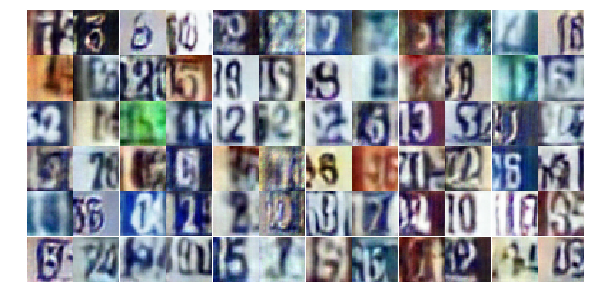

Epoch 13/25... Discriminator Loss: 0.8069... Generator Loss: 0.8724
Epoch 13/25... Discriminator Loss: 0.7859... Generator Loss: 1.0177
Epoch 13/25... Discriminator Loss: 1.0365... Generator Loss: 0.6008
Epoch 13/25... Discriminator Loss: 1.3456... Generator Loss: 0.4326
Epoch 13/25... Discriminator Loss: 0.7781... Generator Loss: 0.8677
Epoch 13/25... Discriminator Loss: 0.4260... Generator Loss: 1.8492
Epoch 13/25... Discriminator Loss: 0.4947... Generator Loss: 1.3601
Epoch 13/25... Discriminator Loss: 1.4680... Generator Loss: 0.4124
Epoch 13/25... Discriminator Loss: 0.8001... Generator Loss: 0.8254
Epoch 13/25... Discriminator Loss: 0.8119... Generator Loss: 0.8289


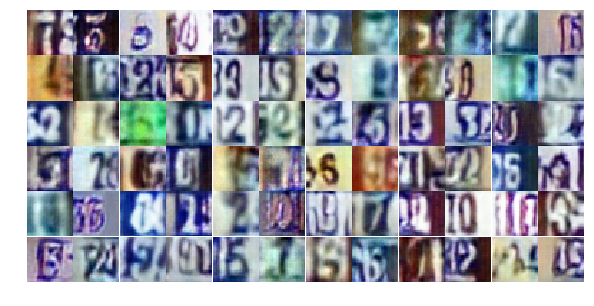

Epoch 13/25... Discriminator Loss: 0.6126... Generator Loss: 1.4191
Epoch 13/25... Discriminator Loss: 0.6650... Generator Loss: 1.0227
Epoch 13/25... Discriminator Loss: 0.9473... Generator Loss: 0.7181
Epoch 13/25... Discriminator Loss: 0.9830... Generator Loss: 0.7130
Epoch 13/25... Discriminator Loss: 0.9944... Generator Loss: 0.7060
Epoch 13/25... Discriminator Loss: 0.6422... Generator Loss: 1.3098
Epoch 13/25... Discriminator Loss: 0.7029... Generator Loss: 0.9576
Epoch 13/25... Discriminator Loss: 0.8436... Generator Loss: 0.7760
Epoch 13/25... Discriminator Loss: 0.9040... Generator Loss: 0.7403
Epoch 13/25... Discriminator Loss: 4.1560... Generator Loss: 0.0349


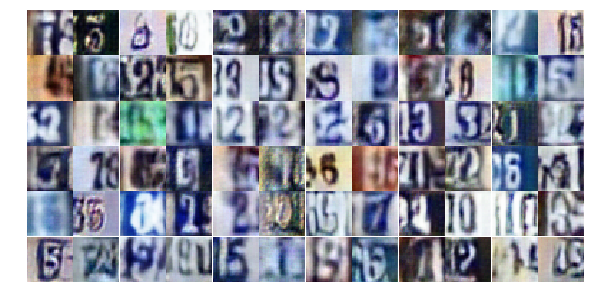

Epoch 13/25... Discriminator Loss: 0.3234... Generator Loss: 2.1506
Epoch 13/25... Discriminator Loss: 0.8832... Generator Loss: 0.8249
Epoch 13/25... Discriminator Loss: 0.6110... Generator Loss: 1.3529
Epoch 13/25... Discriminator Loss: 0.7257... Generator Loss: 1.0448
Epoch 14/25... Discriminator Loss: 0.9892... Generator Loss: 0.6925
Epoch 14/25... Discriminator Loss: 0.7491... Generator Loss: 1.1159
Epoch 14/25... Discriminator Loss: 0.9273... Generator Loss: 0.7807
Epoch 14/25... Discriminator Loss: 0.6135... Generator Loss: 1.3312
Epoch 14/25... Discriminator Loss: 0.6761... Generator Loss: 1.0744
Epoch 14/25... Discriminator Loss: 0.6406... Generator Loss: 1.2333


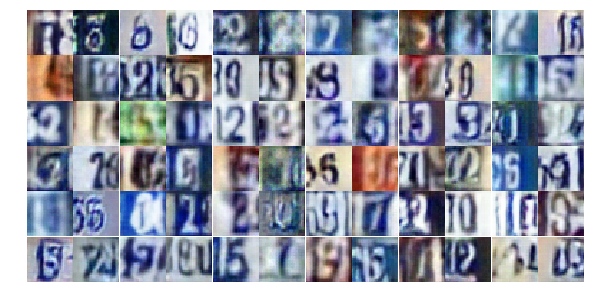

Epoch 14/25... Discriminator Loss: 0.7329... Generator Loss: 1.5970
Epoch 14/25... Discriminator Loss: 0.6294... Generator Loss: 0.9777
Epoch 14/25... Discriminator Loss: 0.9859... Generator Loss: 0.7300
Epoch 14/25... Discriminator Loss: 0.7207... Generator Loss: 1.0967
Epoch 14/25... Discriminator Loss: 1.4214... Generator Loss: 0.3999
Epoch 14/25... Discriminator Loss: 0.3323... Generator Loss: 1.7303
Epoch 14/25... Discriminator Loss: 0.3589... Generator Loss: 1.9377
Epoch 14/25... Discriminator Loss: 1.3642... Generator Loss: 0.4293
Epoch 14/25... Discriminator Loss: 1.3141... Generator Loss: 0.4248
Epoch 14/25... Discriminator Loss: 1.3013... Generator Loss: 0.4512


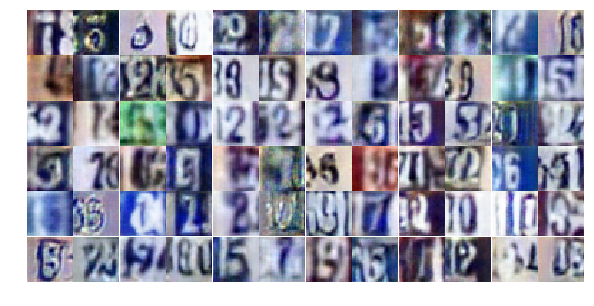

Epoch 14/25... Discriminator Loss: 0.5172... Generator Loss: 1.2080
Epoch 14/25... Discriminator Loss: 0.5303... Generator Loss: 2.2047
Epoch 14/25... Discriminator Loss: 0.8495... Generator Loss: 0.8661
Epoch 14/25... Discriminator Loss: 0.5096... Generator Loss: 1.5624
Epoch 14/25... Discriminator Loss: 1.2902... Generator Loss: 2.4168
Epoch 14/25... Discriminator Loss: 1.1419... Generator Loss: 0.5038
Epoch 14/25... Discriminator Loss: 0.7580... Generator Loss: 0.9396
Epoch 14/25... Discriminator Loss: 0.5455... Generator Loss: 1.3256
Epoch 14/25... Discriminator Loss: 0.6172... Generator Loss: 1.1378
Epoch 14/25... Discriminator Loss: 0.4249... Generator Loss: 1.6437


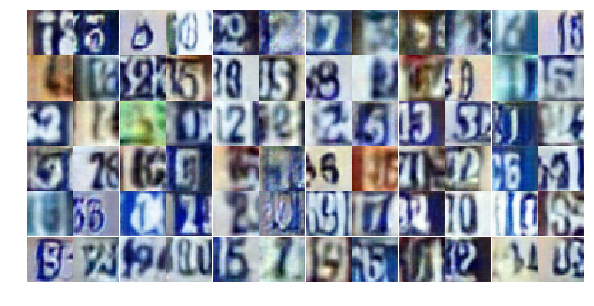

Epoch 14/25... Discriminator Loss: 1.5290... Generator Loss: 0.3660
Epoch 14/25... Discriminator Loss: 0.4903... Generator Loss: 1.4382
Epoch 14/25... Discriminator Loss: 0.6202... Generator Loss: 1.1040
Epoch 14/25... Discriminator Loss: 0.4457... Generator Loss: 1.3557
Epoch 14/25... Discriminator Loss: 0.7693... Generator Loss: 0.9386
Epoch 14/25... Discriminator Loss: 0.4379... Generator Loss: 1.5782
Epoch 14/25... Discriminator Loss: 1.0091... Generator Loss: 0.6543
Epoch 14/25... Discriminator Loss: 0.4600... Generator Loss: 1.3426
Epoch 14/25... Discriminator Loss: 0.3986... Generator Loss: 2.4883
Epoch 14/25... Discriminator Loss: 1.4551... Generator Loss: 1.7294


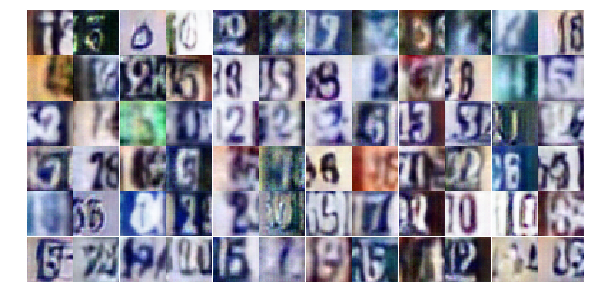

Epoch 14/25... Discriminator Loss: 1.6786... Generator Loss: 0.2907
Epoch 14/25... Discriminator Loss: 1.0417... Generator Loss: 0.6091
Epoch 14/25... Discriminator Loss: 1.0220... Generator Loss: 0.6210
Epoch 14/25... Discriminator Loss: 0.9029... Generator Loss: 0.7526
Epoch 14/25... Discriminator Loss: 0.8610... Generator Loss: 0.8120
Epoch 14/25... Discriminator Loss: 0.7487... Generator Loss: 0.9485
Epoch 14/25... Discriminator Loss: 0.6181... Generator Loss: 1.5314
Epoch 14/25... Discriminator Loss: 0.6077... Generator Loss: 1.5867
Epoch 14/25... Discriminator Loss: 0.9523... Generator Loss: 0.7430
Epoch 14/25... Discriminator Loss: 1.1634... Generator Loss: 0.5611


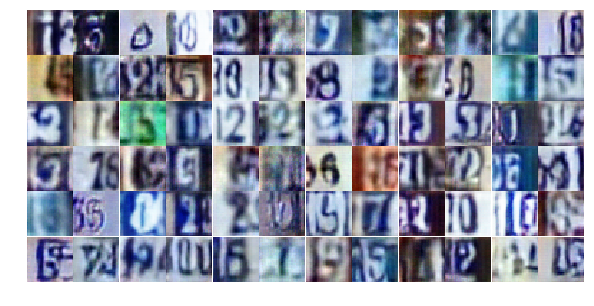

Epoch 14/25... Discriminator Loss: 0.9232... Generator Loss: 0.8425
Epoch 14/25... Discriminator Loss: 1.7261... Generator Loss: 0.3010
Epoch 14/25... Discriminator Loss: 0.6160... Generator Loss: 1.2477
Epoch 14/25... Discriminator Loss: 1.0008... Generator Loss: 0.6797
Epoch 14/25... Discriminator Loss: 0.6095... Generator Loss: 1.1619
Epoch 14/25... Discriminator Loss: 0.7566... Generator Loss: 0.8845
Epoch 14/25... Discriminator Loss: 0.9922... Generator Loss: 1.6429
Epoch 14/25... Discriminator Loss: 0.8360... Generator Loss: 1.2684
Epoch 14/25... Discriminator Loss: 1.0272... Generator Loss: 0.6283
Epoch 14/25... Discriminator Loss: 0.9215... Generator Loss: 0.7233


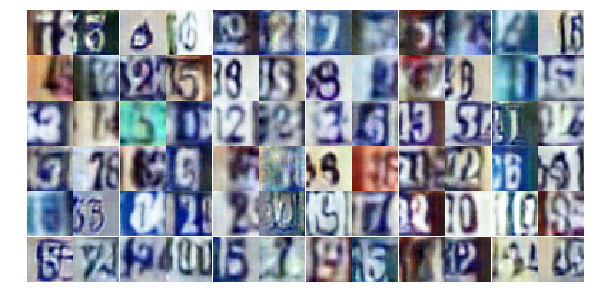

Epoch 14/25... Discriminator Loss: 0.7605... Generator Loss: 1.1250
Epoch 14/25... Discriminator Loss: 0.9974... Generator Loss: 0.6663
Epoch 15/25... Discriminator Loss: 1.0069... Generator Loss: 0.6374
Epoch 15/25... Discriminator Loss: 0.4468... Generator Loss: 1.3938
Epoch 15/25... Discriminator Loss: 0.6789... Generator Loss: 0.9510
Epoch 15/25... Discriminator Loss: 0.9628... Generator Loss: 0.7760
Epoch 15/25... Discriminator Loss: 1.2165... Generator Loss: 0.4615
Epoch 15/25... Discriminator Loss: 0.5778... Generator Loss: 1.6636
Epoch 15/25... Discriminator Loss: 1.1308... Generator Loss: 0.5639
Epoch 15/25... Discriminator Loss: 0.8052... Generator Loss: 0.7986


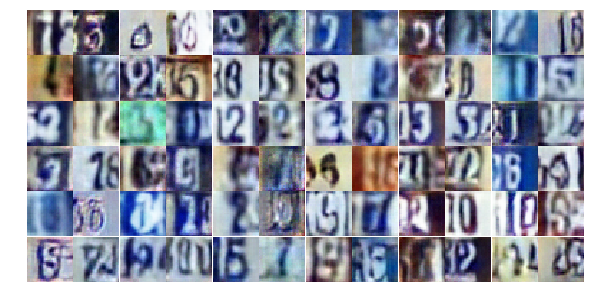

Epoch 15/25... Discriminator Loss: 0.7367... Generator Loss: 0.9686
Epoch 15/25... Discriminator Loss: 0.6891... Generator Loss: 1.5710
Epoch 15/25... Discriminator Loss: 0.8462... Generator Loss: 0.9029
Epoch 15/25... Discriminator Loss: 0.5427... Generator Loss: 1.4602
Epoch 15/25... Discriminator Loss: 1.6277... Generator Loss: 0.3491
Epoch 15/25... Discriminator Loss: 0.8080... Generator Loss: 2.7912
Epoch 15/25... Discriminator Loss: 1.1595... Generator Loss: 0.5848
Epoch 15/25... Discriminator Loss: 0.5848... Generator Loss: 1.5500
Epoch 15/25... Discriminator Loss: 0.5976... Generator Loss: 1.7501
Epoch 15/25... Discriminator Loss: 0.7546... Generator Loss: 0.8646


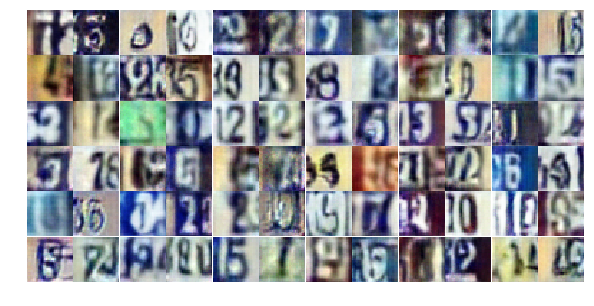

Epoch 15/25... Discriminator Loss: 0.7843... Generator Loss: 0.9052
Epoch 15/25... Discriminator Loss: 0.6483... Generator Loss: 1.1449
Epoch 15/25... Discriminator Loss: 0.5198... Generator Loss: 1.3907
Epoch 15/25... Discriminator Loss: 1.0715... Generator Loss: 0.6042
Epoch 15/25... Discriminator Loss: 0.8587... Generator Loss: 0.8565
Epoch 15/25... Discriminator Loss: 0.4945... Generator Loss: 1.4979
Epoch 15/25... Discriminator Loss: 1.6670... Generator Loss: 0.3584
Epoch 15/25... Discriminator Loss: 0.8627... Generator Loss: 0.8801
Epoch 15/25... Discriminator Loss: 0.4035... Generator Loss: 1.7512
Epoch 15/25... Discriminator Loss: 1.6310... Generator Loss: 0.3423


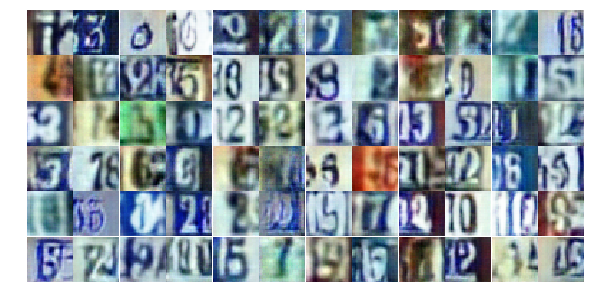

Epoch 15/25... Discriminator Loss: 0.4897... Generator Loss: 1.4604
Epoch 15/25... Discriminator Loss: 0.5394... Generator Loss: 1.3993
Epoch 15/25... Discriminator Loss: 0.5246... Generator Loss: 1.2755
Epoch 15/25... Discriminator Loss: 0.5982... Generator Loss: 1.2308
Epoch 15/25... Discriminator Loss: 0.5521... Generator Loss: 1.1445
Epoch 15/25... Discriminator Loss: 0.9436... Generator Loss: 2.1142
Epoch 15/25... Discriminator Loss: 0.5208... Generator Loss: 1.5311
Epoch 15/25... Discriminator Loss: 0.9387... Generator Loss: 0.8548
Epoch 15/25... Discriminator Loss: 0.5412... Generator Loss: 1.4553
Epoch 15/25... Discriminator Loss: 0.7999... Generator Loss: 1.0482


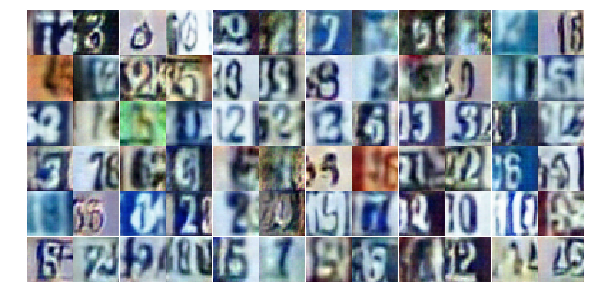

Epoch 15/25... Discriminator Loss: 0.4430... Generator Loss: 1.3599
Epoch 15/25... Discriminator Loss: 1.5338... Generator Loss: 0.3373
Epoch 15/25... Discriminator Loss: 0.8509... Generator Loss: 0.7798
Epoch 15/25... Discriminator Loss: 0.4882... Generator Loss: 1.3973
Epoch 15/25... Discriminator Loss: 0.4334... Generator Loss: 1.6736
Epoch 15/25... Discriminator Loss: 1.8482... Generator Loss: 0.2748
Epoch 15/25... Discriminator Loss: 0.6826... Generator Loss: 1.3729
Epoch 15/25... Discriminator Loss: 0.9020... Generator Loss: 1.4023
Epoch 15/25... Discriminator Loss: 0.7982... Generator Loss: 0.8260
Epoch 15/25... Discriminator Loss: 0.7886... Generator Loss: 0.9224


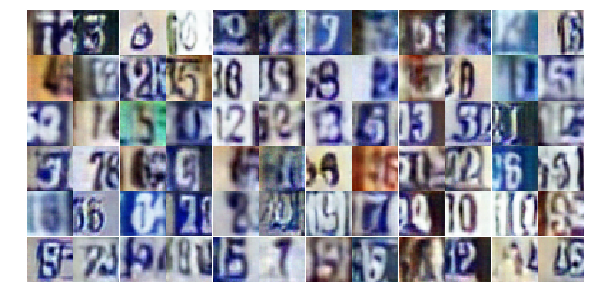

Epoch 15/25... Discriminator Loss: 1.0162... Generator Loss: 0.6566
Epoch 15/25... Discriminator Loss: 0.9195... Generator Loss: 0.7795
Epoch 15/25... Discriminator Loss: 0.4635... Generator Loss: 1.7235
Epoch 15/25... Discriminator Loss: 0.9345... Generator Loss: 0.7368
Epoch 15/25... Discriminator Loss: 0.5654... Generator Loss: 1.1849
Epoch 15/25... Discriminator Loss: 0.7913... Generator Loss: 1.5501
Epoch 15/25... Discriminator Loss: 1.0085... Generator Loss: 0.6215
Epoch 15/25... Discriminator Loss: 0.6441... Generator Loss: 1.2030
Epoch 15/25... Discriminator Loss: 1.9795... Generator Loss: 0.2178
Epoch 16/25... Discriminator Loss: 1.6169... Generator Loss: 0.3221


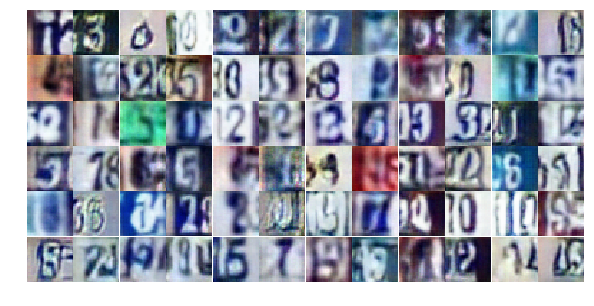

Epoch 16/25... Discriminator Loss: 0.5877... Generator Loss: 1.1624
Epoch 16/25... Discriminator Loss: 0.9569... Generator Loss: 0.6778
Epoch 16/25... Discriminator Loss: 0.9285... Generator Loss: 0.7851
Epoch 16/25... Discriminator Loss: 0.4142... Generator Loss: 1.7576
Epoch 16/25... Discriminator Loss: 0.6170... Generator Loss: 2.0587
Epoch 16/25... Discriminator Loss: 0.6869... Generator Loss: 1.0246
Epoch 16/25... Discriminator Loss: 1.6099... Generator Loss: 0.3098
Epoch 16/25... Discriminator Loss: 1.0392... Generator Loss: 0.6475
Epoch 16/25... Discriminator Loss: 0.6287... Generator Loss: 1.0515
Epoch 16/25... Discriminator Loss: 0.5585... Generator Loss: 1.1546


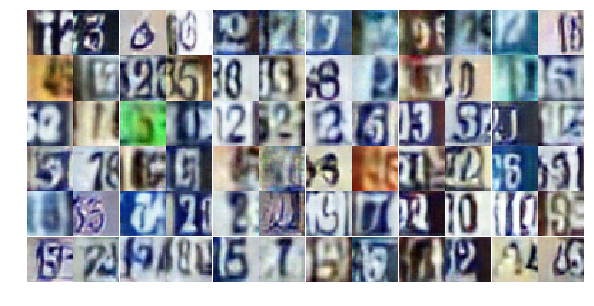

Epoch 16/25... Discriminator Loss: 1.0300... Generator Loss: 0.6479
Epoch 16/25... Discriminator Loss: 0.5480... Generator Loss: 1.3292
Epoch 16/25... Discriminator Loss: 0.7115... Generator Loss: 1.1268
Epoch 16/25... Discriminator Loss: 1.5272... Generator Loss: 0.3866
Epoch 16/25... Discriminator Loss: 0.4763... Generator Loss: 1.5924
Epoch 16/25... Discriminator Loss: 0.7892... Generator Loss: 1.0879
Epoch 16/25... Discriminator Loss: 1.6020... Generator Loss: 2.0783
Epoch 16/25... Discriminator Loss: 0.6510... Generator Loss: 1.6879
Epoch 16/25... Discriminator Loss: 0.5636... Generator Loss: 1.2444
Epoch 16/25... Discriminator Loss: 0.7733... Generator Loss: 1.0986


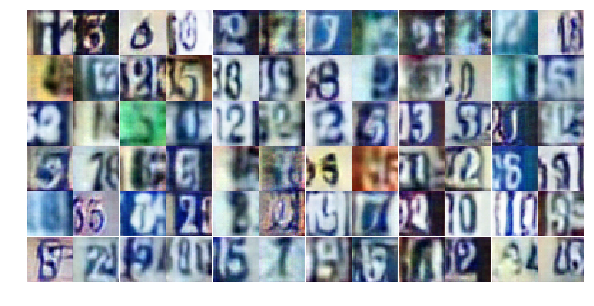

Epoch 16/25... Discriminator Loss: 0.7381... Generator Loss: 1.0773
Epoch 16/25... Discriminator Loss: 0.6979... Generator Loss: 0.9495
Epoch 16/25... Discriminator Loss: 0.8706... Generator Loss: 0.8019
Epoch 16/25... Discriminator Loss: 0.9326... Generator Loss: 0.6365
Epoch 16/25... Discriminator Loss: 0.7199... Generator Loss: 0.9785
Epoch 16/25... Discriminator Loss: 0.9030... Generator Loss: 0.7512
Epoch 16/25... Discriminator Loss: 0.7900... Generator Loss: 0.8479
Epoch 16/25... Discriminator Loss: 0.5103... Generator Loss: 1.2285
Epoch 16/25... Discriminator Loss: 0.7645... Generator Loss: 1.0377
Epoch 16/25... Discriminator Loss: 0.6891... Generator Loss: 0.9314


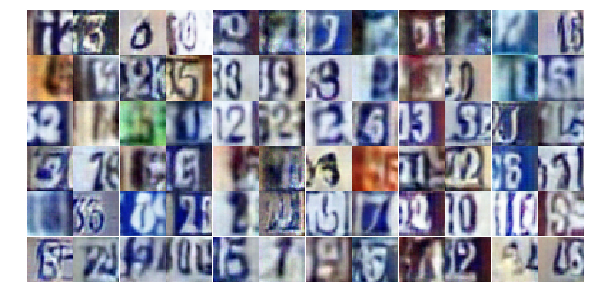

Epoch 16/25... Discriminator Loss: 0.6578... Generator Loss: 1.2232
Epoch 16/25... Discriminator Loss: 0.6906... Generator Loss: 0.9929
Epoch 16/25... Discriminator Loss: 0.6495... Generator Loss: 1.0289
Epoch 16/25... Discriminator Loss: 1.4929... Generator Loss: 0.4577
Epoch 16/25... Discriminator Loss: 0.8106... Generator Loss: 1.2208
Epoch 16/25... Discriminator Loss: 0.6627... Generator Loss: 1.1969
Epoch 16/25... Discriminator Loss: 0.8808... Generator Loss: 0.8040
Epoch 16/25... Discriminator Loss: 1.1791... Generator Loss: 0.5600
Epoch 16/25... Discriminator Loss: 0.8756... Generator Loss: 0.7716
Epoch 16/25... Discriminator Loss: 0.4301... Generator Loss: 1.7216


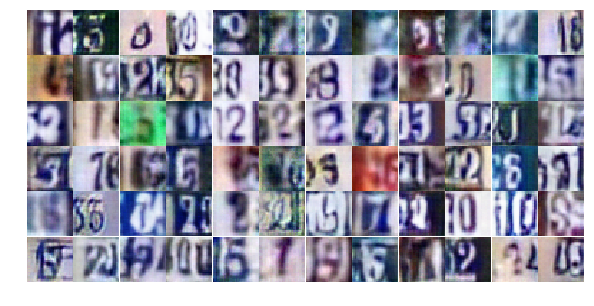

Epoch 16/25... Discriminator Loss: 0.5720... Generator Loss: 1.2879
Epoch 16/25... Discriminator Loss: 0.6399... Generator Loss: 1.0786
Epoch 16/25... Discriminator Loss: 1.1509... Generator Loss: 0.6057
Epoch 16/25... Discriminator Loss: 1.4117... Generator Loss: 0.5162
Epoch 16/25... Discriminator Loss: 0.6101... Generator Loss: 1.1842
Epoch 16/25... Discriminator Loss: 1.0253... Generator Loss: 0.6563
Epoch 16/25... Discriminator Loss: 0.5093... Generator Loss: 1.4352
Epoch 16/25... Discriminator Loss: 0.9875... Generator Loss: 0.6632
Epoch 16/25... Discriminator Loss: 0.4929... Generator Loss: 1.4027
Epoch 16/25... Discriminator Loss: 0.8553... Generator Loss: 0.7814


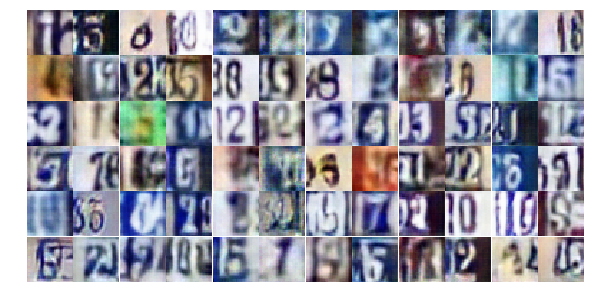

Epoch 16/25... Discriminator Loss: 1.4614... Generator Loss: 0.3708
Epoch 16/25... Discriminator Loss: 0.6880... Generator Loss: 0.9612
Epoch 16/25... Discriminator Loss: 1.1609... Generator Loss: 0.5773
Epoch 16/25... Discriminator Loss: 0.5720... Generator Loss: 2.1699
Epoch 16/25... Discriminator Loss: 0.6268... Generator Loss: 1.1212
Epoch 16/25... Discriminator Loss: 0.4790... Generator Loss: 1.6581
Epoch 17/25... Discriminator Loss: 0.8896... Generator Loss: 0.7994
Epoch 17/25... Discriminator Loss: 0.9124... Generator Loss: 0.7783
Epoch 17/25... Discriminator Loss: 0.6554... Generator Loss: 1.2249
Epoch 17/25... Discriminator Loss: 0.7302... Generator Loss: 0.8741


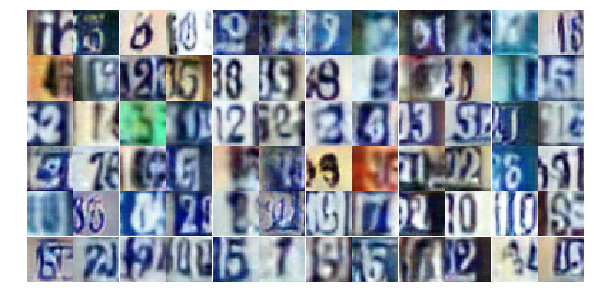

Epoch 17/25... Discriminator Loss: 0.6606... Generator Loss: 1.0544
Epoch 17/25... Discriminator Loss: 0.5232... Generator Loss: 1.1682
Epoch 17/25... Discriminator Loss: 0.8200... Generator Loss: 1.1126
Epoch 17/25... Discriminator Loss: 0.6783... Generator Loss: 1.1876
Epoch 17/25... Discriminator Loss: 1.1060... Generator Loss: 0.5802
Epoch 17/25... Discriminator Loss: 1.1423... Generator Loss: 0.5196
Epoch 17/25... Discriminator Loss: 1.2346... Generator Loss: 0.5162
Epoch 17/25... Discriminator Loss: 0.6491... Generator Loss: 1.0637
Epoch 17/25... Discriminator Loss: 0.2954... Generator Loss: 2.1764
Epoch 17/25... Discriminator Loss: 0.6639... Generator Loss: 1.3625


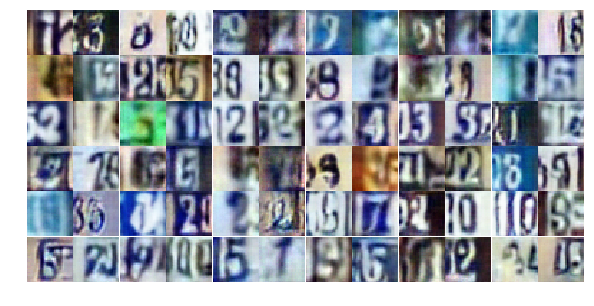

Epoch 17/25... Discriminator Loss: 0.8593... Generator Loss: 1.0211
Epoch 17/25... Discriminator Loss: 0.7277... Generator Loss: 1.0278
Epoch 17/25... Discriminator Loss: 0.7337... Generator Loss: 0.9614
Epoch 17/25... Discriminator Loss: 2.0811... Generator Loss: 0.2042
Epoch 17/25... Discriminator Loss: 1.2892... Generator Loss: 0.7118
Epoch 17/25... Discriminator Loss: 0.7869... Generator Loss: 1.0906
Epoch 17/25... Discriminator Loss: 0.5916... Generator Loss: 1.2583
Epoch 17/25... Discriminator Loss: 0.5728... Generator Loss: 1.4358
Epoch 17/25... Discriminator Loss: 0.6890... Generator Loss: 1.0216
Epoch 17/25... Discriminator Loss: 0.7051... Generator Loss: 0.9864


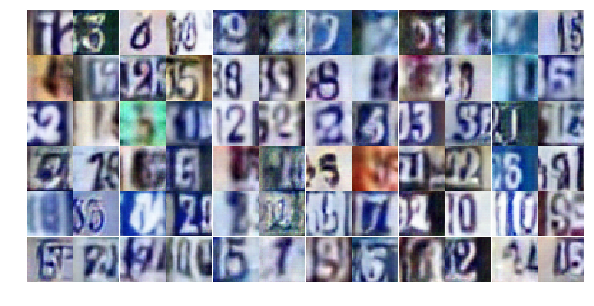

Epoch 17/25... Discriminator Loss: 1.7661... Generator Loss: 0.2676
Epoch 17/25... Discriminator Loss: 0.7208... Generator Loss: 1.0917
Epoch 17/25... Discriminator Loss: 0.7770... Generator Loss: 0.8768
Epoch 17/25... Discriminator Loss: 1.0555... Generator Loss: 0.7253
Epoch 17/25... Discriminator Loss: 0.8323... Generator Loss: 0.8146
Epoch 17/25... Discriminator Loss: 0.6841... Generator Loss: 0.9496
Epoch 17/25... Discriminator Loss: 0.8586... Generator Loss: 0.7982
Epoch 17/25... Discriminator Loss: 0.8323... Generator Loss: 0.7650
Epoch 17/25... Discriminator Loss: 0.6655... Generator Loss: 1.1853
Epoch 17/25... Discriminator Loss: 0.3671... Generator Loss: 1.7750


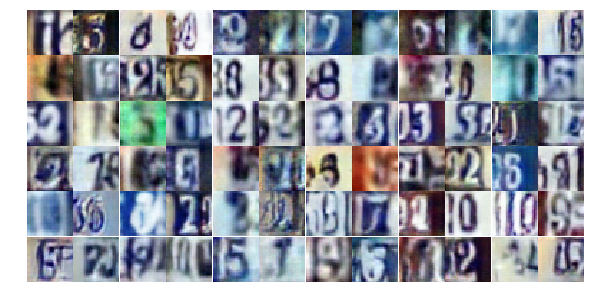

Epoch 17/25... Discriminator Loss: 1.8997... Generator Loss: 0.3129
Epoch 17/25... Discriminator Loss: 1.9331... Generator Loss: 0.2930
Epoch 17/25... Discriminator Loss: 0.7844... Generator Loss: 1.0082
Epoch 17/25... Discriminator Loss: 0.8107... Generator Loss: 0.9681
Epoch 17/25... Discriminator Loss: 1.0149... Generator Loss: 0.6291
Epoch 17/25... Discriminator Loss: 0.7211... Generator Loss: 1.3340
Epoch 17/25... Discriminator Loss: 1.0118... Generator Loss: 0.8913
Epoch 17/25... Discriminator Loss: 0.5159... Generator Loss: 1.3955
Epoch 17/25... Discriminator Loss: 0.3199... Generator Loss: 2.0714
Epoch 17/25... Discriminator Loss: 1.0185... Generator Loss: 0.6741


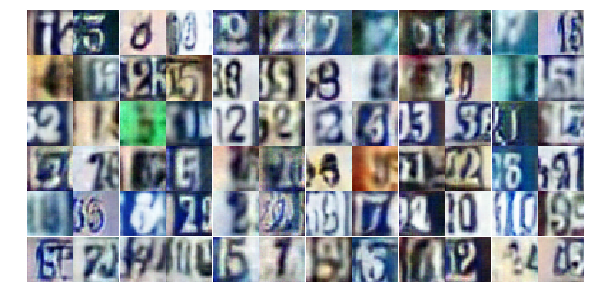

Epoch 17/25... Discriminator Loss: 0.7044... Generator Loss: 1.3139
Epoch 17/25... Discriminator Loss: 0.3043... Generator Loss: 2.5068
Epoch 17/25... Discriminator Loss: 1.1196... Generator Loss: 0.6747
Epoch 17/25... Discriminator Loss: 0.4334... Generator Loss: 2.4219
Epoch 17/25... Discriminator Loss: 0.8441... Generator Loss: 0.8240
Epoch 17/25... Discriminator Loss: 0.9765... Generator Loss: 0.7055
Epoch 17/25... Discriminator Loss: 1.5325... Generator Loss: 0.3712
Epoch 17/25... Discriminator Loss: 0.6733... Generator Loss: 1.0312
Epoch 17/25... Discriminator Loss: 0.6265... Generator Loss: 1.7317
Epoch 17/25... Discriminator Loss: 1.7535... Generator Loss: 0.2973


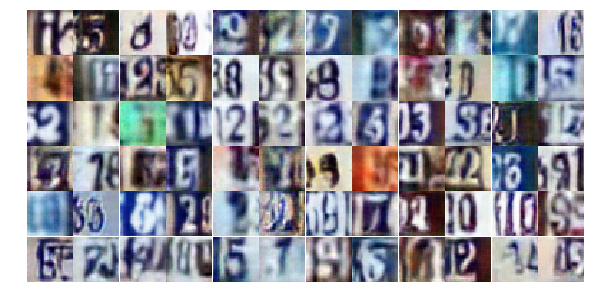

Epoch 17/25... Discriminator Loss: 1.0940... Generator Loss: 0.6314
Epoch 17/25... Discriminator Loss: 1.0202... Generator Loss: 0.6932
Epoch 17/25... Discriminator Loss: 0.7318... Generator Loss: 1.0423
Epoch 17/25... Discriminator Loss: 0.5113... Generator Loss: 1.6057
Epoch 18/25... Discriminator Loss: 1.4091... Generator Loss: 0.4318
Epoch 18/25... Discriminator Loss: 1.4209... Generator Loss: 0.3755
Epoch 18/25... Discriminator Loss: 0.8290... Generator Loss: 0.8720
Epoch 18/25... Discriminator Loss: 0.6208... Generator Loss: 1.0882
Epoch 18/25... Discriminator Loss: 0.8203... Generator Loss: 0.9127
Epoch 18/25... Discriminator Loss: 0.7354... Generator Loss: 1.0732


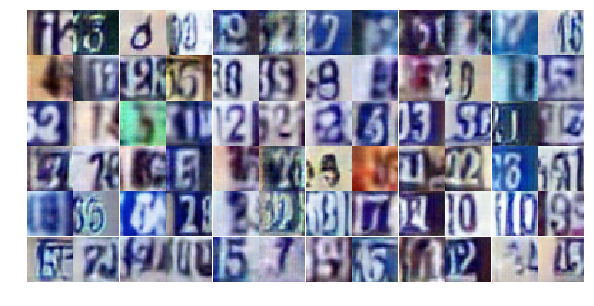

Epoch 18/25... Discriminator Loss: 0.4565... Generator Loss: 1.6550
Epoch 18/25... Discriminator Loss: 0.9390... Generator Loss: 0.7617
Epoch 18/25... Discriminator Loss: 1.1213... Generator Loss: 0.5544
Epoch 18/25... Discriminator Loss: 0.4389... Generator Loss: 2.0941
Epoch 18/25... Discriminator Loss: 0.7983... Generator Loss: 0.8452
Epoch 18/25... Discriminator Loss: 1.1669... Generator Loss: 0.6050
Epoch 18/25... Discriminator Loss: 0.5814... Generator Loss: 1.2894
Epoch 18/25... Discriminator Loss: 0.8957... Generator Loss: 0.7536
Epoch 18/25... Discriminator Loss: 0.7219... Generator Loss: 1.4649
Epoch 18/25... Discriminator Loss: 0.3049... Generator Loss: 1.8712


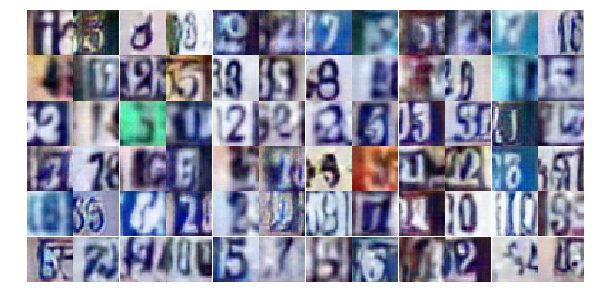

Epoch 18/25... Discriminator Loss: 1.1519... Generator Loss: 0.5851
Epoch 18/25... Discriminator Loss: 0.8120... Generator Loss: 0.8341
Epoch 18/25... Discriminator Loss: 1.2235... Generator Loss: 0.5549
Epoch 18/25... Discriminator Loss: 0.8911... Generator Loss: 0.7744
Epoch 18/25... Discriminator Loss: 1.1453... Generator Loss: 0.5209
Epoch 18/25... Discriminator Loss: 1.0589... Generator Loss: 0.6256
Epoch 18/25... Discriminator Loss: 0.8633... Generator Loss: 0.8614
Epoch 18/25... Discriminator Loss: 1.6278... Generator Loss: 0.4176
Epoch 18/25... Discriminator Loss: 0.8065... Generator Loss: 0.8837
Epoch 18/25... Discriminator Loss: 0.5149... Generator Loss: 1.2129


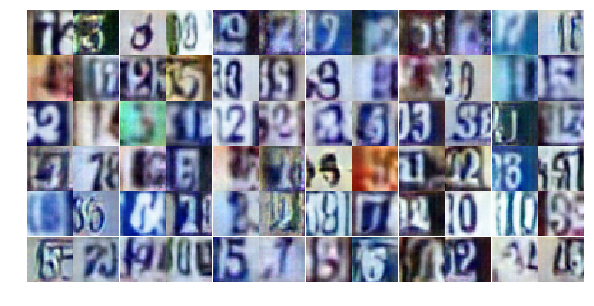

Epoch 18/25... Discriminator Loss: 0.4709... Generator Loss: 1.4977
Epoch 18/25... Discriminator Loss: 0.6022... Generator Loss: 1.9687
Epoch 18/25... Discriminator Loss: 0.9761... Generator Loss: 0.6979
Epoch 18/25... Discriminator Loss: 0.7947... Generator Loss: 0.8472
Epoch 18/25... Discriminator Loss: 0.9866... Generator Loss: 0.7082
Epoch 18/25... Discriminator Loss: 0.6724... Generator Loss: 1.1195
Epoch 18/25... Discriminator Loss: 1.0084... Generator Loss: 0.6847
Epoch 18/25... Discriminator Loss: 0.4804... Generator Loss: 1.5863
Epoch 18/25... Discriminator Loss: 1.0490... Generator Loss: 0.6335
Epoch 18/25... Discriminator Loss: 0.7138... Generator Loss: 1.1011


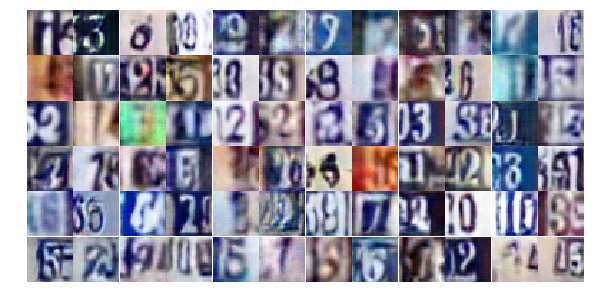

Epoch 18/25... Discriminator Loss: 0.7093... Generator Loss: 0.9640
Epoch 18/25... Discriminator Loss: 0.5724... Generator Loss: 1.2125
Epoch 18/25... Discriminator Loss: 0.8131... Generator Loss: 0.7755
Epoch 18/25... Discriminator Loss: 0.7441... Generator Loss: 0.9611
Epoch 18/25... Discriminator Loss: 0.8274... Generator Loss: 0.8923
Epoch 18/25... Discriminator Loss: 0.4822... Generator Loss: 1.3450
Epoch 18/25... Discriminator Loss: 1.3981... Generator Loss: 0.4469
Epoch 18/25... Discriminator Loss: 3.8472... Generator Loss: 5.0574
Epoch 18/25... Discriminator Loss: 2.3952... Generator Loss: 0.1801
Epoch 18/25... Discriminator Loss: 0.6014... Generator Loss: 1.1834


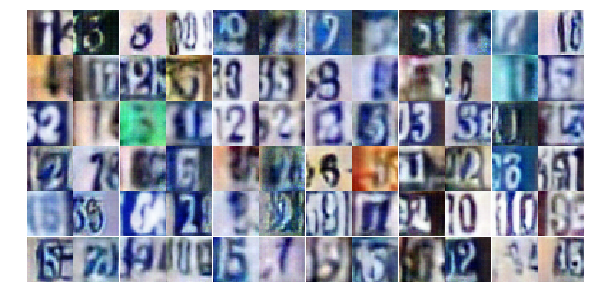

Epoch 18/25... Discriminator Loss: 1.0556... Generator Loss: 0.5933
Epoch 18/25... Discriminator Loss: 0.7906... Generator Loss: 0.9041
Epoch 18/25... Discriminator Loss: 1.0122... Generator Loss: 0.6451
Epoch 18/25... Discriminator Loss: 1.5931... Generator Loss: 0.3098
Epoch 18/25... Discriminator Loss: 0.7407... Generator Loss: 1.0466
Epoch 18/25... Discriminator Loss: 0.7884... Generator Loss: 2.0042
Epoch 18/25... Discriminator Loss: 0.5108... Generator Loss: 1.4648
Epoch 18/25... Discriminator Loss: 0.5568... Generator Loss: 1.2720
Epoch 18/25... Discriminator Loss: 1.0165... Generator Loss: 0.6559
Epoch 18/25... Discriminator Loss: 0.8526... Generator Loss: 0.7778


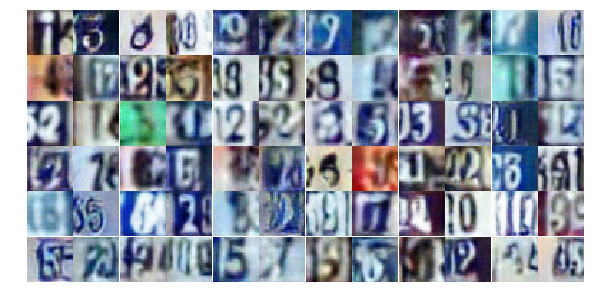

Epoch 18/25... Discriminator Loss: 0.9961... Generator Loss: 3.0131
Epoch 19/25... Discriminator Loss: 0.8754... Generator Loss: 0.7982
Epoch 19/25... Discriminator Loss: 1.5912... Generator Loss: 0.3287
Epoch 19/25... Discriminator Loss: 0.9672... Generator Loss: 0.6860
Epoch 19/25... Discriminator Loss: 0.6789... Generator Loss: 1.0654
Epoch 19/25... Discriminator Loss: 1.1244... Generator Loss: 0.5562
Epoch 19/25... Discriminator Loss: 0.6377... Generator Loss: 1.2166
Epoch 19/25... Discriminator Loss: 1.3797... Generator Loss: 0.5063
Epoch 19/25... Discriminator Loss: 0.6462... Generator Loss: 1.7009
Epoch 19/25... Discriminator Loss: 1.0980... Generator Loss: 0.5858


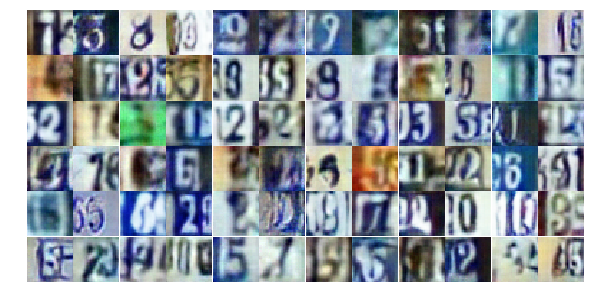

Epoch 19/25... Discriminator Loss: 1.0022... Generator Loss: 0.6576
Epoch 19/25... Discriminator Loss: 1.0280... Generator Loss: 0.7132
Epoch 19/25... Discriminator Loss: 0.7399... Generator Loss: 0.9539
Epoch 19/25... Discriminator Loss: 1.2648... Generator Loss: 0.4778
Epoch 19/25... Discriminator Loss: 1.2647... Generator Loss: 0.5384
Epoch 19/25... Discriminator Loss: 0.6857... Generator Loss: 1.2621
Epoch 19/25... Discriminator Loss: 1.0349... Generator Loss: 0.6148
Epoch 19/25... Discriminator Loss: 0.6909... Generator Loss: 1.0249
Epoch 19/25... Discriminator Loss: 0.7277... Generator Loss: 1.2441
Epoch 19/25... Discriminator Loss: 1.0312... Generator Loss: 0.6911


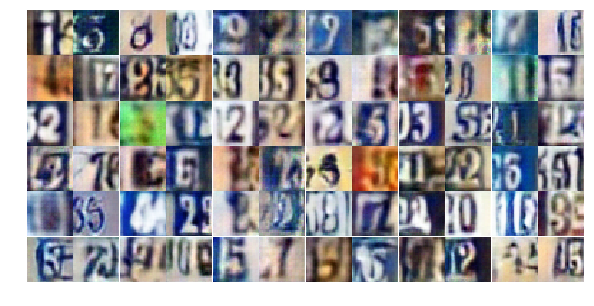

Epoch 19/25... Discriminator Loss: 0.9060... Generator Loss: 0.7463
Epoch 19/25... Discriminator Loss: 1.1124... Generator Loss: 0.5666
Epoch 19/25... Discriminator Loss: 1.3717... Generator Loss: 0.4820
Epoch 19/25... Discriminator Loss: 0.8850... Generator Loss: 0.8393
Epoch 19/25... Discriminator Loss: 1.3988... Generator Loss: 0.4751
Epoch 19/25... Discriminator Loss: 0.7688... Generator Loss: 0.9154
Epoch 19/25... Discriminator Loss: 0.6732... Generator Loss: 1.0509
Epoch 19/25... Discriminator Loss: 0.5938... Generator Loss: 1.1044
Epoch 19/25... Discriminator Loss: 0.6409... Generator Loss: 1.0821
Epoch 19/25... Discriminator Loss: 1.3397... Generator Loss: 0.4516


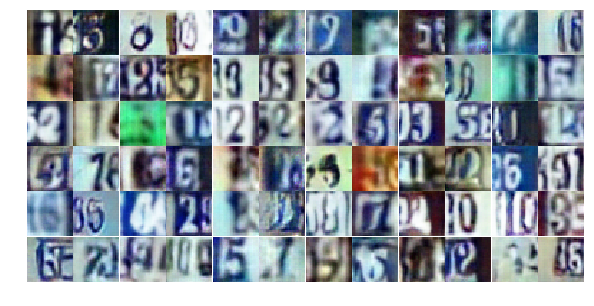

Epoch 19/25... Discriminator Loss: 0.9087... Generator Loss: 0.8026
Epoch 19/25... Discriminator Loss: 0.6196... Generator Loss: 1.1022
Epoch 19/25... Discriminator Loss: 1.5160... Generator Loss: 0.3508
Epoch 19/25... Discriminator Loss: 0.6446... Generator Loss: 1.0127
Epoch 19/25... Discriminator Loss: 0.6027... Generator Loss: 1.1966
Epoch 19/25... Discriminator Loss: 1.8913... Generator Loss: 0.3101
Epoch 19/25... Discriminator Loss: 0.6864... Generator Loss: 1.0911
Epoch 19/25... Discriminator Loss: 0.5721... Generator Loss: 1.2916
Epoch 19/25... Discriminator Loss: 0.7622... Generator Loss: 1.3102
Epoch 19/25... Discriminator Loss: 0.6911... Generator Loss: 0.9927


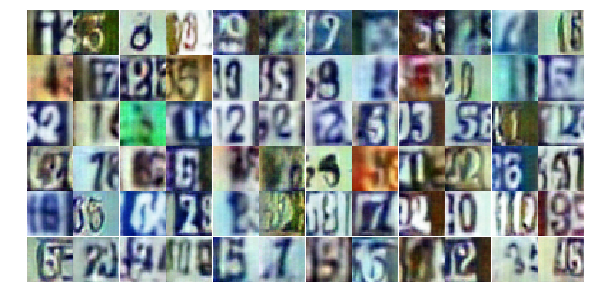

Epoch 19/25... Discriminator Loss: 0.7210... Generator Loss: 0.8850
Epoch 19/25... Discriminator Loss: 0.8257... Generator Loss: 0.9346
Epoch 19/25... Discriminator Loss: 0.7528... Generator Loss: 0.9200
Epoch 19/25... Discriminator Loss: 0.7229... Generator Loss: 0.9579
Epoch 19/25... Discriminator Loss: 0.9683... Generator Loss: 0.6703
Epoch 19/25... Discriminator Loss: 3.9233... Generator Loss: 6.8758
Epoch 19/25... Discriminator Loss: 2.0769... Generator Loss: 2.9792
Epoch 19/25... Discriminator Loss: 0.6666... Generator Loss: 1.1806
Epoch 19/25... Discriminator Loss: 0.6356... Generator Loss: 1.3818
Epoch 19/25... Discriminator Loss: 1.1369... Generator Loss: 0.6015


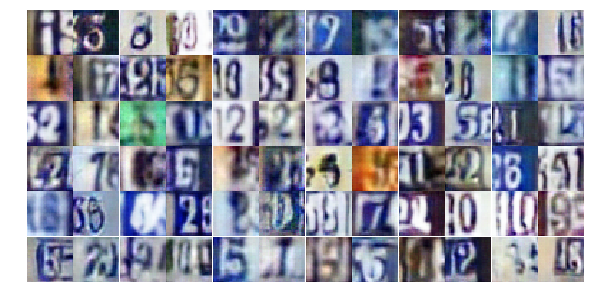

Epoch 19/25... Discriminator Loss: 0.8408... Generator Loss: 0.8604
Epoch 19/25... Discriminator Loss: 0.5753... Generator Loss: 1.5029
Epoch 19/25... Discriminator Loss: 0.8811... Generator Loss: 0.8910
Epoch 19/25... Discriminator Loss: 0.8667... Generator Loss: 0.8607
Epoch 19/25... Discriminator Loss: 0.7863... Generator Loss: 0.9945
Epoch 19/25... Discriminator Loss: 0.7436... Generator Loss: 1.0724
Epoch 19/25... Discriminator Loss: 1.3691... Generator Loss: 0.4271
Epoch 19/25... Discriminator Loss: 0.6020... Generator Loss: 1.1242
Epoch 20/25... Discriminator Loss: 0.7284... Generator Loss: 0.8735
Epoch 20/25... Discriminator Loss: 0.9291... Generator Loss: 0.7136


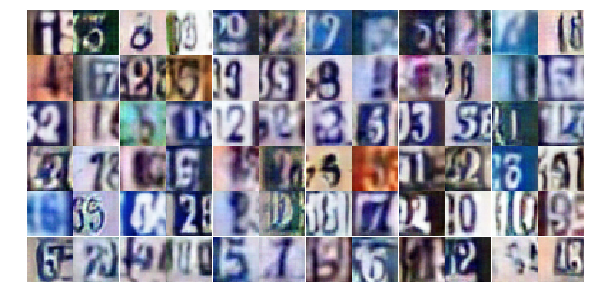

Epoch 20/25... Discriminator Loss: 0.9262... Generator Loss: 0.7339
Epoch 20/25... Discriminator Loss: 0.6959... Generator Loss: 0.9655
Epoch 20/25... Discriminator Loss: 1.8524... Generator Loss: 0.2644
Epoch 20/25... Discriminator Loss: 1.1073... Generator Loss: 0.5671
Epoch 20/25... Discriminator Loss: 0.6037... Generator Loss: 1.2295
Epoch 20/25... Discriminator Loss: 0.6994... Generator Loss: 1.0900
Epoch 20/25... Discriminator Loss: 0.8749... Generator Loss: 0.8354
Epoch 20/25... Discriminator Loss: 0.9489... Generator Loss: 0.7338
Epoch 20/25... Discriminator Loss: 0.9038... Generator Loss: 0.9098
Epoch 20/25... Discriminator Loss: 0.8282... Generator Loss: 0.8045


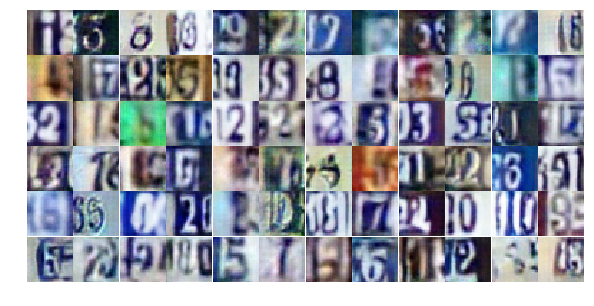

Epoch 20/25... Discriminator Loss: 1.2173... Generator Loss: 0.5565
Epoch 20/25... Discriminator Loss: 0.8756... Generator Loss: 0.8350
Epoch 20/25... Discriminator Loss: 0.8021... Generator Loss: 0.9837
Epoch 20/25... Discriminator Loss: 0.7776... Generator Loss: 1.0894
Epoch 20/25... Discriminator Loss: 0.7442... Generator Loss: 0.9143
Epoch 20/25... Discriminator Loss: 1.4392... Generator Loss: 0.3975
Epoch 20/25... Discriminator Loss: 0.7343... Generator Loss: 0.9916
Epoch 20/25... Discriminator Loss: 0.6767... Generator Loss: 0.9793
Epoch 20/25... Discriminator Loss: 0.5099... Generator Loss: 1.5453
Epoch 20/25... Discriminator Loss: 1.3686... Generator Loss: 0.5484


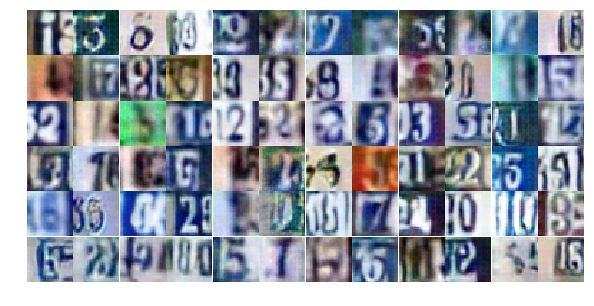

Epoch 20/25... Discriminator Loss: 0.7395... Generator Loss: 0.9025
Epoch 20/25... Discriminator Loss: 0.8490... Generator Loss: 0.8164
Epoch 20/25... Discriminator Loss: 0.3824... Generator Loss: 1.4340
Epoch 20/25... Discriminator Loss: 1.5639... Generator Loss: 0.3352
Epoch 20/25... Discriminator Loss: 1.0631... Generator Loss: 0.6469
Epoch 20/25... Discriminator Loss: 0.3748... Generator Loss: 2.2634
Epoch 20/25... Discriminator Loss: 0.9455... Generator Loss: 0.7574
Epoch 20/25... Discriminator Loss: 1.8002... Generator Loss: 0.2380
Epoch 20/25... Discriminator Loss: 1.0552... Generator Loss: 0.6435
Epoch 20/25... Discriminator Loss: 0.5323... Generator Loss: 1.1680


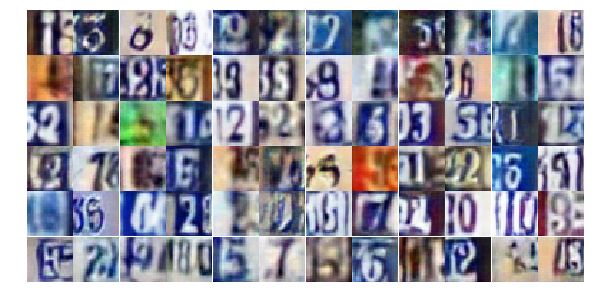

Epoch 20/25... Discriminator Loss: 0.9608... Generator Loss: 0.8226
Epoch 20/25... Discriminator Loss: 1.1407... Generator Loss: 0.5691
Epoch 20/25... Discriminator Loss: 1.7024... Generator Loss: 0.3083
Epoch 20/25... Discriminator Loss: 0.6960... Generator Loss: 1.1640
Epoch 20/25... Discriminator Loss: 0.8132... Generator Loss: 0.9655
Epoch 20/25... Discriminator Loss: 0.5401... Generator Loss: 1.4982
Epoch 20/25... Discriminator Loss: 0.7867... Generator Loss: 0.8581
Epoch 20/25... Discriminator Loss: 0.9535... Generator Loss: 0.7880
Epoch 20/25... Discriminator Loss: 0.6322... Generator Loss: 1.2877
Epoch 20/25... Discriminator Loss: 0.9456... Generator Loss: 0.7527


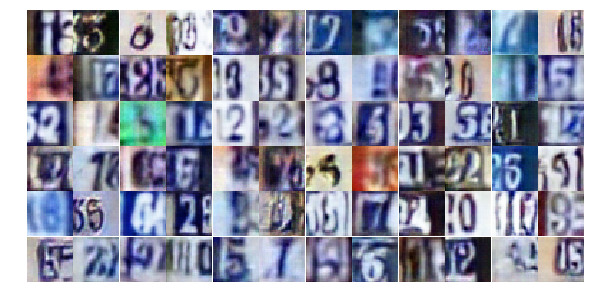

Epoch 20/25... Discriminator Loss: 1.1416... Generator Loss: 0.6118
Epoch 20/25... Discriminator Loss: 1.1655... Generator Loss: 0.5504
Epoch 20/25... Discriminator Loss: 1.2380... Generator Loss: 3.2637
Epoch 20/25... Discriminator Loss: 1.3245... Generator Loss: 0.6695
Epoch 20/25... Discriminator Loss: 1.0311... Generator Loss: 0.8202
Epoch 20/25... Discriminator Loss: 1.0776... Generator Loss: 0.6384
Epoch 20/25... Discriminator Loss: 0.8281... Generator Loss: 1.0082
Epoch 20/25... Discriminator Loss: 0.4920... Generator Loss: 1.3573
Epoch 20/25... Discriminator Loss: 0.7478... Generator Loss: 1.0637
Epoch 20/25... Discriminator Loss: 0.8635... Generator Loss: 0.7637


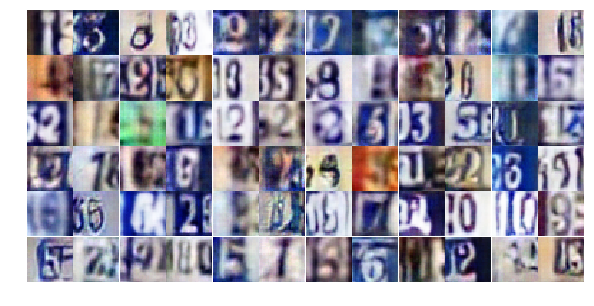

Epoch 20/25... Discriminator Loss: 0.4814... Generator Loss: 1.3414
Epoch 20/25... Discriminator Loss: 0.7821... Generator Loss: 1.0001
Epoch 20/25... Discriminator Loss: 0.4209... Generator Loss: 1.7453
Epoch 20/25... Discriminator Loss: 0.9445... Generator Loss: 0.7547
Epoch 20/25... Discriminator Loss: 0.5370... Generator Loss: 1.3484
Epoch 20/25... Discriminator Loss: 0.6286... Generator Loss: 1.1552
Epoch 21/25... Discriminator Loss: 1.2664... Generator Loss: 0.5252
Epoch 21/25... Discriminator Loss: 0.8585... Generator Loss: 0.8417
Epoch 21/25... Discriminator Loss: 1.3420... Generator Loss: 0.4527
Epoch 21/25... Discriminator Loss: 1.3403... Generator Loss: 0.4494


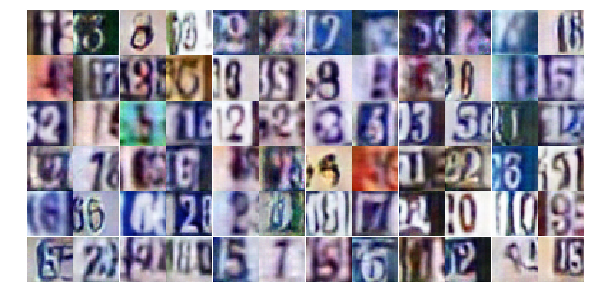

Epoch 21/25... Discriminator Loss: 0.7173... Generator Loss: 0.9599
Epoch 21/25... Discriminator Loss: 1.7086... Generator Loss: 0.2940
Epoch 21/25... Discriminator Loss: 0.3996... Generator Loss: 1.7947
Epoch 21/25... Discriminator Loss: 0.4715... Generator Loss: 1.2501
Epoch 21/25... Discriminator Loss: 0.7553... Generator Loss: 0.9078
Epoch 21/25... Discriminator Loss: 0.4952... Generator Loss: 1.2643
Epoch 21/25... Discriminator Loss: 0.7926... Generator Loss: 0.8380
Epoch 21/25... Discriminator Loss: 0.7340... Generator Loss: 1.6027
Epoch 21/25... Discriminator Loss: 0.7833... Generator Loss: 0.8416
Epoch 21/25... Discriminator Loss: 1.0597... Generator Loss: 0.6192


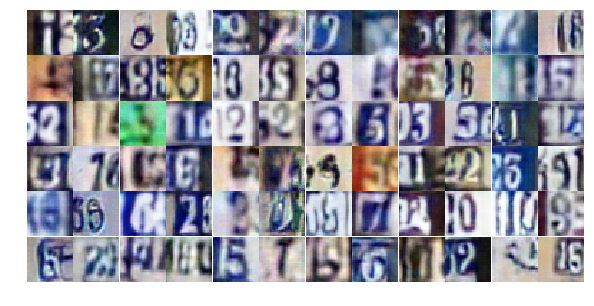

Epoch 21/25... Discriminator Loss: 0.3011... Generator Loss: 1.8450
Epoch 21/25... Discriminator Loss: 0.6256... Generator Loss: 1.0595
Epoch 21/25... Discriminator Loss: 1.5606... Generator Loss: 0.3762
Epoch 21/25... Discriminator Loss: 0.8882... Generator Loss: 0.8815
Epoch 21/25... Discriminator Loss: 0.5524... Generator Loss: 1.2621
Epoch 21/25... Discriminator Loss: 1.2597... Generator Loss: 0.4994
Epoch 21/25... Discriminator Loss: 0.7034... Generator Loss: 1.3209
Epoch 21/25... Discriminator Loss: 0.4190... Generator Loss: 2.0505
Epoch 21/25... Discriminator Loss: 1.7771... Generator Loss: 0.4149
Epoch 21/25... Discriminator Loss: 1.1350... Generator Loss: 0.7066


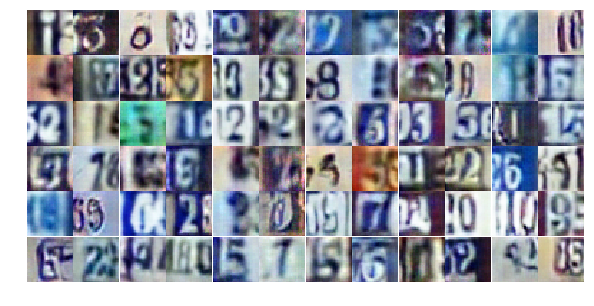

Epoch 21/25... Discriminator Loss: 1.2535... Generator Loss: 0.5733
Epoch 21/25... Discriminator Loss: 0.4424... Generator Loss: 1.4554
Epoch 21/25... Discriminator Loss: 1.5217... Generator Loss: 0.3963
Epoch 21/25... Discriminator Loss: 0.9406... Generator Loss: 0.8222
Epoch 21/25... Discriminator Loss: 0.8799... Generator Loss: 0.8014
Epoch 21/25... Discriminator Loss: 1.4428... Generator Loss: 0.4464
Epoch 21/25... Discriminator Loss: 0.7359... Generator Loss: 0.8880
Epoch 21/25... Discriminator Loss: 1.0167... Generator Loss: 0.7491
Epoch 21/25... Discriminator Loss: 1.3628... Generator Loss: 0.4536
Epoch 21/25... Discriminator Loss: 1.4603... Generator Loss: 0.4488


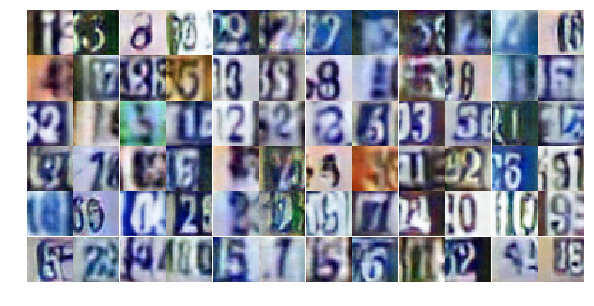

Epoch 21/25... Discriminator Loss: 1.1170... Generator Loss: 0.6086
Epoch 21/25... Discriminator Loss: 0.5965... Generator Loss: 1.1257
Epoch 21/25... Discriminator Loss: 1.3915... Generator Loss: 0.4548
Epoch 21/25... Discriminator Loss: 0.6666... Generator Loss: 1.0378
Epoch 21/25... Discriminator Loss: 0.6850... Generator Loss: 0.9555
Epoch 21/25... Discriminator Loss: 1.1138... Generator Loss: 0.6189
Epoch 21/25... Discriminator Loss: 0.6389... Generator Loss: 1.4817
Epoch 21/25... Discriminator Loss: 1.6522... Generator Loss: 0.2935
Epoch 21/25... Discriminator Loss: 0.8756... Generator Loss: 1.0023
Epoch 21/25... Discriminator Loss: 0.2291... Generator Loss: 2.7765


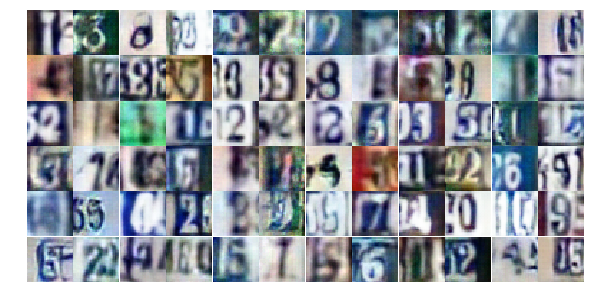

Epoch 21/25... Discriminator Loss: 1.1400... Generator Loss: 0.5363
Epoch 21/25... Discriminator Loss: 0.6187... Generator Loss: 1.1112
Epoch 21/25... Discriminator Loss: 0.6891... Generator Loss: 1.0554
Epoch 21/25... Discriminator Loss: 0.9155... Generator Loss: 0.8425
Epoch 21/25... Discriminator Loss: 0.5235... Generator Loss: 1.3724
Epoch 21/25... Discriminator Loss: 0.7017... Generator Loss: 1.0657
Epoch 21/25... Discriminator Loss: 0.9457... Generator Loss: 0.6620
Epoch 21/25... Discriminator Loss: 1.6158... Generator Loss: 0.3567
Epoch 21/25... Discriminator Loss: 1.2829... Generator Loss: 0.5294
Epoch 21/25... Discriminator Loss: 0.9669... Generator Loss: 0.7612


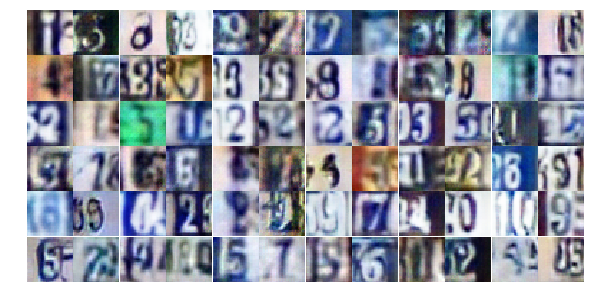

Epoch 21/25... Discriminator Loss: 0.6972... Generator Loss: 1.3387
Epoch 21/25... Discriminator Loss: 1.0609... Generator Loss: 2.8953
Epoch 21/25... Discriminator Loss: 0.5779... Generator Loss: 1.3849
Epoch 22/25... Discriminator Loss: 0.7099... Generator Loss: 1.4557
Epoch 22/25... Discriminator Loss: 0.7501... Generator Loss: 1.0266
Epoch 22/25... Discriminator Loss: 1.0633... Generator Loss: 1.7434
Epoch 22/25... Discriminator Loss: 0.5662... Generator Loss: 1.3168
Epoch 22/25... Discriminator Loss: 0.6484... Generator Loss: 1.0180
Epoch 22/25... Discriminator Loss: 1.3076... Generator Loss: 0.4126
Epoch 22/25... Discriminator Loss: 1.3010... Generator Loss: 0.4252


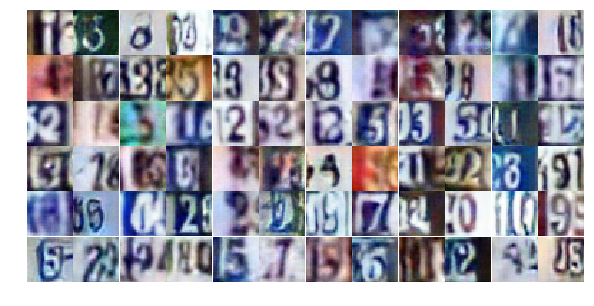

Epoch 22/25... Discriminator Loss: 0.6234... Generator Loss: 1.4973
Epoch 22/25... Discriminator Loss: 0.7930... Generator Loss: 0.9512
Epoch 22/25... Discriminator Loss: 1.3759... Generator Loss: 0.4832
Epoch 22/25... Discriminator Loss: 0.8321... Generator Loss: 0.9907
Epoch 22/25... Discriminator Loss: 1.1995... Generator Loss: 0.5515
Epoch 22/25... Discriminator Loss: 0.8985... Generator Loss: 0.7343
Epoch 22/25... Discriminator Loss: 0.7183... Generator Loss: 0.9626
Epoch 22/25... Discriminator Loss: 0.5450... Generator Loss: 1.5465
Epoch 22/25... Discriminator Loss: 0.7732... Generator Loss: 0.9278
Epoch 22/25... Discriminator Loss: 1.3475... Generator Loss: 0.4788


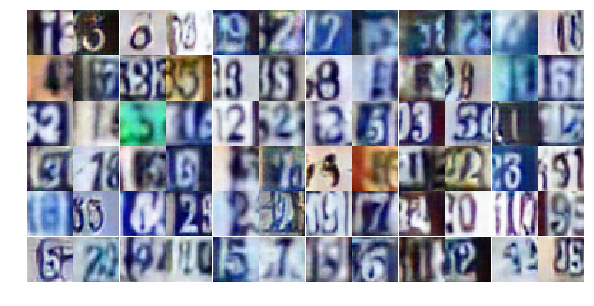

Epoch 22/25... Discriminator Loss: 0.4590... Generator Loss: 1.8128
Epoch 22/25... Discriminator Loss: 0.6620... Generator Loss: 1.0280
Epoch 22/25... Discriminator Loss: 0.7239... Generator Loss: 0.9387
Epoch 22/25... Discriminator Loss: 0.4291... Generator Loss: 1.5228
Epoch 22/25... Discriminator Loss: 0.4304... Generator Loss: 1.9804
Epoch 22/25... Discriminator Loss: 1.5071... Generator Loss: 0.3997
Epoch 22/25... Discriminator Loss: 0.4118... Generator Loss: 1.8761
Epoch 22/25... Discriminator Loss: 0.3807... Generator Loss: 1.7317
Epoch 22/25... Discriminator Loss: 0.6911... Generator Loss: 0.9593
Epoch 22/25... Discriminator Loss: 1.4890... Generator Loss: 0.3663


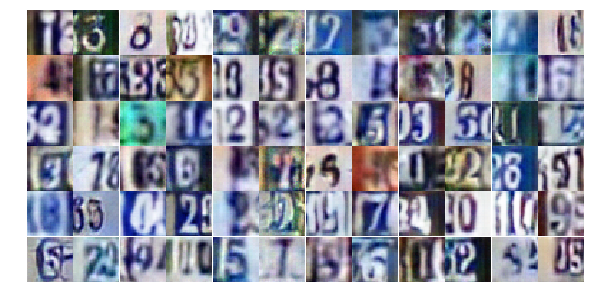

Epoch 22/25... Discriminator Loss: 0.6228... Generator Loss: 1.0223
Epoch 22/25... Discriminator Loss: 0.5708... Generator Loss: 1.1781
Epoch 22/25... Discriminator Loss: 0.7090... Generator Loss: 0.9992
Epoch 22/25... Discriminator Loss: 0.9350... Generator Loss: 0.6724
Epoch 22/25... Discriminator Loss: 0.6873... Generator Loss: 1.3802
Epoch 22/25... Discriminator Loss: 0.9304... Generator Loss: 0.8041
Epoch 22/25... Discriminator Loss: 1.3776... Generator Loss: 0.5063
Epoch 22/25... Discriminator Loss: 0.6678... Generator Loss: 1.0912
Epoch 22/25... Discriminator Loss: 0.8841... Generator Loss: 0.9519
Epoch 22/25... Discriminator Loss: 1.2810... Generator Loss: 0.4754


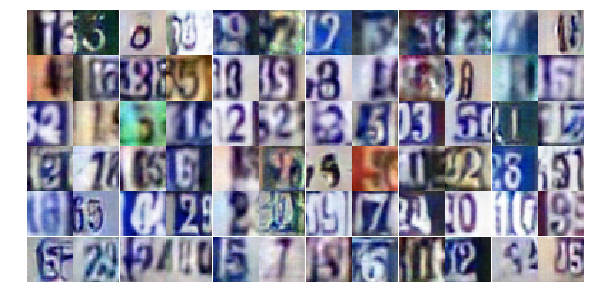

Epoch 22/25... Discriminator Loss: 1.0681... Generator Loss: 0.6980
Epoch 22/25... Discriminator Loss: 0.5264... Generator Loss: 1.5380
Epoch 22/25... Discriminator Loss: 0.5944... Generator Loss: 1.1223
Epoch 22/25... Discriminator Loss: 0.6583... Generator Loss: 1.0611
Epoch 22/25... Discriminator Loss: 0.5123... Generator Loss: 1.1012
Epoch 22/25... Discriminator Loss: 0.6026... Generator Loss: 1.0569
Epoch 22/25... Discriminator Loss: 2.2844... Generator Loss: 0.2610
Epoch 22/25... Discriminator Loss: 1.1086... Generator Loss: 0.7629
Epoch 22/25... Discriminator Loss: 1.4410... Generator Loss: 0.3706
Epoch 22/25... Discriminator Loss: 0.5865... Generator Loss: 1.2777


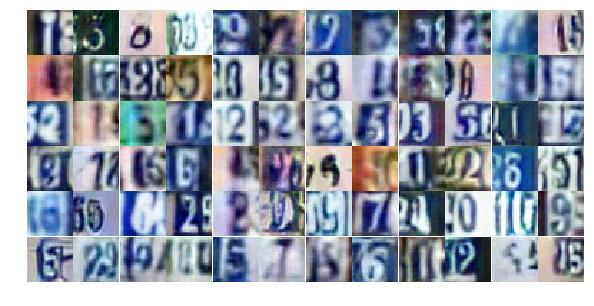

Epoch 22/25... Discriminator Loss: 1.1047... Generator Loss: 0.5842
Epoch 22/25... Discriminator Loss: 0.5077... Generator Loss: 1.4640
Epoch 22/25... Discriminator Loss: 0.8909... Generator Loss: 0.7221
Epoch 22/25... Discriminator Loss: 0.7656... Generator Loss: 1.1642
Epoch 22/25... Discriminator Loss: 0.8680... Generator Loss: 0.8808
Epoch 22/25... Discriminator Loss: 0.9576... Generator Loss: 0.7684
Epoch 22/25... Discriminator Loss: 0.9477... Generator Loss: 0.6889
Epoch 22/25... Discriminator Loss: 0.6524... Generator Loss: 1.1265
Epoch 22/25... Discriminator Loss: 1.5709... Generator Loss: 3.4174
Epoch 22/25... Discriminator Loss: 1.1034... Generator Loss: 0.6084


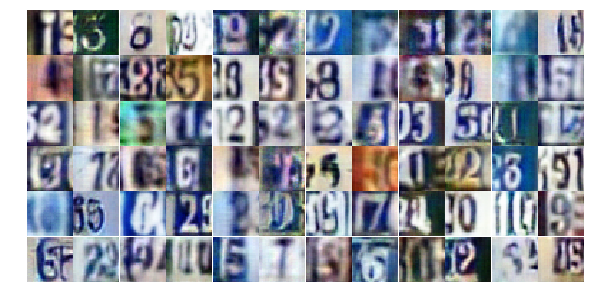

Epoch 23/25... Discriminator Loss: 0.5500... Generator Loss: 1.2263
Epoch 23/25... Discriminator Loss: 0.4813... Generator Loss: 1.3529
Epoch 23/25... Discriminator Loss: 0.9379... Generator Loss: 0.7367
Epoch 23/25... Discriminator Loss: 0.6833... Generator Loss: 1.1181
Epoch 23/25... Discriminator Loss: 0.7206... Generator Loss: 0.9917
Epoch 23/25... Discriminator Loss: 1.5244... Generator Loss: 0.4234
Epoch 23/25... Discriminator Loss: 1.5217... Generator Loss: 0.3701
Epoch 23/25... Discriminator Loss: 0.5314... Generator Loss: 1.6183
Epoch 23/25... Discriminator Loss: 0.5506... Generator Loss: 1.3690
Epoch 23/25... Discriminator Loss: 0.5101... Generator Loss: 1.4642


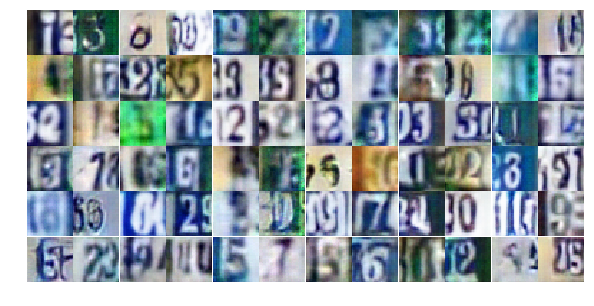

Epoch 23/25... Discriminator Loss: 0.7826... Generator Loss: 0.8833
Epoch 23/25... Discriminator Loss: 0.5812... Generator Loss: 1.2694
Epoch 23/25... Discriminator Loss: 0.5734... Generator Loss: 1.4291
Epoch 23/25... Discriminator Loss: 0.6008... Generator Loss: 1.3858
Epoch 23/25... Discriminator Loss: 0.3544... Generator Loss: 1.8255
Epoch 23/25... Discriminator Loss: 1.0111... Generator Loss: 0.6832
Epoch 23/25... Discriminator Loss: 0.9088... Generator Loss: 0.7372
Epoch 23/25... Discriminator Loss: 0.6740... Generator Loss: 1.0214
Epoch 23/25... Discriminator Loss: 0.8220... Generator Loss: 0.8931
Epoch 23/25... Discriminator Loss: 0.6890... Generator Loss: 1.0264


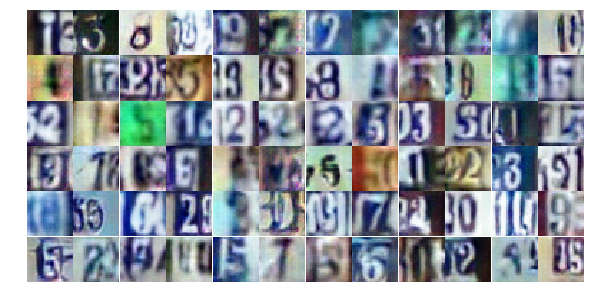

Epoch 23/25... Discriminator Loss: 1.0805... Generator Loss: 0.6243
Epoch 23/25... Discriminator Loss: 0.7129... Generator Loss: 1.0354
Epoch 23/25... Discriminator Loss: 0.9946... Generator Loss: 0.6304
Epoch 23/25... Discriminator Loss: 1.0253... Generator Loss: 0.6430
Epoch 23/25... Discriminator Loss: 0.7838... Generator Loss: 0.8849
Epoch 23/25... Discriminator Loss: 0.6264... Generator Loss: 1.3881
Epoch 23/25... Discriminator Loss: 0.6841... Generator Loss: 0.9689
Epoch 23/25... Discriminator Loss: 0.8896... Generator Loss: 0.7350
Epoch 23/25... Discriminator Loss: 1.1310... Generator Loss: 0.6231
Epoch 23/25... Discriminator Loss: 0.9846... Generator Loss: 1.5549


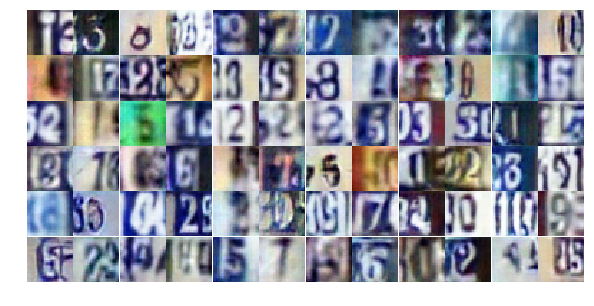

Epoch 23/25... Discriminator Loss: 0.4996... Generator Loss: 1.7964
Epoch 23/25... Discriminator Loss: 0.5696... Generator Loss: 1.2170
Epoch 23/25... Discriminator Loss: 0.6654... Generator Loss: 1.0950
Epoch 23/25... Discriminator Loss: 1.2966... Generator Loss: 0.5186
Epoch 23/25... Discriminator Loss: 0.6990... Generator Loss: 1.9154
Epoch 23/25... Discriminator Loss: 1.0249... Generator Loss: 0.8417
Epoch 23/25... Discriminator Loss: 0.9459... Generator Loss: 0.7029
Epoch 23/25... Discriminator Loss: 0.9199... Generator Loss: 0.7369
Epoch 23/25... Discriminator Loss: 0.4482... Generator Loss: 1.6992
Epoch 23/25... Discriminator Loss: 0.5139... Generator Loss: 1.2328


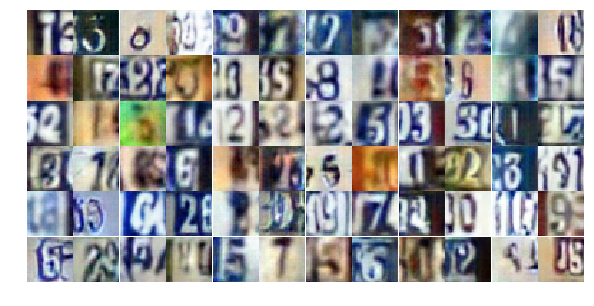

Epoch 23/25... Discriminator Loss: 0.9522... Generator Loss: 0.7532
Epoch 23/25... Discriminator Loss: 0.5716... Generator Loss: 1.3145
Epoch 23/25... Discriminator Loss: 1.3294... Generator Loss: 0.4924
Epoch 23/25... Discriminator Loss: 0.7284... Generator Loss: 1.2079
Epoch 23/25... Discriminator Loss: 10.7444... Generator Loss: 0.0002
Epoch 23/25... Discriminator Loss: 1.7289... Generator Loss: 0.4809
Epoch 23/25... Discriminator Loss: 1.2998... Generator Loss: 0.9173
Epoch 23/25... Discriminator Loss: 1.5622... Generator Loss: 1.9596
Epoch 23/25... Discriminator Loss: 1.5515... Generator Loss: 2.5670
Epoch 23/25... Discriminator Loss: 2.3776... Generator Loss: 0.4184


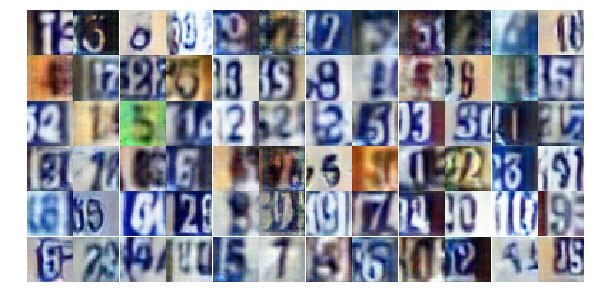

Epoch 23/25... Discriminator Loss: 1.0624... Generator Loss: 0.7189
Epoch 23/25... Discriminator Loss: 1.3273... Generator Loss: 0.5090
Epoch 23/25... Discriminator Loss: 0.8755... Generator Loss: 0.8190
Epoch 23/25... Discriminator Loss: 0.5646... Generator Loss: 1.4519
Epoch 23/25... Discriminator Loss: 1.2829... Generator Loss: 0.4945
Epoch 23/25... Discriminator Loss: 0.6676... Generator Loss: 1.4023
Epoch 23/25... Discriminator Loss: 0.7051... Generator Loss: 0.9631
Epoch 24/25... Discriminator Loss: 0.7589... Generator Loss: 0.9896
Epoch 24/25... Discriminator Loss: 0.9279... Generator Loss: 0.8450
Epoch 24/25... Discriminator Loss: 1.1360... Generator Loss: 0.6359


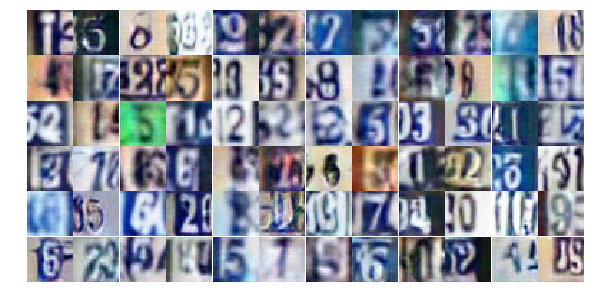

Epoch 24/25... Discriminator Loss: 0.8206... Generator Loss: 0.9498
Epoch 24/25... Discriminator Loss: 0.6016... Generator Loss: 1.3541
Epoch 24/25... Discriminator Loss: 1.1712... Generator Loss: 0.5379
Epoch 24/25... Discriminator Loss: 0.9250... Generator Loss: 0.8467
Epoch 24/25... Discriminator Loss: 0.6664... Generator Loss: 1.0702
Epoch 24/25... Discriminator Loss: 0.6857... Generator Loss: 1.1008
Epoch 24/25... Discriminator Loss: 0.7799... Generator Loss: 0.8284
Epoch 24/25... Discriminator Loss: 0.8346... Generator Loss: 0.7793
Epoch 24/25... Discriminator Loss: 0.9142... Generator Loss: 0.7022
Epoch 24/25... Discriminator Loss: 0.5227... Generator Loss: 1.3303


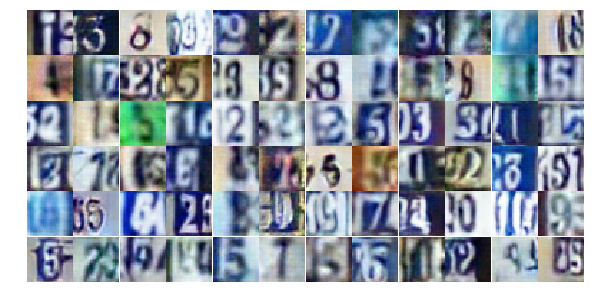

Epoch 24/25... Discriminator Loss: 1.1210... Generator Loss: 0.5598
Epoch 24/25... Discriminator Loss: 1.1932... Generator Loss: 0.5011
Epoch 24/25... Discriminator Loss: 1.1687... Generator Loss: 0.5146
Epoch 24/25... Discriminator Loss: 0.6657... Generator Loss: 1.0167
Epoch 24/25... Discriminator Loss: 0.6475... Generator Loss: 1.4844
Epoch 24/25... Discriminator Loss: 1.0097... Generator Loss: 0.7124
Epoch 24/25... Discriminator Loss: 0.4837... Generator Loss: 1.4840
Epoch 24/25... Discriminator Loss: 0.9836... Generator Loss: 0.7977
Epoch 24/25... Discriminator Loss: 0.5907... Generator Loss: 1.2596
Epoch 24/25... Discriminator Loss: 0.8672... Generator Loss: 0.9523


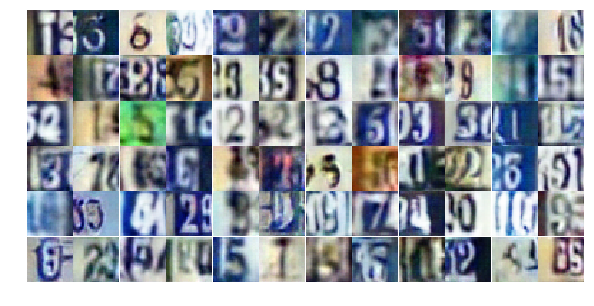

Epoch 24/25... Discriminator Loss: 1.1254... Generator Loss: 0.6254
Epoch 24/25... Discriminator Loss: 0.8779... Generator Loss: 0.8329
Epoch 24/25... Discriminator Loss: 0.5475... Generator Loss: 1.5594
Epoch 24/25... Discriminator Loss: 1.7129... Generator Loss: 0.2908
Epoch 24/25... Discriminator Loss: 0.8036... Generator Loss: 0.8953
Epoch 24/25... Discriminator Loss: 0.7411... Generator Loss: 0.9425
Epoch 24/25... Discriminator Loss: 0.5895... Generator Loss: 1.0650
Epoch 24/25... Discriminator Loss: 1.2105... Generator Loss: 0.5097
Epoch 24/25... Discriminator Loss: 0.7379... Generator Loss: 1.0174
Epoch 24/25... Discriminator Loss: 0.6701... Generator Loss: 1.2427


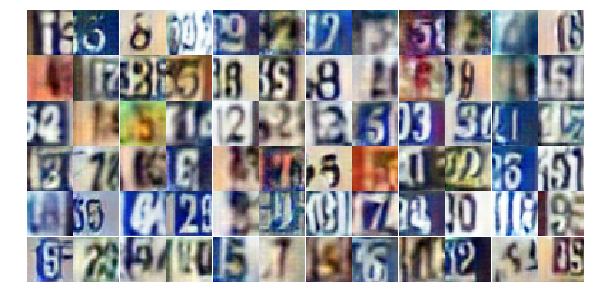

Epoch 24/25... Discriminator Loss: 0.7580... Generator Loss: 0.8862
Epoch 24/25... Discriminator Loss: 0.5501... Generator Loss: 1.1889
Epoch 24/25... Discriminator Loss: 1.1929... Generator Loss: 0.5205
Epoch 24/25... Discriminator Loss: 1.2197... Generator Loss: 0.5193
Epoch 24/25... Discriminator Loss: 1.3677... Generator Loss: 0.4577
Epoch 24/25... Discriminator Loss: 0.9018... Generator Loss: 0.8789
Epoch 24/25... Discriminator Loss: 1.1239... Generator Loss: 0.5810
Epoch 24/25... Discriminator Loss: 0.8848... Generator Loss: 0.7702
Epoch 24/25... Discriminator Loss: 0.9198... Generator Loss: 0.7524
Epoch 24/25... Discriminator Loss: 0.6149... Generator Loss: 1.4364


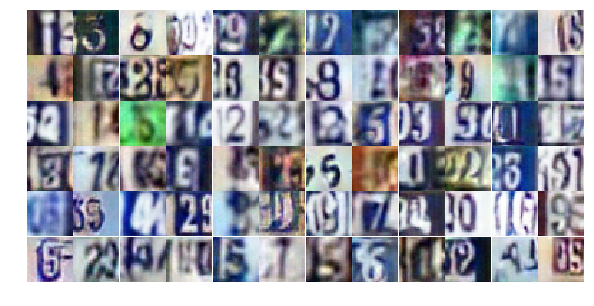

Epoch 24/25... Discriminator Loss: 0.7472... Generator Loss: 1.0443
Epoch 24/25... Discriminator Loss: 2.0263... Generator Loss: 0.3409
Epoch 24/25... Discriminator Loss: 1.1296... Generator Loss: 0.5821
Epoch 24/25... Discriminator Loss: 1.6046... Generator Loss: 0.3090
Epoch 24/25... Discriminator Loss: 1.3607... Generator Loss: 0.5372
Epoch 24/25... Discriminator Loss: 0.7761... Generator Loss: 0.9683
Epoch 24/25... Discriminator Loss: 1.0094... Generator Loss: 0.7041
Epoch 24/25... Discriminator Loss: 0.8251... Generator Loss: 0.8316
Epoch 24/25... Discriminator Loss: 0.9099... Generator Loss: 0.7781
Epoch 24/25... Discriminator Loss: 4.7416... Generator Loss: 6.4179


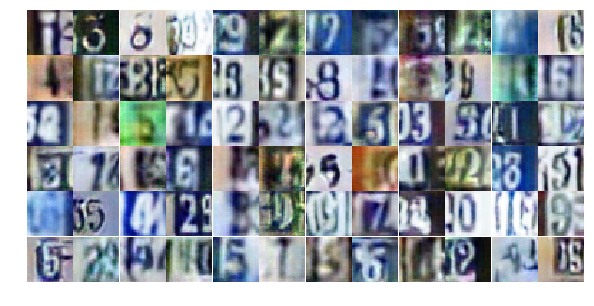

Epoch 24/25... Discriminator Loss: 1.1997... Generator Loss: 3.1132
Epoch 24/25... Discriminator Loss: 1.3879... Generator Loss: 0.6204
Epoch 24/25... Discriminator Loss: 1.0644... Generator Loss: 0.7177
Epoch 24/25... Discriminator Loss: 0.8878... Generator Loss: 0.8513
Epoch 24/25... Discriminator Loss: 1.1537... Generator Loss: 0.5204
Epoch 25/25... Discriminator Loss: 0.7641... Generator Loss: 1.0752
Epoch 25/25... Discriminator Loss: 0.4699... Generator Loss: 1.5239
Epoch 25/25... Discriminator Loss: 1.0388... Generator Loss: 0.6277
Epoch 25/25... Discriminator Loss: 1.0882... Generator Loss: 0.6426
Epoch 25/25... Discriminator Loss: 0.8337... Generator Loss: 0.8357


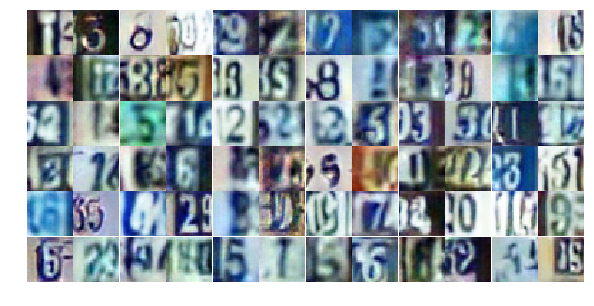

Epoch 25/25... Discriminator Loss: 1.4658... Generator Loss: 0.4328
Epoch 25/25... Discriminator Loss: 1.4666... Generator Loss: 0.4210
Epoch 25/25... Discriminator Loss: 0.7117... Generator Loss: 1.0305
Epoch 25/25... Discriminator Loss: 0.4881... Generator Loss: 1.5863
Epoch 25/25... Discriminator Loss: 1.1242... Generator Loss: 0.5909
Epoch 25/25... Discriminator Loss: 1.0761... Generator Loss: 0.5896
Epoch 25/25... Discriminator Loss: 0.6756... Generator Loss: 1.2158
Epoch 25/25... Discriminator Loss: 0.7136... Generator Loss: 1.0603
Epoch 25/25... Discriminator Loss: 0.5487... Generator Loss: 1.8731
Epoch 25/25... Discriminator Loss: 1.0214... Generator Loss: 0.7329


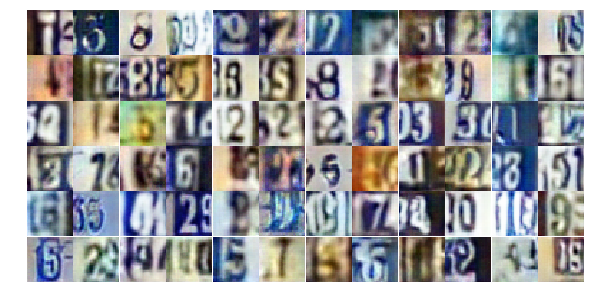

Epoch 25/25... Discriminator Loss: 0.8529... Generator Loss: 0.8317
Epoch 25/25... Discriminator Loss: 0.5465... Generator Loss: 1.8221
Epoch 25/25... Discriminator Loss: 0.7113... Generator Loss: 1.0464
Epoch 25/25... Discriminator Loss: 0.8815... Generator Loss: 0.8313
Epoch 25/25... Discriminator Loss: 0.6157... Generator Loss: 1.1559
Epoch 25/25... Discriminator Loss: 0.5876... Generator Loss: 1.1340
Epoch 25/25... Discriminator Loss: 0.7538... Generator Loss: 0.9555
Epoch 25/25... Discriminator Loss: 1.1647... Generator Loss: 0.5947
Epoch 25/25... Discriminator Loss: 0.5074... Generator Loss: 1.4271
Epoch 25/25... Discriminator Loss: 0.9197... Generator Loss: 0.7783


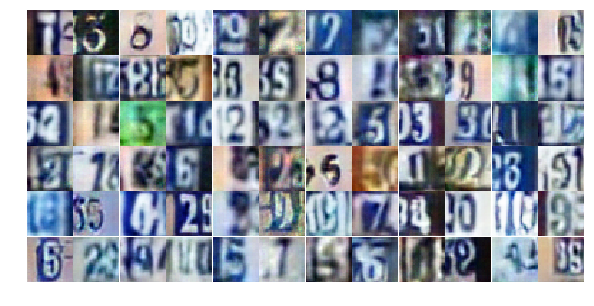

Epoch 25/25... Discriminator Loss: 0.8624... Generator Loss: 0.8305
Epoch 25/25... Discriminator Loss: 0.5586... Generator Loss: 1.2486
Epoch 25/25... Discriminator Loss: 1.1441... Generator Loss: 0.6180
Epoch 25/25... Discriminator Loss: 0.7898... Generator Loss: 0.8694
Epoch 25/25... Discriminator Loss: 0.7420... Generator Loss: 0.9691
Epoch 25/25... Discriminator Loss: 0.7530... Generator Loss: 0.8727
Epoch 25/25... Discriminator Loss: 1.0158... Generator Loss: 0.7184
Epoch 25/25... Discriminator Loss: 0.7547... Generator Loss: 0.9048
Epoch 25/25... Discriminator Loss: 0.8456... Generator Loss: 1.0950
Epoch 25/25... Discriminator Loss: 0.5191... Generator Loss: 1.3084


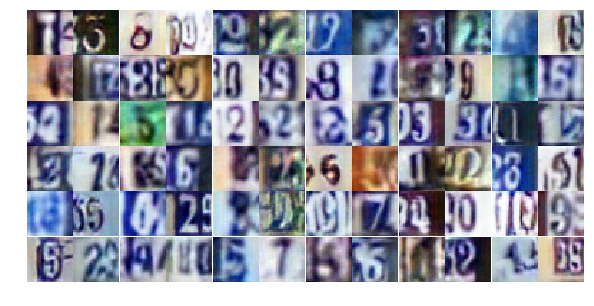

Epoch 25/25... Discriminator Loss: 0.8381... Generator Loss: 0.8394
Epoch 25/25... Discriminator Loss: 0.8250... Generator Loss: 0.7759
Epoch 25/25... Discriminator Loss: 0.8075... Generator Loss: 0.9204
Epoch 25/25... Discriminator Loss: 1.3313... Generator Loss: 0.4438
Epoch 25/25... Discriminator Loss: 0.9851... Generator Loss: 0.7333
Epoch 25/25... Discriminator Loss: 1.0892... Generator Loss: 0.6276
Epoch 25/25... Discriminator Loss: 0.4711... Generator Loss: 1.5506
Epoch 25/25... Discriminator Loss: 0.6226... Generator Loss: 1.2390
Epoch 25/25... Discriminator Loss: 2.3374... Generator Loss: 0.1671
Epoch 25/25... Discriminator Loss: 0.6236... Generator Loss: 1.9756


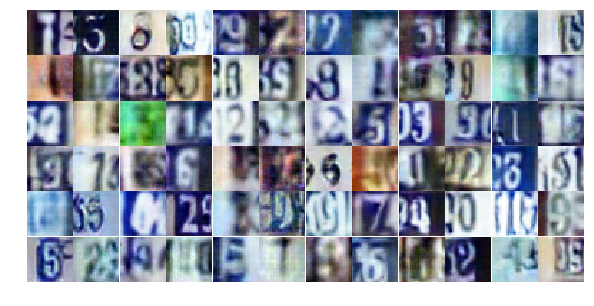

Epoch 25/25... Discriminator Loss: 0.9098... Generator Loss: 2.7986
Epoch 25/25... Discriminator Loss: 0.9673... Generator Loss: 0.7136
Epoch 25/25... Discriminator Loss: 1.0697... Generator Loss: 0.6607
Epoch 25/25... Discriminator Loss: 1.0037... Generator Loss: 0.7271
Epoch 25/25... Discriminator Loss: 1.2143... Generator Loss: 0.4977
Epoch 25/25... Discriminator Loss: 0.3834... Generator Loss: 1.6027
Epoch 25/25... Discriminator Loss: 1.6697... Generator Loss: 0.3279
Epoch 25/25... Discriminator Loss: 0.7190... Generator Loss: 1.0228
Epoch 25/25... Discriminator Loss: 0.6553... Generator Loss: 1.2369
Epoch 25/25... Discriminator Loss: 1.0186... Generator Loss: 0.7182


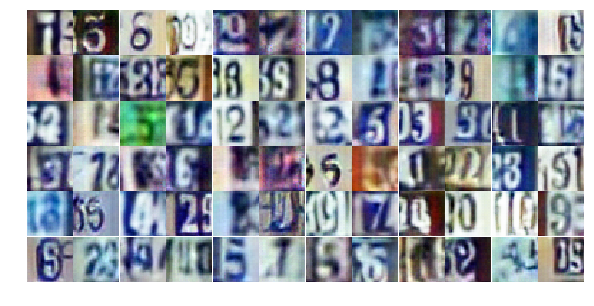

Epoch 25/25... Discriminator Loss: 0.3932... Generator Loss: 1.9445
Epoch 25/25... Discriminator Loss: 1.7103... Generator Loss: 0.2848


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))